In [1]:
import os
import numpy as np
import torch

from tqdm import trange
from tqdm.notebook import tqdm
from torchvision import transforms, models
from torchsummary import summary
from torch.utils.data import Dataset, DataLoader
from skimage import io, transform as trans
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
import copy
import itertools 
import matplotlib.pyplot as plt
import warnings

def init_seed(SEED = 228):
    np.random.seed(SEED)
    torch.manual_seed(SEED)
    torch.cuda.manual_seed(SEED)
    torch.backends.cudnn.deterministic = True

warnings.filterwarnings("ignore")
init_seed()

In [2]:
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
DEVICE

device(type='cuda')

In [3]:
ROOT = './data/horse2zebra'

In [4]:
data_sizes = dict(zip(sorted(os.listdir(ROOT)), (map(lambda mode: len(os.listdir(os.path.join(ROOT, mode))), sorted(os.listdir(ROOT))))))
data_sizes

{'testA': 120, 'testB': 140, 'trainA': 1067, 'trainB': 1334}

In [5]:
max(dict((key, data_sizes[key]) for key in (filter(lambda k: 'train' in k, data_sizes.keys()))), key=lambda k: data_sizes[k])

'trainB'

In [6]:
num_add_images_test = {max(dict((key, data_sizes[key]) for key in (filter(lambda k: 'test' in k, data_sizes.keys()))), key=lambda k: data_sizes[k]):abs(data_sizes['testA'] - data_sizes['testB'])}
num_add_images_train = {max(dict((key, data_sizes[key]) for key in (filter(lambda k: 'train' in k, data_sizes.keys()))), key=lambda k: data_sizes[k]):abs(data_sizes['trainA'] - data_sizes['trainB'])}
num_add_images_test, num_add_images_train

({'testB': 20}, {'trainB': 267})

In [7]:
class H2ZDataset(Dataset):
    """Nights & Days imgs dataset"""

    def __init__(self, root, mode, transform=None, add_imgs=None):
        """
        Args:
            root (string): Directory with all the images.
            mode (string): trainA, trainB, testA, testB.
            transform (callable, optional): Optional transform to be applied
                on a sample.
        """
        self.direct = os.path.join(root, mode)
        self.transform = transform
        names = os.listdir(root)
        if mode in names:
            self.data_path = sorted(os.listdir(self.direct))
            if add_imgs:
                idxs = np.random.randint(0, len(self.data_path), size=add_imgs)
                for idx in idxs:
                    self.data_path.append(self.data_path[idx])
        else:
            raise IOError(f'use the following modes: {names}')

    def __len__(self):
        return len(self.data_path)

    def __getitem__(self, idx):
        img = io.imread(os.path.join(self.direct, self.data_path[idx]))
        img = transforms.ToTensor()(img)
        img = self._toRGB(img)
        img = self.transform(img) if self.transform else img
        return img, self.data_path[idx]
    
    def _toRGB(self, img):
        ch = 1 if len(img.size()) == 4 else 0
        if img.size(ch) != 3:
            img = torch.repeat_interleave(img, torch.tensor([3]), dim=ch)
        return img
    
    @staticmethod
    def compute_normalization_parameters(root):
        """Compute Mean and Std of image for image scaling
        """
        for mode in ('trainA', 'trainB'):
            if 'A' in mode:
                if 'A' in list(num_add_images_train.keys())[0]:
                    datasetA = H2ZDataset(root, mode=mode)
                else:
                    datasetA = H2ZDataset(root, mode=mode, add_imgs=list(num_add_images_train.values())[0])

            if 'B' in mode:
                if 'B' in list(num_add_images_train.keys())[0] and 'B' in mode:
                    datasetB = H2ZDataset(root=ROOT, mode=mode)
                else:
                    datasetB = H2ZDataset(root=ROOT, mode=mode, add_imgs=list(num_add_images_train.values())[0])
            
        loaderA = DataLoader(datasetA, batch_size=1, num_workers=4, shuffle=True)
        loaderB = DataLoader(datasetB, batch_size=1, num_workers=4, shuffle=True)
        mean = 0.
        std = 0.
        for imagesA, imagesB in zip(loaderA, loaderB):
            imagesA, imagesB = imagesA[0].to(DEVICE), imagesB[0].to(DEVICE)
            batch_samplesA = imagesA.size(0) # batch size (the last batch can have smaller size!)
            batch_samplesB = imagesB.size(0) # batch size (the last batch can have smaller size!)
            images = torch.cat((imagesA.view(batch_samplesA, imagesA.size(1), -1), imagesB.view(batch_samplesB, imagesB.size(1), -1)))
            mean += images.mean(2).sum(0) # sum of means in channels
            std += images.std(2).sum(0) # sum of stds in channels

        mean /= (len(loaderA.dataset) + len(loaderB.dataset)) # mean of batchsum of means in channels
        std /= (len(loaderA.dataset) + len(loaderB.dataset)) # mean of batchsum of stds in channels
        """ Normalize the data as following:
        transformation = transforms.Compose([transforms.ToTensor(), transforms.Normalize({mean}, {std} )])
        this function return the object Normalize the new mean and std: transforms.Normalize({mean}, {std} )
        """
        return transforms.Normalize(mean.cpu().tolist(), std.cpu().tolist())

In [8]:
norm =  H2ZDataset.compute_normalization_parameters(ROOT) #transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])      #
norm

Normalize(mean=[0.504774272441864, 0.4929436445236206, 0.42757901549339294], std=[0.2181469053030014, 0.21589210629463196, 0.2202080488204956])

In [9]:
data_transforms = {
    "train": transforms.Compose([transforms.ToPILImage(),
                                 transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3),
                                 transforms.RandomSizedCrop(256),
                                 transforms.RandomRotation(5),
                                 transforms.RandomHorizontalFlip(),
                                 transforms.ToTensor(),
                                 transforms.Lambda(lambda img: img + torch.normal(mean=0, std=1e-7, size=img.size())),
                                 norm
                                 ]),
    "test": transforms.Compose([norm])
}

In [10]:
if 'A' in list(num_add_images_train.keys())[0]:
    h_trds = H2ZDataset(root=ROOT, mode='trainA', transform=data_transforms['train'])
else:
    h_trds = H2ZDataset(root=ROOT, mode='trainA', add_imgs=list(num_add_images_train.values())[0], transform=data_transforms['train'])

if 'B' in list(num_add_images_train.keys())[0]:
    z_trds = H2ZDataset(root=ROOT, mode='trainB', transform=data_transforms['train'])
else:
    z_trds = H2ZDataset(root=ROOT, mode='trainB', add_imgs=list(num_add_images_train.values())[0], transform=data_transforms['train'])

if 'A' in list(num_add_images_test.keys())[0]:
    h_tsds = H2ZDataset(root=ROOT, mode='testA', transform=data_transforms['test'])
else:
    h_tsds = H2ZDataset(root=ROOT, mode='testA', add_imgs=list(num_add_images_test.values())[0], transform=data_transforms['test'])

if 'B' in list(num_add_images_test.keys())[0]:
    z_tsds = H2ZDataset(root=ROOT, mode='testB', transform=data_transforms['test'])
else:
    z_tsds = H2ZDataset(root=ROOT, mode='testB', add_imgs=list(num_add_images_test.values())[0], transform=data_transforms['test'])


The amount of each dataset

In [11]:
tuple(map(len, [h_trds, z_trds, h_tsds, z_tsds]))

(1334, 1334, 140, 140)

In [12]:
h_trdl = DataLoader(h_trds, batch_size=1, num_workers=4, shuffle=True)
z_trdl = DataLoader(z_trds, batch_size=1, num_workers=4, shuffle=True)
h_tsdl = DataLoader(h_tsds, batch_size=1, num_workers=4, shuffle=True)
z_tsdl = DataLoader(z_tsds, batch_size=1, num_workers=4, shuffle=True)

In [13]:
ex = list(h_tsdl)

Generator

In [14]:
class Encoder(nn.Module):
    
    def __init__(self):
        super().__init__()
        self.conv_layer1 = nn.Sequential(nn.ReflectionPad2d(3),
                                         nn.Conv2d(3, 64, kernel_size=7, stride=1),  # 256 -> 256
                                         nn.InstanceNorm2d(64),
                                         nn.ReLU(inplace=True))
        
        self.conv_layer2 = nn.Sequential(nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),  # 256 -> 128
                                         nn.InstanceNorm2d(128),
                                         nn.ReLU(inplace=True))
                      
        self.conv_layer3 = nn.Sequential(nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),  # 128 -> 64
                                         nn.InstanceNorm2d(256),
                                         nn.ReLU(inplace=True))            

    def forward(self, inpt):
        pre1 = self.conv_layer1(inpt)
        pre2 = self.conv_layer2(pre1)
        res = self.conv_layer3(pre2)
        return res

class ResidualBlock(nn.Module):

    def __init__(self):
        super().__init__()
        self.conv_layer1 = nn.Sequential(nn.ReflectionPad2d(1),
                                         nn.Conv2d(256, 256, kernel_size=3, stride=1),  # 256 -> 256
                                         nn.InstanceNorm2d(256),
                                         nn.ReLU(inplace=True))
        
        self.conv_layer2 = nn.Sequential(nn.ReflectionPad2d(1),
                                         nn.Conv2d(256, 256, kernel_size=3, stride=1),  # 256 -> 256
                                         nn.InstanceNorm2d(256))           

    def forward(self, inpt):
        residual = inpt
        pre1 = self.conv_layer1(inpt)
        pre2 = self.conv_layer2(pre1)
        res = F.relu(pre2 + residual)
        return res

class Transformer(nn.Module):
    
    def __init__(self, num_blocks):
        super().__init__()
        self.res_blocks = nn.Sequential(*[ResidualBlock() for block in range(num_blocks)])

    def forward(self, inpt):
        return self.res_blocks(inpt)

class Decoder(nn.Module):
    
    def __init__(self):
        super().__init__()
        self.trans_conv_layer1 = nn.Sequential(nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),  # 64 -> 128
                                               nn.InstanceNorm2d(128),
                                               nn.ReLU(inplace=True))
        
        self.trans_conv_layer2 = nn.Sequential(nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),   # 128 -> 256
                                               nn.InstanceNorm2d(64),
                                               nn.ReLU(inplace=True))
                      
        self.conv_layer3 = nn.Sequential(nn.ReflectionPad2d(3),
                                         nn.Conv2d(64, 3, kernel_size=7, stride=1),      # 256 -> 256
                                         nn.Tanh())

    def forward(self, inpt):
        pre1 = self.trans_conv_layer1(inpt)
        pre2 = self.trans_conv_layer2(pre1)
        res = self.conv_layer3(pre2)
        return res

class Generator(nn.Module):
    
    def __init__(self):
        super().__init__()

        self.encoder = Encoder()
        self.transformer = Transformer(num_blocks=9)
        self.decoder = Decoder()

    def forward(self, inpt):
        pre1 = self.encoder(inpt)
        pre2 = self.transformer(pre1)
        res = self.decoder(pre2)
        return res

Discriminator is 70x70 PatchGAN

In [15]:
class Discriminator(nn.Module):
    
    def __init__(self):
        super().__init__()
        in_ch, self.conv_layers = self._create_layers()
        self.end_layer = nn.Sequential(nn.Conv2d(in_ch, 1, kernel_size=4, stride=1, padding=1),
                                       nn.Sigmoid())

    def forward(self, inpt):
        pre = self.conv_layers(inpt)
        res = self.end_layer(pre)
        return res.squeeze()

    def _create_layers(self):
        conv_layers = list()
        in_ch = 3
        for out_ch in (64, 128, 256, 512):
            if out_ch == 64:
                conv = nn.Conv2d(in_ch, out_ch, kernel_size=4, stride=2, padding=1)
            elif out_ch == 512:
                conv = nn.Conv2d(in_ch, out_ch, kernel_size=4, stride=1, padding=1, bias=False)
            else:
                conv = nn.Conv2d(in_ch, out_ch, kernel_size=4, stride=2, padding=1, bias=False)
            conv_layers += [conv, 
                            nn.InstanceNorm2d(out_ch), 
                            nn.LeakyReLU(negative_slope=1e-2, inplace=True)]
            in_ch = out_ch
        return out_ch, nn.Sequential(*conv_layers)

In [16]:
class GANLoss(nn.Module):
    
    def __init__(self, train_disc=True):
        super().__init__()
        self.train_disc = train_disc
    
    def forward(self, disc, *inpt): 
        if self.train_disc:
            # real = inpt[0], fake = inpt[1]
            loss = torch.mean((disc(inpt[0]) - 1.) ** 2) + torch.mean(disc(inpt[1]) ** 2)
        else:
            # fake = inpt[0]
            loss = torch.mean((disc(inpt[0]) - 1.) ** 2)
        return loss

In [17]:
class CycleLoss(nn.Module):

    def __init__(self):
        super().__init__()
        self.cycloss_A = None
        self.cycloss_B = None
        self.l1loss = nn.L1Loss()

    def get_cycloss_A(self):
        return self.cycloss_A

    def get_cycloss_B(self):
        return self.cycloss_B

    def forward(self, recA, recB, realA, realB):
        self.cycloss_A = self.l1loss(recA, realA)  # recA = genA(genB(A)), L1 = || recA - realA ||1
        self.cycloss_B = self.l1loss(recB, realB) # recB = genB(genA(B)), L1 = || recB - realB ||1 
        return self.cycloss_A + self.cycloss_B

In [18]:
class Fulloss(nn.Module):
    
    def __init__(self, lmbd):
        super().__init__()
        self.lmbd = lmbd

    def forward(self, ganloss, cycleloss):
        full_loss = ganloss + self.lmbd * cycleloss
        return full_loss

In [19]:
class GenImgsPool:

    def __init__(self):
        self.query = torch.tensor(list()).to(DEVICE)
    
    def get_tensor(self):
        return self.query

    def add_imgs(self, imgs):
        if len(self.query) < 50:
            self.query = torch.cat((self.query, imgs), 0)
        else:
            self.query = self.query[1:].clone()
            self.query = torch.cat((self.query, imgs), 0)

In [20]:
class CycleGAN:

    def __init__(self, test=False, norm=norm):
        self.test = test
        self.gen_A = Generator().to(DEVICE)
        self.gen_B = Generator().to(DEVICE)
        self.disc_A = Discriminator().to(DEVICE)
        self.disc_B = Discriminator().to(DEVICE)
        self.ganloss_gen_fn = GANLoss(train_disc=False)
        self.ganloss_disc_fn = GANLoss(train_disc=True)
        self.cycloss_fn = CycleLoss()
        self.full_loss_fn = Fulloss(lmbd=10)
        self.fake_pool_A = GenImgsPool()
        self.fake_pool_B = GenImgsPool() 
        self.mean, self.std = norm.mean, norm.std 
        
        self.loss_names = tuple(('ganloss_gen_A', 'ganloss_gen_B', 'ganloss_gen_all', 'cycloss_gen_A',
                                'cycloss_gen_B', 'cycloss_gen_all', 'full_gen_loss', 
                                'ganloss_discr_A', 'ganloss_discr_B', 
                                'ganloss_discr_all'))                                                                      

        self.losses = {key:None for key in self.loss_names}

        self.paths_for_weights = [f'./weights/{name}' for name in ['gen_A', 'gen_B', 'disc_A', 'disc_B']]

    def fit(self, dataloader_A, dataloader_B, lr=2e-4, epochs=200, steps_todecay=[step for step in range(100, 200, 10)], step_plot=1):
        self.history = {key:[0. for epoch in range(epochs)] for key in self.loss_names}

        self.opt_gen = optim.Adam(itertools.chain(self.gen_A.parameters(), self.gen_B.parameters()),
                                  lr=lr)
        self.opt_disc = optim.Adam(itertools.chain(self.disc_A.parameters(), self.disc_B.parameters()),
                                   lr=lr)
        
        self.sch_gen = optim.lr_scheduler.MultiStepLR(self.opt_gen, 
                                                      milestones=steps_todecay, 
                                                      gamma=0.5)
        self.sch_disc = optim.lr_scheduler.MultiStepLR(self.opt_disc, 
                                                       milestones=steps_todecay, 
                                                       gamma=0.5)
        
        
        for epoch in trange(epochs, desc='Epoch'):
            self._fit_epoch(epoch, dataloader_A, dataloader_B)

            self.sch_gen.step()
            self.sch_disc.step()

            log_template = ''
            if (epoch+1) % step_plot == 0:
                log_template += f"\n\nGenerator metrics:"
                for num, name in enumerate(self.loss_names):
                    if num == 7: log_template += "\n\nDiscriminator metrics: "
                    log_template += f"\n{name}: {self.history[name][epoch]:0.10f}"
                log_template += f"\n\nlr: {self.get_lr(self.opt_gen)}"
                tqdm.write(log_template)
                if not ((epoch+1) < 3): self.stat_plot(slce=epoch)
                self.show_imgs()

            self.save_weights()

            



    def _fit_epoch(self, epoch, dataloader_A, dataloader_B):
        size_data = len(dataloader_A.dataset)

        outer = tqdm(total=size_data, desc='Fit_epoch')
        
        self.gen_B.train()
        self.gen_A.train()
        for num, (realA, realB) in enumerate(zip(dataloader_A, dataloader_B)):

            # self._check_requires_grad(self.gen_A, self.gen_B, self.disc_A, self.disc_B, 
            #                          names=['gen_A', 'gen_B', 'disc_A', 'disc_B'])
                      
            self._set_requires_grad(self.disc_A, self.disc_B, trainable=False)
            self.pathA, self.pathB = realA[1], realB[1]
                
            self.realA, self.realB = realA[0].to(DEVICE), realB[0].to(DEVICE)
            self.fakeA = self.gen_B(self.realB)                                 # gen_B: B -> A
            self.fakeB = self.gen_A(self.realA)                                 # gen_A: A -> B
            self.recA = self.gen_B(self.fakeB)                                  # gen_B(gen_A(A)) ~ A 
            self.recB = self.gen_A(self.fakeA)                                  # gen_A(gen_B(B)) ~ B
            
            # Optim Gen_A, Gen_B
            self.opt_gen.zero_grad()
            self._calculate_backward_for_gens()
            self.opt_gen.step()
            # print('Optim Gen_A, Gen_B is completed!')
            # self._check_requires_grad(self.gen_A, self.gen_B, self.disc_A, self.disc_B, 
            #                          names=['gen_A', 'gen_B', 'disc_A', 'disc_B'])            

            
            self._set_requires_grad(self.disc_A, self.disc_B, trainable=True)

            # self._check_requires_grad(self.gen_A, self.gen_B, self.disc_A, self.disc_B, 
            #                          names=['gen_A', 'gen_B', 'disc_A', 'disc_B'])

            # Optim Disc_A, Disc_B
            self.opt_disc.zero_grad()
            # used detach, for disabled Generator's req_grad 
            self._calculate_backward_for_discrs()  
            self.opt_disc.step()
            # print('Optim Disc_A, Disc_B is completed!')

            
            for name in self.loss_names:
                self.history[name][epoch] += self.losses[name].item() / size_data * dataloader_A.batch_size
            
            outer.update(1) 

    def stat_plot(self, slce, names=None): 
        if names is None:
            names = self.loss_names

        plt.figure(figsize=(16, 10))
        for name in names[:3]:
            plt.subplot(2, 2, 1)  
            plt.plot(self.history[name][:slce+1], label=name)
            plt.legend(loc='best')
            plt.xlabel("epochs")
            plt.ylabel('ganloss_gen')
        for name in names[3:6]:
            plt.subplot(2, 2, 2)  
            plt.plot(self.history[name][:slce+1], label=name)
            plt.legend(loc='best')
            plt.xlabel("epochs")
            plt.ylabel('cycloss_gen')
        plt.subplot(2, 2, 3)  
        plt.plot(self.history[names[6]][:slce+1], label=names[6])
        plt.legend(loc='best')
        plt.xlabel("epochs")
        plt.ylabel('full_gen_loss')
        for name in names[7:]:
            plt.subplot(2, 2, 4)  
            plt.plot(self.history[name][:slce+1], label=name)
            plt.legend(loc='best')
            plt.xlabel("epochs")
            plt.ylabel('ganloss_discr')  
        plt.show()

    def show_imgs(self):
        imgs = (self.realA, 
                self.fakeA, 
                self.recA, 
                self.realB,
                self.fakeB,
                self.recB)
        
        plt.figure(figsize=(10, 6))
        for num, (name, img) in enumerate(zip(('real ', 'fake ', 'rec ', 'real ', 'fake ', 'rec '), 
                                              (img.clone().detach().cpu().numpy() for img in imgs))):
            mode = 'A' if (num+1) < 4 else 'B'
            name += mode 
            plt.subplot(2, 3, num+1)
            if 'real' in name:
                plt.imshow((img[0].transpose(1, 2, 0)) * self.std + self.mean)
            else:
                plt.imshow(((img[0].transpose(1, 2, 0)) * 127.5 + 127.5).astype(np.uint64))
            plt.title(name)
            plt.axis('off')
        plt.show()

    def _calculate_backward_for_discrs(self):
        self.fake_pool_A.add_imgs(self.fakeA.clone().detach())  # detached from the current req_grad graph 
        self.fake_pool_B.add_imgs(self.fakeB.clone().detach())  # detached from the current req_grad graph 
        self.losses['ganloss_discr_A'] = self.ganloss_disc_fn(self.disc_A, self.realA, self.fake_pool_A.get_tensor())
        self.losses['ganloss_discr_B'] = self.ganloss_disc_fn(self.disc_B, self.realB, self.fake_pool_B.get_tensor())
        self.losses['ganloss_discr_all'] = (self.losses['ganloss_discr_A'] +\
                                            self.losses['ganloss_discr_B'])
        if not self.test:
            self.losses['ganloss_discr_A'].backward()
            self.losses['ganloss_discr_B'].backward()          


    def _calculate_backward_for_gens(self):
        self.losses['ganloss_gen_A'] = self.ganloss_gen_fn(self.disc_A, self.fakeA)
        self.losses['ganloss_gen_B'] = self.ganloss_gen_fn(self.disc_B, self.fakeB)
        self.losses['ganloss_gen_all'] = self.losses['ganloss_gen_A'] +\
                                         self.losses['ganloss_gen_B'] 
        self.losses['cycloss_gen_all'] = self.cycloss_fn(self.recA, self.recB, self.realA, self.realB)
        self.losses['cycloss_gen_A'] = self.cycloss_fn.get_cycloss_A()
        self.losses['cycloss_gen_B'] = self.cycloss_fn.get_cycloss_B()
        self.losses['full_gen_loss'] = self.full_loss_fn(self.losses['ganloss_gen_all'], 
                                                     self.losses['cycloss_gen_all'])
        if not self.test:
            self.losses['full_gen_loss'].backward()

    def _set_requires_grad(self, *nets, trainable=False):
        for net in nets:
            for param in net.parameters():
                param.requires_grad = trainable

    def _check_requires_grad(self, *nets, names):
        first = True
        for net, name in zip(nets, names):
            trainable = False
            for param in net.parameters():
                if param.requires_grad:
                   trainable = True
            if first:
                print(f'\n{name} is trainable = {trainable}')
                first = False
            else:
                print(f'{name} is trainable = {trainable}')

    def get_lr(self, optimizer):
        """ get learning rate """
        for param_group in optimizer.param_groups:
            return param_group['lr']
    
    def save_weights(self, nets=None, names=['gen_A', 'gen_B', 'disc_A', 'disc_B']):
        if nets is None:
            nets = [self.gen_A, self.gen_B, self.disc_A, self.disc_B]
        for net, name in zip(nets, names):
            net_weights = copy.deepcopy(net.state_dict())
            torch.save(net_weights, name)
            !mv './{name}' './weights/'
            
    def load_weights(self, nets=None, paths=None):
        if nets is None:
            nets = [self.gen_A, self.gen_B, self.disc_A, self.disc_B]
        if paths is None:
            paths = self.paths_for_weights
        for net, path in zip(nets, paths):
            net.load_state_dict(torch.load(path))

    def summ(self):
        print('\t\t\t\tGenerator')
        summary(Generator().to(DEVICE), input_size=(3, 256, 256))
        print('\t\t\t\tDiscriminator')
        summary(Discriminator().to(DEVICE), input_size=(3, 256, 256))
    
    def eval_on_loader(self, dataloader_A, dataloader_B, test=True, create_new_history=True):
        self.test = test
        self.fake_pool_A = GenImgsPool()
        self.fake_pool_B = GenImgsPool()
        if create_new_history:
            self.history = {key:0. for key in self.loss_names}
        size_data = len(dataloader_A.dataset)

        outer = tqdm(total=size_data, desc='Eval')
        self.gen_B.eval()
        self.gen_A.eval()
        for realA, realB in zip(dataloader_A, dataloader_B):
            self.pathA, self.pathB = realA[1], realB[1]

            if realA[0].size()[1] != 3:
                realA[0] = torch.repeat_interleave(realA[0], 
                                                  torch.tensor([3]), 
                                                  dim=1)
            if realB[0].size()[1] != 3:
                realB[0] = torch.repeat_interleave(realB[0], 
                                                  torch.tensor([3]), 
                                                  dim=1)
                
            self.realA, self.realB = realA[0].to(DEVICE), realB[0].to(DEVICE)

            with torch.no_grad():
                self.fakeA = self.gen_B(self.realB)                     # gen_B: B -> A
                self.fakeB = self.gen_A(self.realA)                    # gen_A: A -> B
                self.recA = self.gen_B(self.fakeB)                      # gen_B(gen_A(A)) ~ A 
                self.recB = self.gen_A(self.fakeA)                      # gen_A(gen_B(B)) ~ B
                self._calculate_backward_for_gens()
                self._calculate_backward_for_discrs()  
            
            for name in self.loss_names:
                self.history[name] += self.losses[name].item() / size_data * dataloader_A.batch_size

            outer.update(1) 

        log_template = f"\n\nEval \nGenerator metrics:"
        for name in self.loss_names[:7]:
            log_template += f"\n{name}: {self.history[name]:0.10f}"
        log_template += "\n\nDiscriminator metrics: "
        for name in self.loss_names[7:]:
            log_template += f"\n{name}: {self.history[name]:0.10f}"
            
        tqdm.write(log_template)
        self.show_imgs()
        
        

    def generate_imgs(self, imgs_paths, A2B=True, transform=None):
          self.gen_B.eval()
          self.gen_A.eval()
          flag = True
          for path in imgs_paths:
              img = io.imread(path)
              img = trans.resize(img, (256, 256), anti_aliasing=True)
              img = transform(img) if transform else transforms.ToTensor()(img)
              if img.size()[0] != 3:
                  img = torch.repeat_interleave(img,
                                                torch.tensor([3]),
                                                dim=0)
              if flag:
                  imgs = img[None, :, :, :]
                  flag = False

              imgs = torch.cat((imgs, img[None, :, :, :]))
          
          imgs = imgs.to(DEVICE)
          with torch.no_grad():
              if A2B:
                  fakes = self.gen_A(imgs.float())
              else:
                  fakes = self.gen_B(imgs.float())
          return (fakes.clone().detach().cpu().numpy().transpose(0, 2, 3, 1) * 127.5 + 127.5).astype(np.uint64)

In [21]:
gan = CycleGAN()
gan.summ()

				Generator
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ReflectionPad2d-1          [-1, 3, 262, 262]               0
            Conv2d-2         [-1, 64, 256, 256]           9,472
    InstanceNorm2d-3         [-1, 64, 256, 256]               0
              ReLU-4         [-1, 64, 256, 256]               0
            Conv2d-5        [-1, 128, 128, 128]          73,856
    InstanceNorm2d-6        [-1, 128, 128, 128]               0
              ReLU-7        [-1, 128, 128, 128]               0
            Conv2d-8          [-1, 256, 64, 64]         295,168
    InstanceNorm2d-9          [-1, 256, 64, 64]               0
             ReLU-10          [-1, 256, 64, 64]               0
          Encoder-11          [-1, 256, 64, 64]               0
  ReflectionPad2d-12          [-1, 256, 66, 66]               0
           Conv2d-13          [-1, 256, 64, 64]         590,080
   InstanceNorm2d-14     

In [22]:
!nvidia-smi

Mon Jun 15 23:50:14 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.64       Driver Version: 440.64       CUDA Version: 10.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  GeForce GTX 850M    Off  | 00000000:01:00.0 Off |                  N/A |
| N/A   54C    P0    N/A /  N/A |   1909MiB /  2004MiB |      2%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

Stage 1

Epoch:   0%|          | 0/200 [00:00<?, ?it/s]

Epoch:   0%|          | 0/200 [18:05<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Generator metrics:
ganloss_gen_A: 0.3017956703
ganloss_gen_B: 0.3227850807
ganloss_gen_all: 0.6245807520
cycloss_gen_A: 0.7043527095
cycloss_gen_B: 0.7210107775
cycloss_gen_all: 1.4253634908
full_gen_loss: 14.8782156772

Discriminator metrics: 
ganloss_discr_A: 0.1045518724
ganloss_discr_B: 0.0933952646
ganloss_discr_all: 0.1979471368

lr: 0.0002


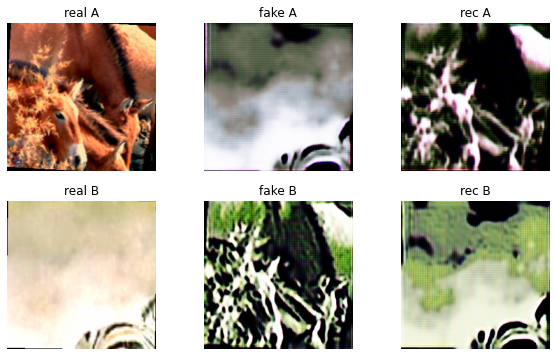

Epoch:   0%|          | 1/200 [18:14<60:28:51, 1094.13s/it]

Epoch:   0%|          | 1/200 [36:27<60:28:51, 1094.13s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Generator metrics:
ganloss_gen_A: 0.3931008887
ganloss_gen_B: 0.3851446277
ganloss_gen_all: 0.7782455151
cycloss_gen_A: 0.6364724122
cycloss_gen_B: 0.6622857707
cycloss_gen_all: 1.2987581852
full_gen_loss: 13.7658273652

Discriminator metrics: 
ganloss_discr_A: 0.1042821502
ganloss_discr_B: 0.0834571524
ganloss_discr_all: 0.1877393029

lr: 0.0002


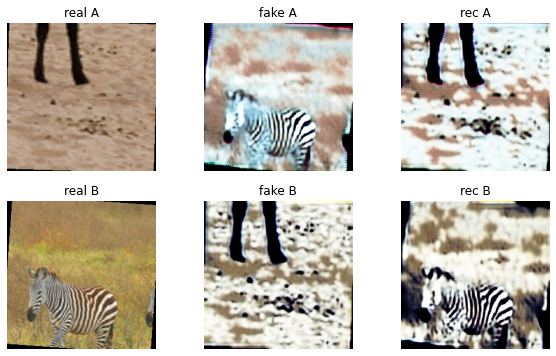

Epoch:   1%|          | 2/200 [36:35<60:18:12, 1096.43s/it]

Epoch:   1%|          | 2/200 [54:49<60:18:12, 1096.43s/it]



Generator metrics:
ganloss_gen_A: 0.3975225078
ganloss_gen_B: 0.4462910122
ganloss_gen_all: 0.8438135204
cycloss_gen_A: 0.6272071880
cycloss_gen_B: 0.6365500402
cycloss_gen_all: 1.2637572289
full_gen_loss: 13.4813857879

Discriminator metrics: 
ganloss_discr_A: 0.1062826182
ganloss_discr_B: 0.0787983011
ganloss_discr_all: 0.1850809196

lr: 0.0002


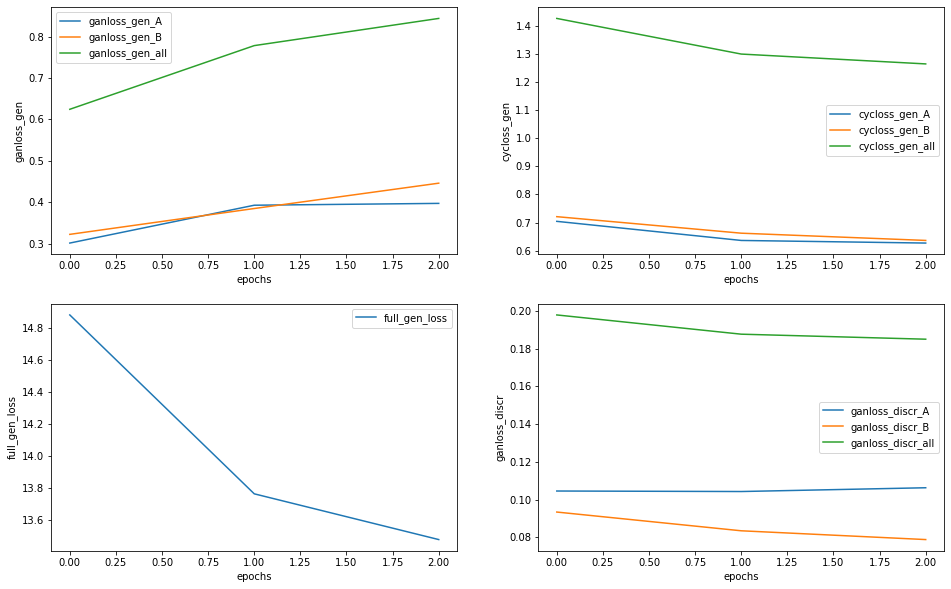

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


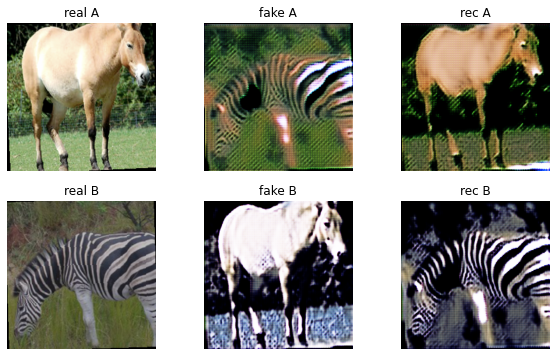

Epoch:   2%|▏         | 3/200 [54:59<60:06:32, 1098.44s/it]

Epoch:   2%|▏         | 3/200 [1:13:12<60:06:32, 1098.44s/it]



Generator metrics:
ganloss_gen_A: 0.4283434368
ganloss_gen_B: 0.4421154134
ganloss_gen_all: 0.8704588501
cycloss_gen_A: 0.6259365905
cycloss_gen_B: 0.6369668542
cycloss_gen_all: 1.2629034483
full_gen_loss: 13.4994933516

Discriminator metrics: 
ganloss_discr_A: 0.1006766594
ganloss_discr_B: 0.0896212502
ganloss_discr_all: 0.1902979097

lr: 0.0002


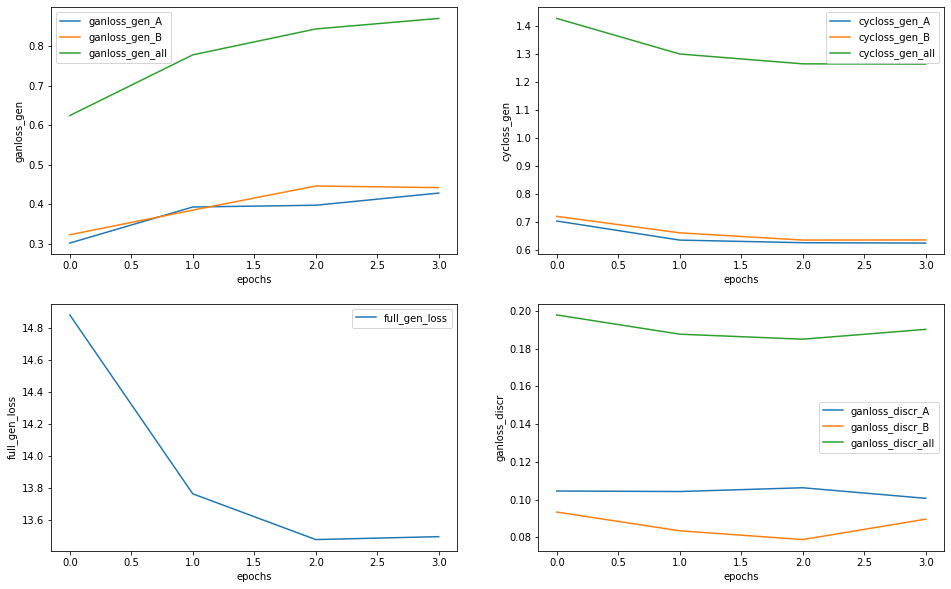

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


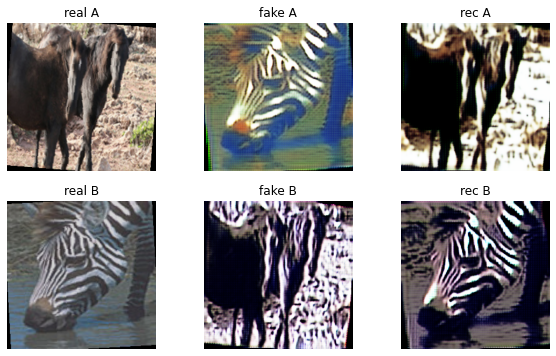

Epoch:   2%|▏         | 4/200 [1:13:21<59:52:20, 1099.70s/it]

Epoch:   2%|▏         | 4/200 [1:31:36<59:52:20, 1099.70s/it]



Generator metrics:
ganloss_gen_A: 0.4442049770
ganloss_gen_B: 0.4206299829
ganloss_gen_all: 0.8648349594
cycloss_gen_A: 0.6181580897
cycloss_gen_B: 0.6199244989
cycloss_gen_all: 1.2380825908
full_gen_loss: 13.2456608909

Discriminator metrics: 
ganloss_discr_A: 0.0950203127
ganloss_discr_B: 0.0868539681
ganloss_discr_all: 0.1818742808

lr: 0.0002


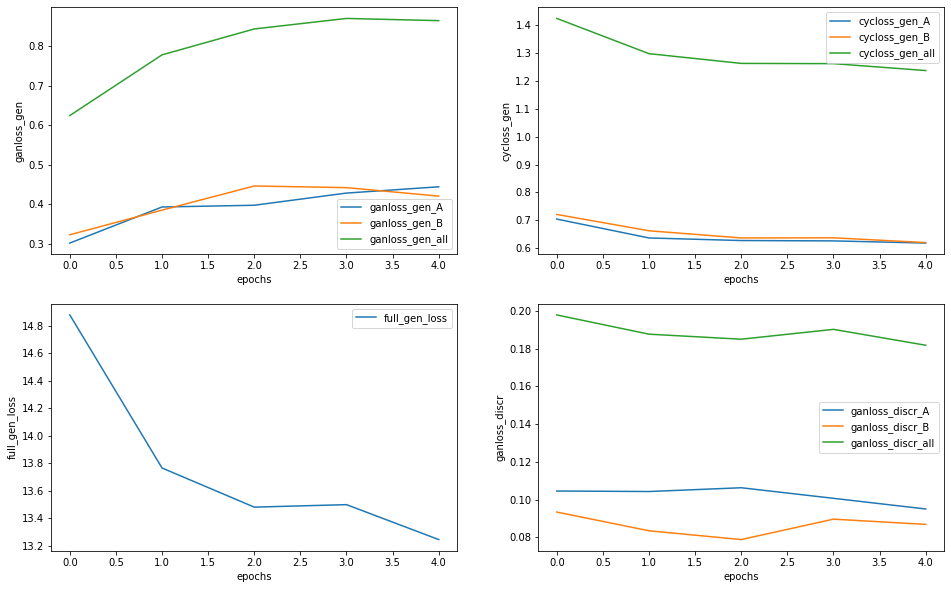

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


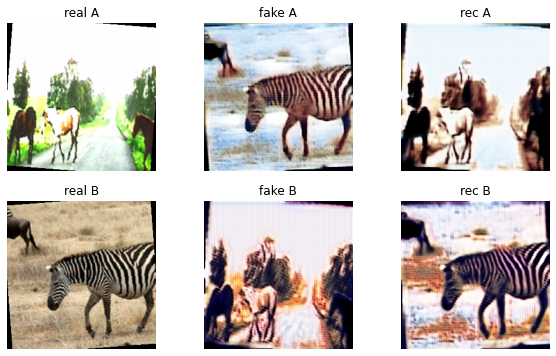

Epoch:   2%|▎         | 5/200 [1:31:45<59:38:16, 1101.01s/it]

Epoch:   2%|▎         | 5/200 [1:50:00<59:38:16, 1101.01s/it]



Generator metrics:
ganloss_gen_A: 0.4758238857
ganloss_gen_B: 0.4770933144
ganloss_gen_all: 0.9529171995
cycloss_gen_A: 0.6029195291
cycloss_gen_B: 0.6060594238
cycloss_gen_all: 1.2089789565
full_gen_loss: 13.0427067469

Discriminator metrics: 
ganloss_discr_A: 0.0905002457
ganloss_discr_B: 0.0763498291
ganloss_discr_all: 0.1668500747

lr: 0.0002


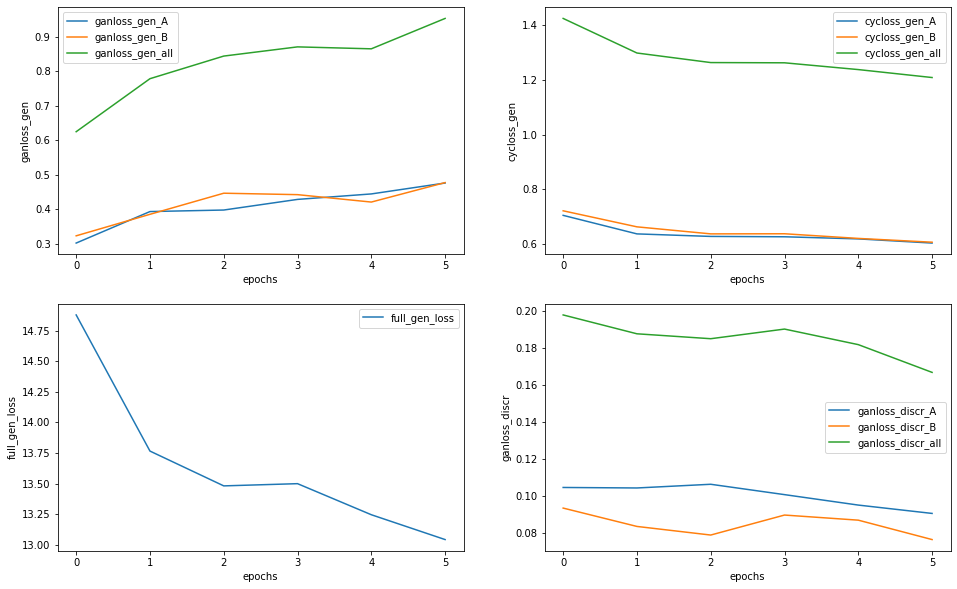

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


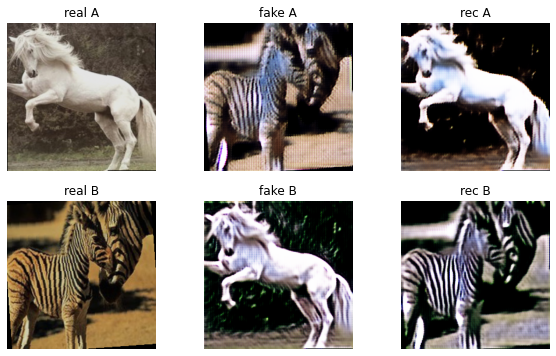

Epoch:   3%|▎         | 6/200 [1:50:09<59:22:37, 1101.84s/it]

Epoch:   3%|▎         | 6/200 [2:08:24<59:22:37, 1101.84s/it]



Generator metrics:
ganloss_gen_A: 0.5207192516
ganloss_gen_B: 0.4319913673
ganloss_gen_all: 0.9527106183
cycloss_gen_A: 0.5907548248
cycloss_gen_B: 0.5901676162
cycloss_gen_all: 1.1809224422
full_gen_loss: 12.7619350217

Discriminator metrics: 
ganloss_discr_A: 0.0899998965
ganloss_discr_B: 0.0921914118
ganloss_discr_all: 0.1821913082

lr: 0.0002


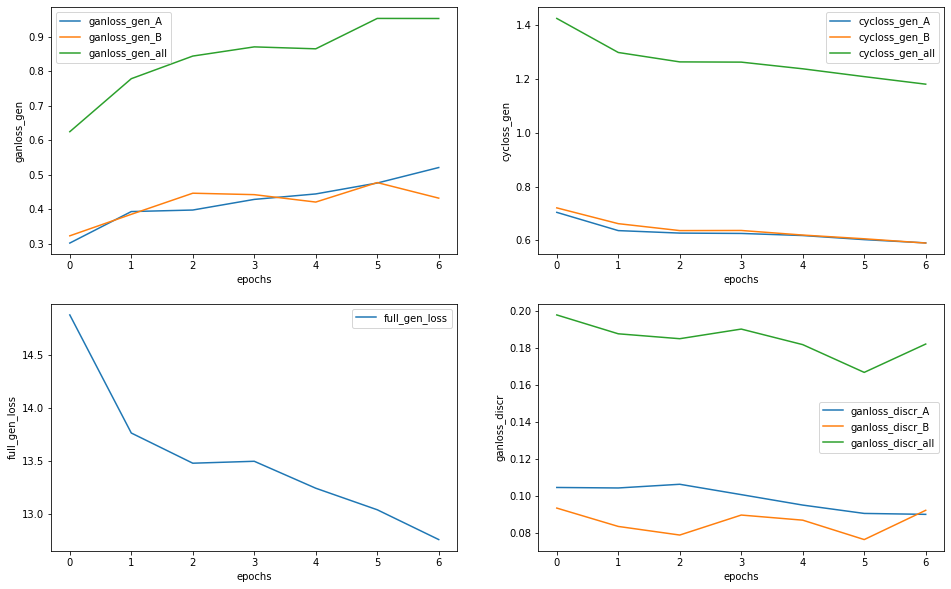

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


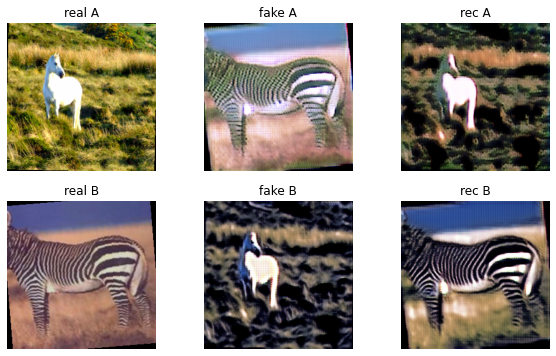

Epoch:   4%|▎         | 7/200 [2:08:35<59:08:13, 1103.07s/it]

Epoch:   4%|▎         | 7/200 [2:26:50<59:08:13, 1103.07s/it]



Generator metrics:
ganloss_gen_A: 0.4859266475
ganloss_gen_B: 0.4830282430
ganloss_gen_all: 0.9689548899
cycloss_gen_A: 0.5933978808
cycloss_gen_B: 0.5840769696
cycloss_gen_all: 1.1774748532
full_gen_loss: 12.7437034250

Discriminator metrics: 
ganloss_discr_A: 0.0940830184
ganloss_discr_B: 0.0798485504
ganloss_discr_all: 0.1739315688

lr: 0.0002


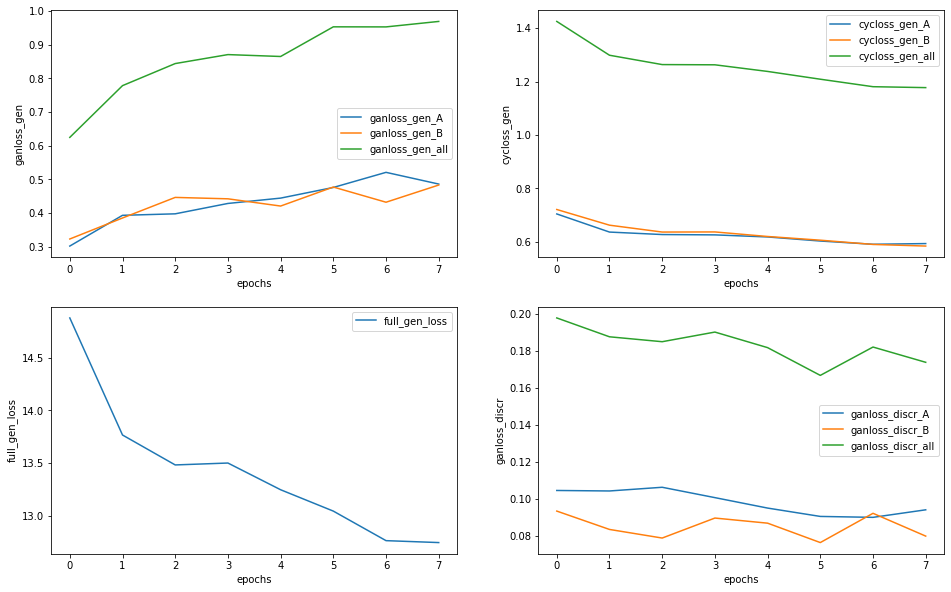

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


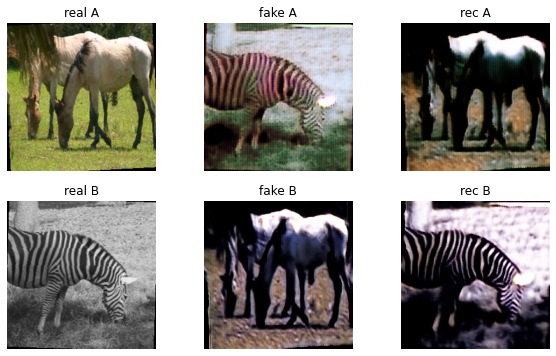

Epoch:   4%|▍         | 8/200 [2:26:58<58:50:12, 1103.19s/it]

Epoch:   4%|▍         | 8/200 [2:45:13<58:50:12, 1103.19s/it]



Generator metrics:
ganloss_gen_A: 0.5089075714
ganloss_gen_B: 0.4949119312
ganloss_gen_all: 1.0038195024
cycloss_gen_A: 0.5862598074
cycloss_gen_B: 0.5851174107
cycloss_gen_all: 1.1713772195
full_gen_loss: 12.7175916807

Discriminator metrics: 
ganloss_discr_A: 0.0831053245
ganloss_discr_B: 0.0900129536
ganloss_discr_all: 0.1731182783

lr: 0.0002


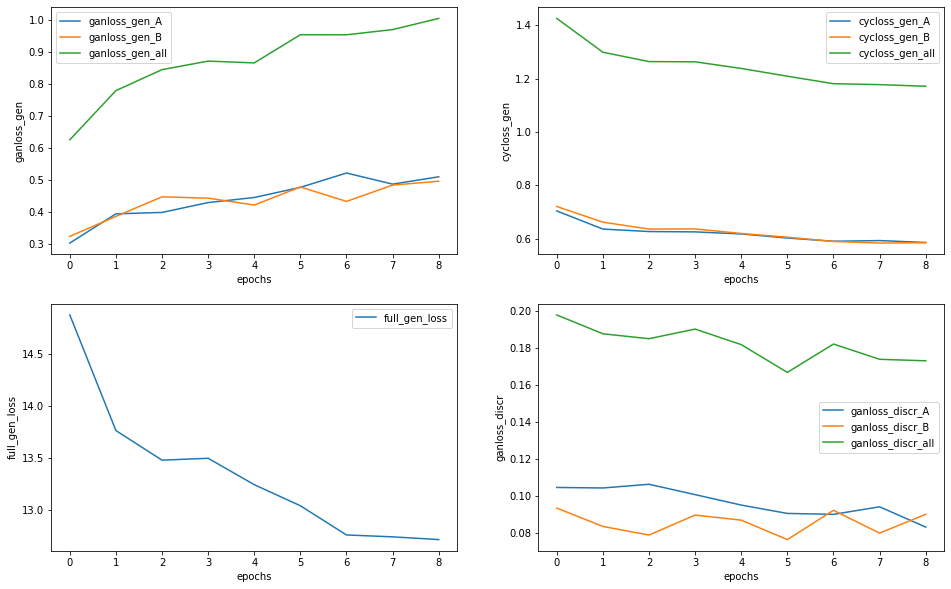

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


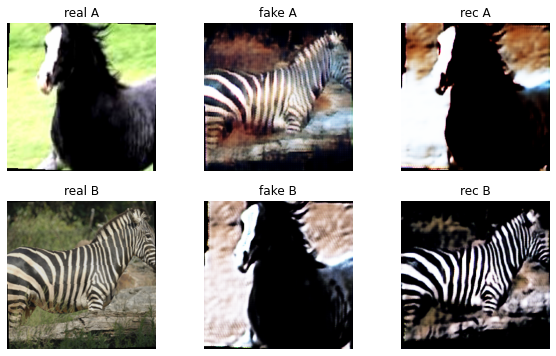

Epoch:   4%|▍         | 9/200 [2:45:23<58:32:59, 1103.56s/it]

Epoch:   4%|▍         | 9/200 [3:03:38<58:32:59, 1103.56s/it]



Generator metrics:
ganloss_gen_A: 0.5475584270
ganloss_gen_B: 0.5133212508
ganloss_gen_all: 1.0608796787
cycloss_gen_A: 0.5867880574
cycloss_gen_B: 0.5836871260
cycloss_gen_all: 1.1704751853
full_gen_loss: 12.7656315252

Discriminator metrics: 
ganloss_discr_A: 0.0793170177
ganloss_discr_B: 0.0729423623
ganloss_discr_all: 0.1522593800

lr: 0.0002


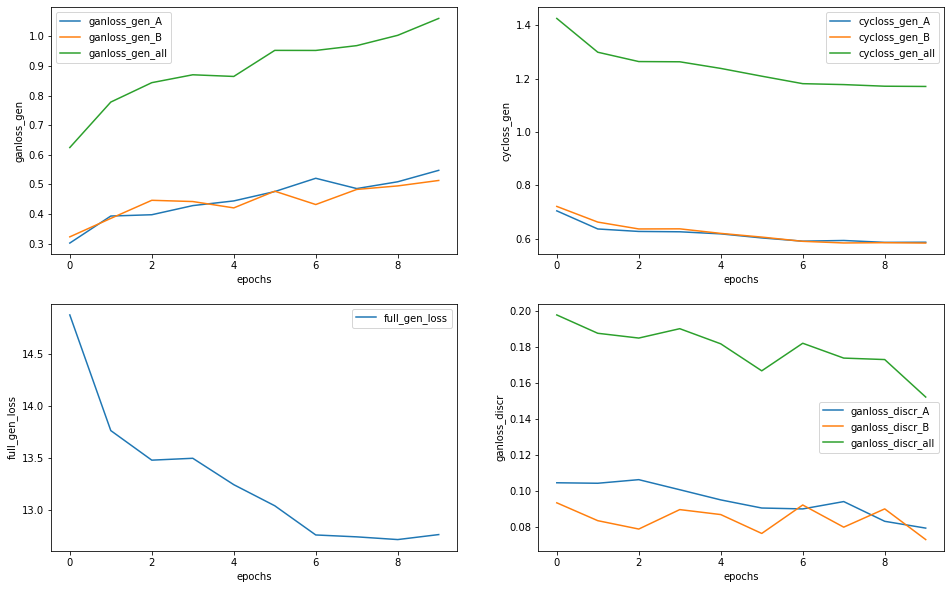

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


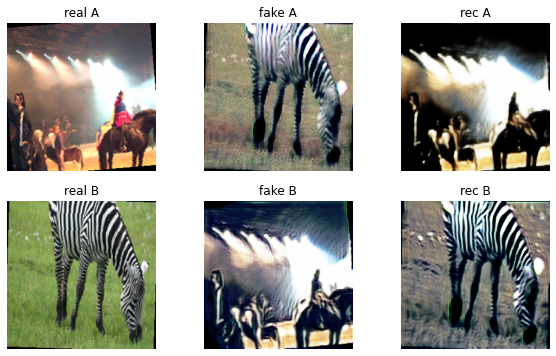

Epoch:   5%|▌         | 10/200 [3:03:47<58:14:55, 1103.66s/it]

Epoch:   5%|▌         | 10/200 [3:22:01<58:14:55, 1103.66s/it]



Generator metrics:
ganloss_gen_A: 0.5053287003
ganloss_gen_B: 0.5593155499
ganloss_gen_all: 1.0646442485
cycloss_gen_A: 0.5719580755
cycloss_gen_B: 0.5734101396
cycloss_gen_all: 1.1453682173
full_gen_loss: 12.5183264223

Discriminator metrics: 
ganloss_discr_A: 0.0948071003
ganloss_discr_B: 0.0723134964
ganloss_discr_all: 0.1671205968

lr: 0.0002


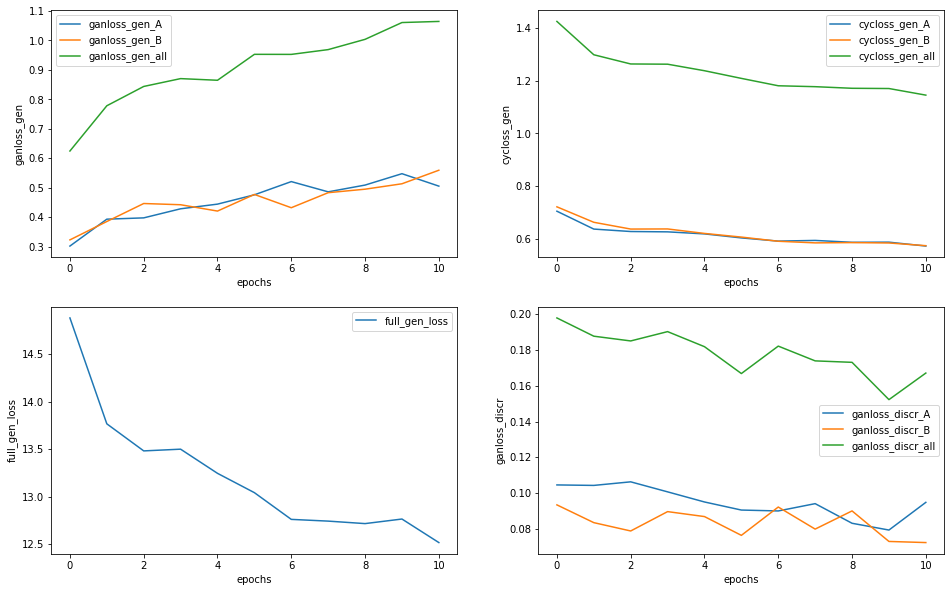

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


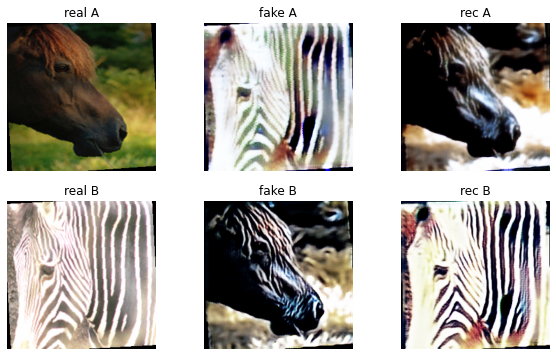

Epoch:   6%|▌         | 11/200 [3:22:10<57:56:27, 1103.64s/it]

Epoch:   6%|▌         | 11/200 [3:40:25<57:56:27, 1103.64s/it]



Generator metrics:
ganloss_gen_A: 0.5589230095
ganloss_gen_B: 0.5760630673
ganloss_gen_all: 1.1349860762
cycloss_gen_A: 0.5797269231
cycloss_gen_B: 0.5736826348
cycloss_gen_all: 1.1534095615
full_gen_loss: 12.6690816879

Discriminator metrics: 
ganloss_discr_A: 0.0879466882
ganloss_discr_B: 0.0759921489
ganloss_discr_all: 0.1639388370

lr: 0.0002


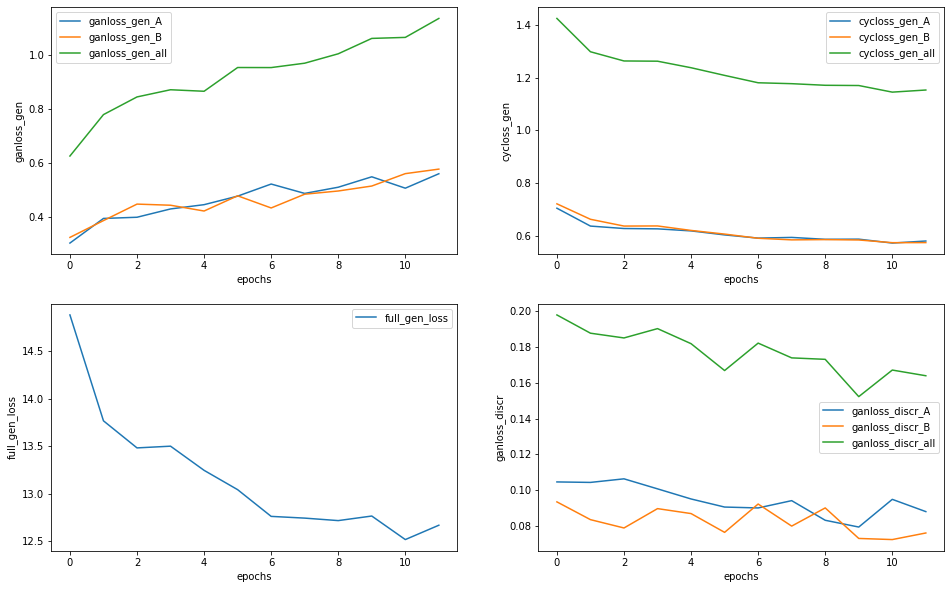

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


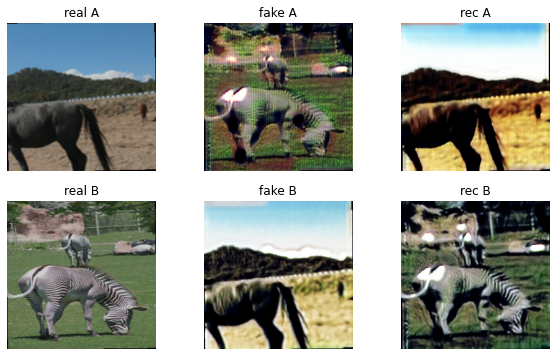

Epoch:   6%|▌         | 12/200 [3:40:35<57:38:47, 1103.87s/it]

Epoch:   6%|▌         | 12/200 [3:58:50<57:38:47, 1103.87s/it]



Generator metrics:
ganloss_gen_A: 0.5302325878
ganloss_gen_B: 0.5704677643
ganloss_gen_all: 1.1007003518
cycloss_gen_A: 0.5695845992
cycloss_gen_B: 0.5641047266
cycloss_gen_all: 1.1336893287
full_gen_loss: 12.4375936395

Discriminator metrics: 
ganloss_discr_A: 0.0945272655
ganloss_discr_B: 0.0728187118
ganloss_discr_all: 0.1673459773

lr: 0.0002


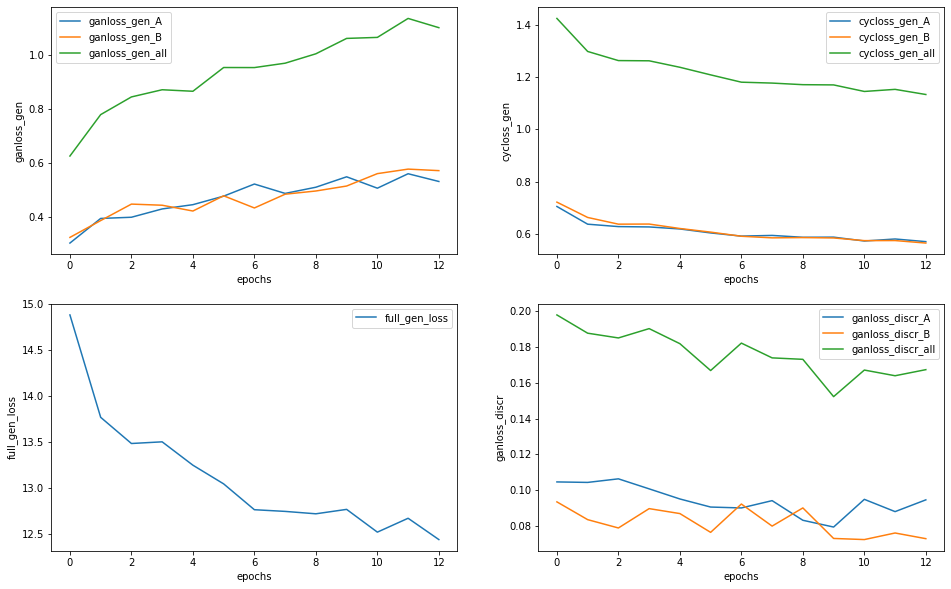

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


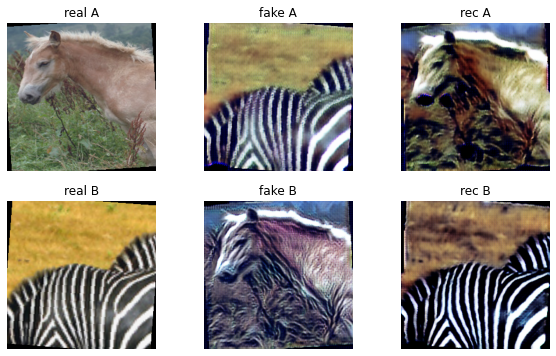

Epoch:   6%|▋         | 13/200 [3:58:58<57:20:07, 1103.78s/it]

Epoch:   6%|▋         | 13/200 [4:17:13<57:20:07, 1103.78s/it]



Generator metrics:
ganloss_gen_A: 0.5514798680
ganloss_gen_B: 0.5105489386
ganloss_gen_all: 1.0620288058
cycloss_gen_A: 0.5652775328
cycloss_gen_B: 0.5640937888
cycloss_gen_all: 1.1293713246
full_gen_loss: 12.3557420567

Discriminator metrics: 
ganloss_discr_A: 0.0938204179
ganloss_discr_B: 0.1070028244
ganloss_discr_all: 0.2008232421

lr: 0.0002


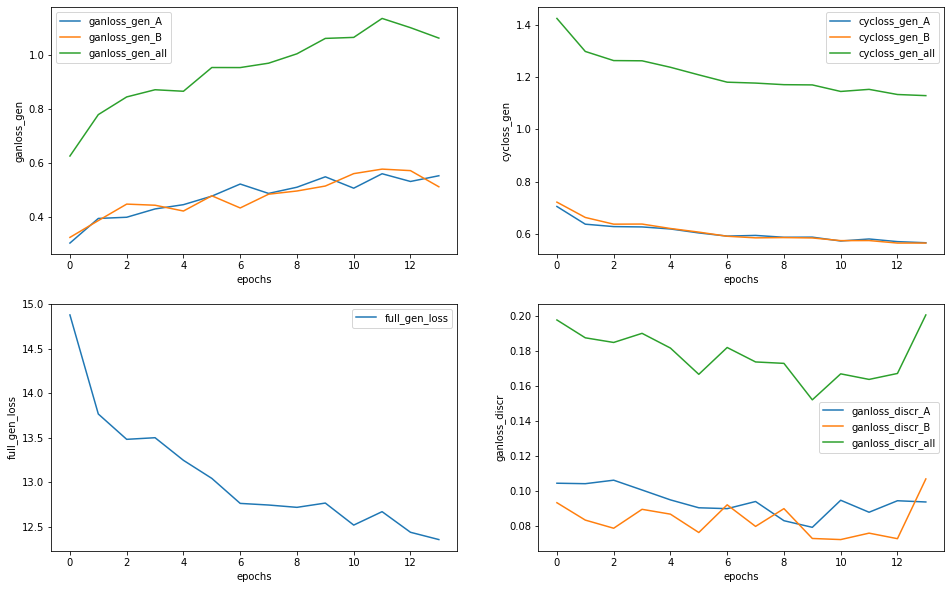

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


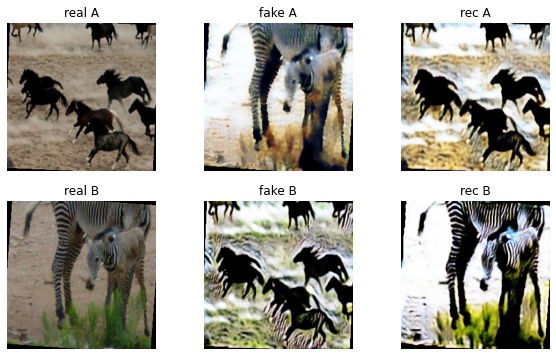

Epoch:   7%|▋         | 14/200 [4:17:22<57:01:57, 1103.86s/it]

Epoch:   7%|▋         | 14/200 [4:35:36<57:01:57, 1103.86s/it]



Generator metrics:
ganloss_gen_A: 0.4983506924
ganloss_gen_B: 0.5179717251
ganloss_gen_all: 1.0163224159
cycloss_gen_A: 0.5628895687
cycloss_gen_B: 0.5540216397
cycloss_gen_all: 1.1169112108
full_gen_loss: 12.1854345216

Discriminator metrics: 
ganloss_discr_A: 0.1258708985
ganloss_discr_B: 0.1222365228
ganloss_discr_all: 0.2481074211

lr: 0.0002


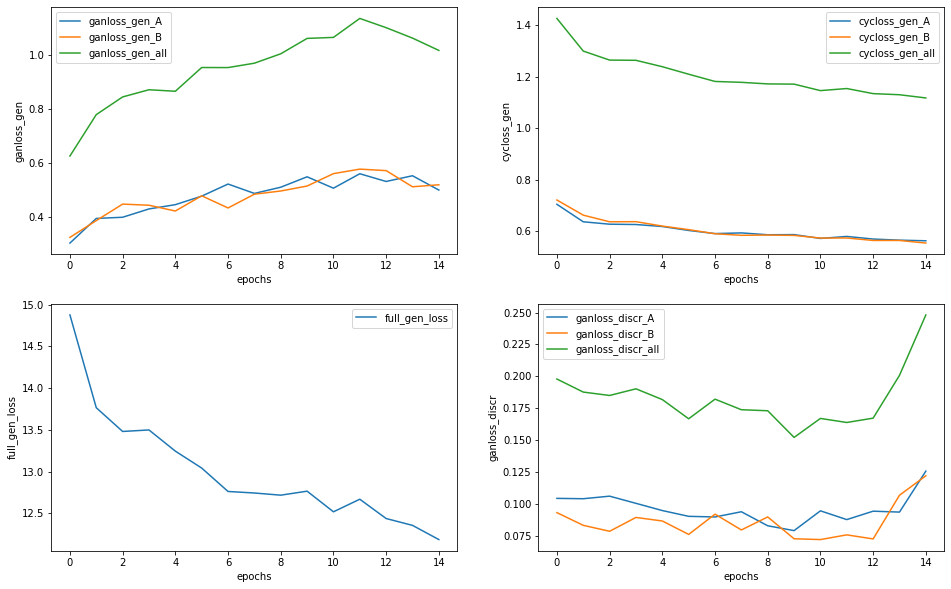

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


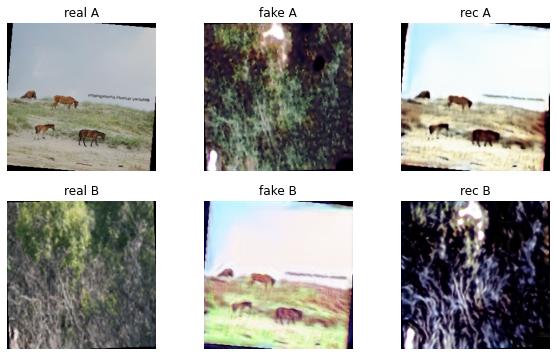

Epoch:   8%|▊         | 15/200 [4:35:46<56:43:07, 1103.72s/it]

Epoch:   8%|▊         | 15/200 [4:54:00<56:43:07, 1103.72s/it]



Generator metrics:
ganloss_gen_A: 0.4722284264
ganloss_gen_B: 0.4646973993
ganloss_gen_all: 0.9369258252
cycloss_gen_A: 0.5499768619
cycloss_gen_B: 0.5571276607
cycloss_gen_all: 1.1071045253
full_gen_loss: 12.0079710859

Discriminator metrics: 
ganloss_discr_A: 0.1713788783
ganloss_discr_B: 0.1286181951
ganloss_discr_all: 0.2999970734

lr: 0.0002


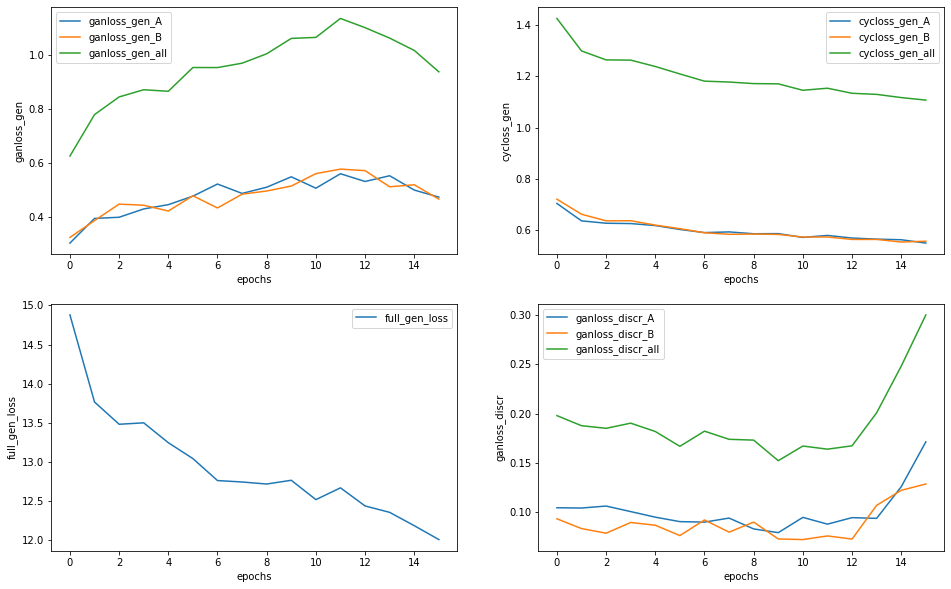

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


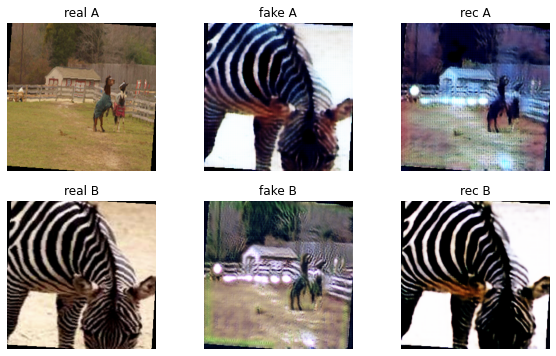

Epoch:   8%|▊         | 16/200 [4:54:10<56:25:01, 1103.81s/it]

Epoch:   8%|▊         | 16/200 [5:12:25<56:25:01, 1103.81s/it]



Generator metrics:
ganloss_gen_A: 0.3995447101
ganloss_gen_B: 0.5009756721
ganloss_gen_all: 0.9005203822
cycloss_gen_A: 0.5573133559
cycloss_gen_B: 0.5552819047
cycloss_gen_all: 1.1125952628
full_gen_loss: 12.0264730110

Discriminator metrics: 
ganloss_discr_A: 0.1815355712
ganloss_discr_B: 0.1267231663
ganloss_discr_all: 0.3082587374

lr: 0.0002


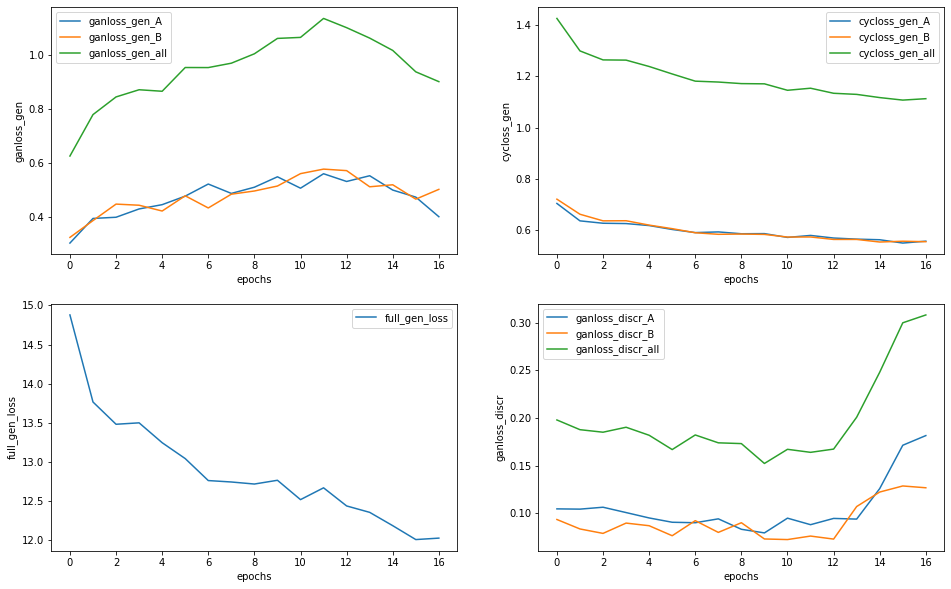

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


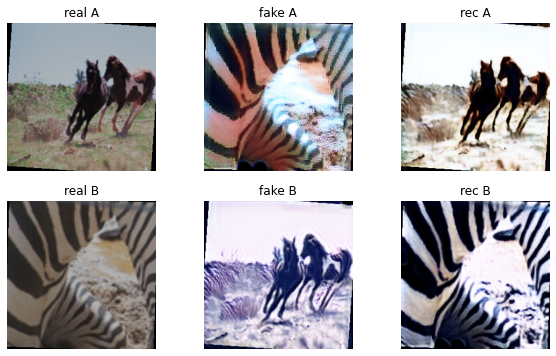

Epoch:   8%|▊         | 17/200 [5:12:35<56:07:33, 1104.12s/it]

Epoch:   8%|▊         | 17/200 [5:30:49<56:07:33, 1104.12s/it]



Generator metrics:
ganloss_gen_A: 0.4112369688
ganloss_gen_B: 0.5036041128
ganloss_gen_all: 0.9148410797
cycloss_gen_A: 0.5581739513
cycloss_gen_B: 0.5528973331
cycloss_gen_all: 1.1110712865
full_gen_loss: 12.0255539525

Discriminator metrics: 
ganloss_discr_A: 0.1673937018
ganloss_discr_B: 0.1307698951
ganloss_discr_all: 0.2981635977

lr: 0.0002


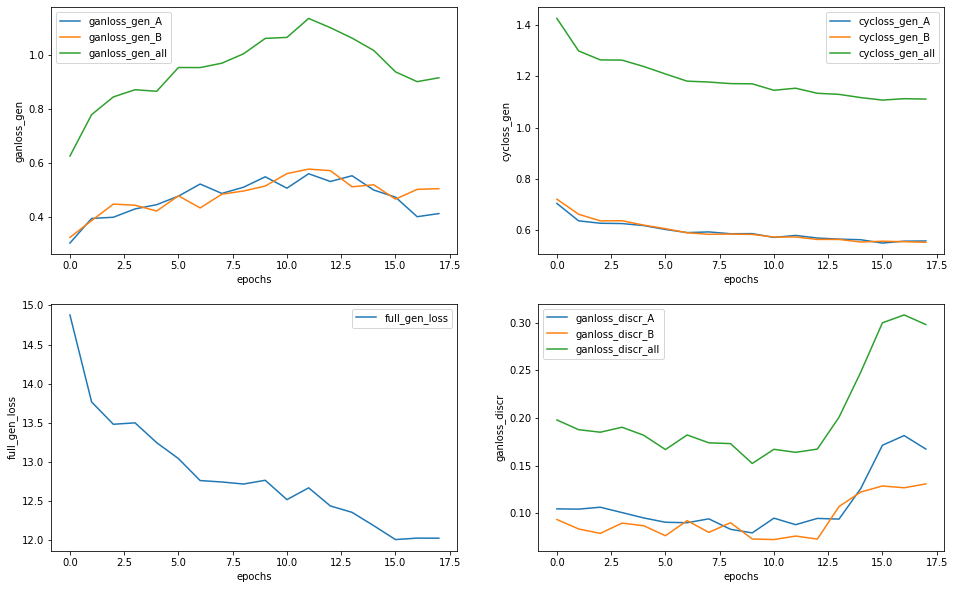

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


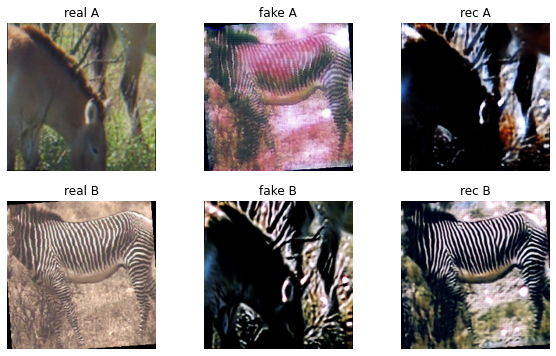

Epoch:   9%|▉         | 18/200 [5:30:59<55:49:01, 1104.08s/it]

Epoch:   9%|▉         | 18/200 [5:49:13<55:49:01, 1104.08s/it]



Generator metrics:
ganloss_gen_A: 0.4082987924
ganloss_gen_B: 0.5228540734
ganloss_gen_all: 0.9311528660
cycloss_gen_A: 0.5522005546
cycloss_gen_B: 0.5470421916
cycloss_gen_all: 1.0992427496
full_gen_loss: 11.9235803520

Discriminator metrics: 
ganloss_discr_A: 0.1822106371
ganloss_discr_B: 0.1297805981
ganloss_discr_all: 0.3119912349

lr: 0.0002


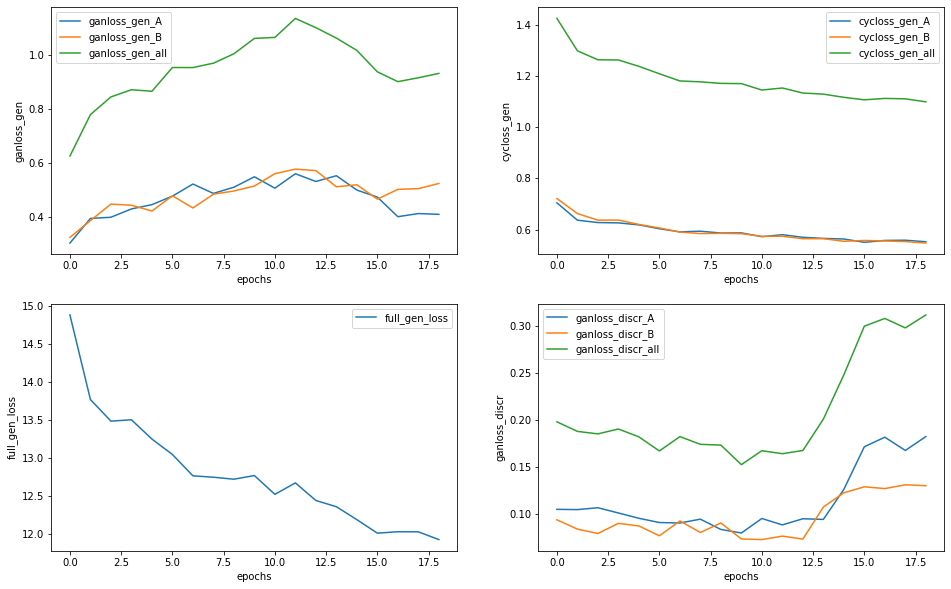

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


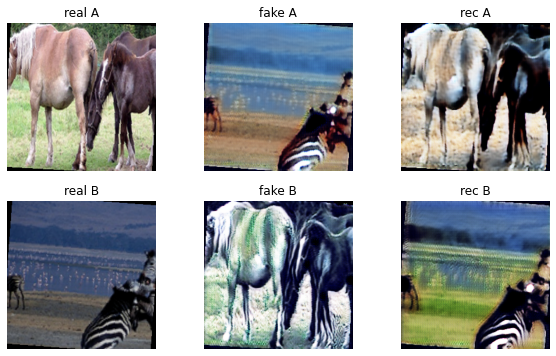

Epoch:  10%|▉         | 19/200 [5:49:22<55:30:15, 1103.95s/it]

Epoch:  10%|▉         | 19/200 [6:07:36<55:30:15, 1103.95s/it]



Generator metrics:
ganloss_gen_A: 0.4353585173
ganloss_gen_B: 0.5323220615
ganloss_gen_all: 0.9676805794
cycloss_gen_A: 0.5635597028
cycloss_gen_B: 0.5509084827
cycloss_gen_all: 1.1144681902
full_gen_loss: 12.1123624745

Discriminator metrics: 
ganloss_discr_A: 0.1702828792
ganloss_discr_B: 0.1292232468
ganloss_discr_all: 0.2995061261

lr: 0.0002


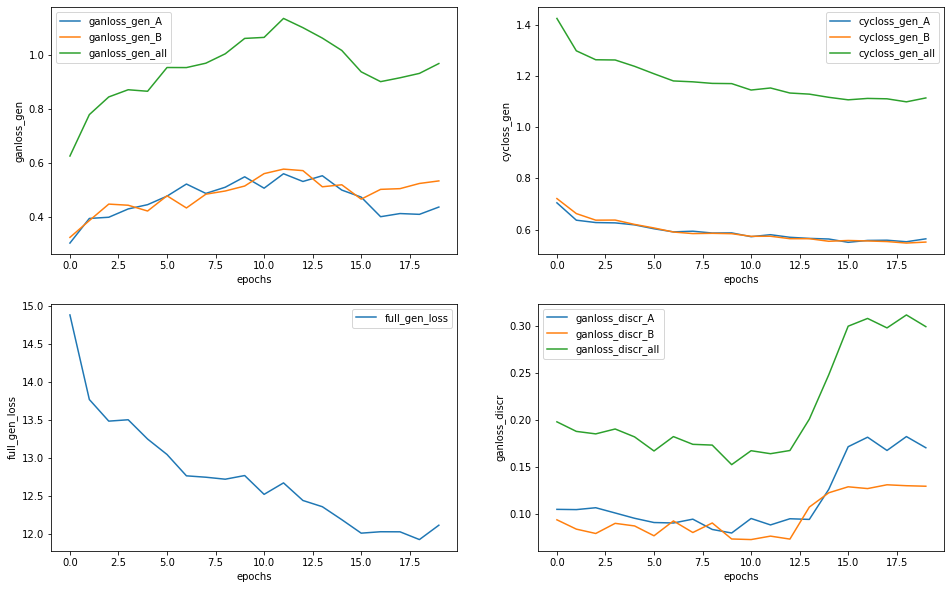

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


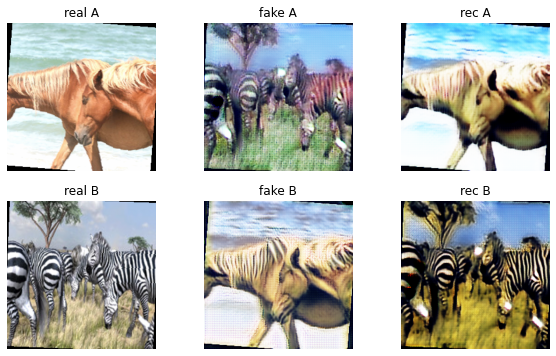

Epoch:  10%|█         | 20/200 [6:07:46<55:11:23, 1103.80s/it]

Epoch:  10%|█         | 20/200 [6:26:00<55:11:23, 1103.80s/it]



Generator metrics:
ganloss_gen_A: 0.4187390282
ganloss_gen_B: 0.5021899030
ganloss_gen_all: 0.9209289305
cycloss_gen_A: 0.5531933718
cycloss_gen_B: 0.5418783438
cycloss_gen_all: 1.0950717198
full_gen_loss: 11.8716461215

Discriminator metrics: 
ganloss_discr_A: 0.1613085143
ganloss_discr_B: 0.1196847236
ganloss_discr_all: 0.2809932376

lr: 0.0002


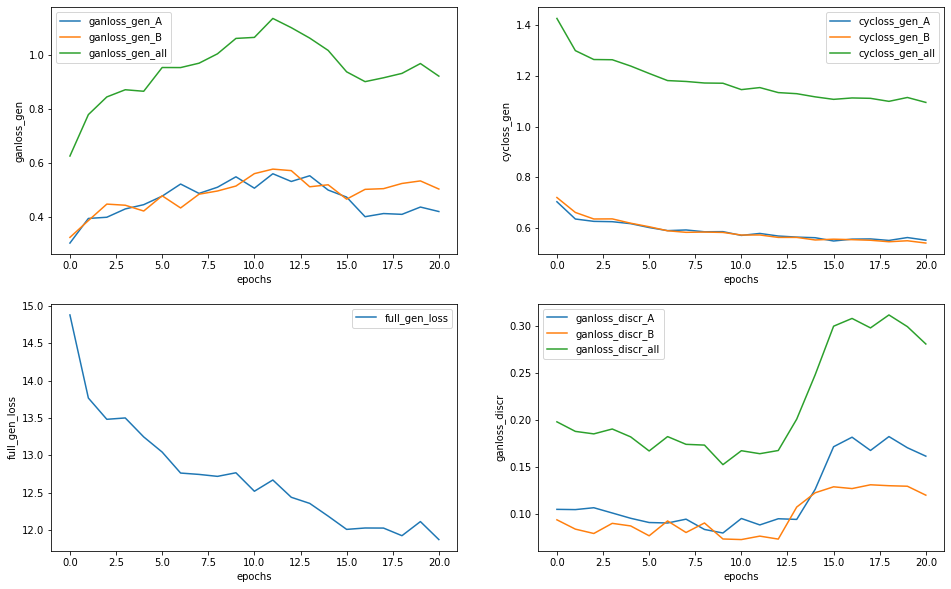

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


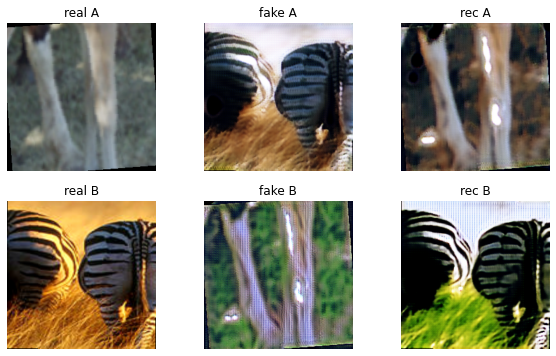

Epoch:  10%|█         | 21/200 [6:26:09<54:52:46, 1103.72s/it]

Epoch:  10%|█         | 21/200 [6:44:23<54:52:46, 1103.72s/it]



Generator metrics:
ganloss_gen_A: 0.4464644458
ganloss_gen_B: 0.5058386923
ganloss_gen_all: 0.9523031367
cycloss_gen_A: 0.5470639240
cycloss_gen_B: 0.5435107123
cycloss_gen_all: 1.0905746375
full_gen_loss: 11.8580495271

Discriminator metrics: 
ganloss_discr_A: 0.1610901255
ganloss_discr_B: 0.1359379269
ganloss_discr_all: 0.2970280523

lr: 0.0002


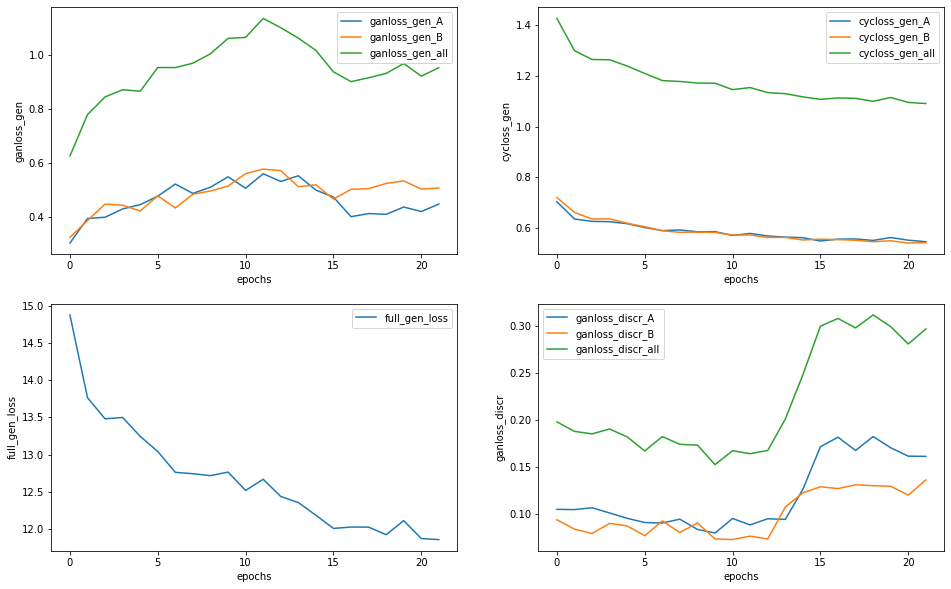

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


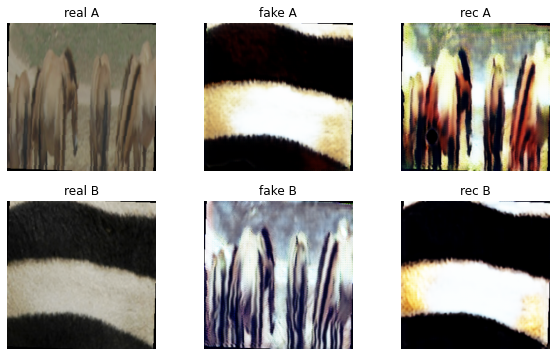

Epoch:  11%|█         | 22/200 [6:44:32<54:33:26, 1103.41s/it]

Epoch:  11%|█         | 22/200 [7:02:47<54:33:26, 1103.41s/it]



Generator metrics:
ganloss_gen_A: 0.4374968324
ganloss_gen_B: 0.5215415313
ganloss_gen_all: 0.9590383635
cycloss_gen_A: 0.5451296958
cycloss_gen_B: 0.5438275553
cycloss_gen_all: 1.0889572530
full_gen_loss: 11.8486108876

Discriminator metrics: 
ganloss_discr_A: 0.1578716558
ganloss_discr_B: 0.1351651258
ganloss_discr_all: 0.2930367814

lr: 0.0002


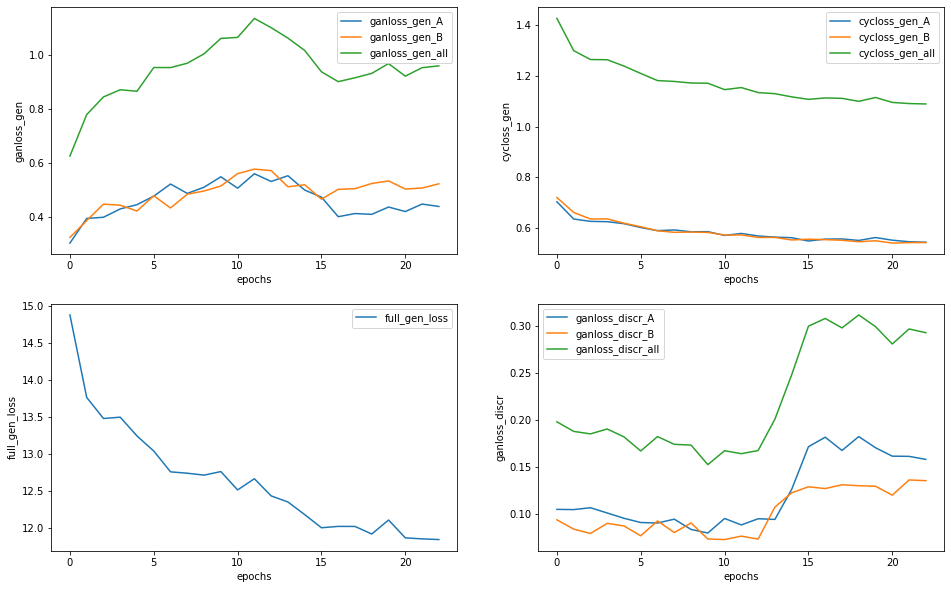

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


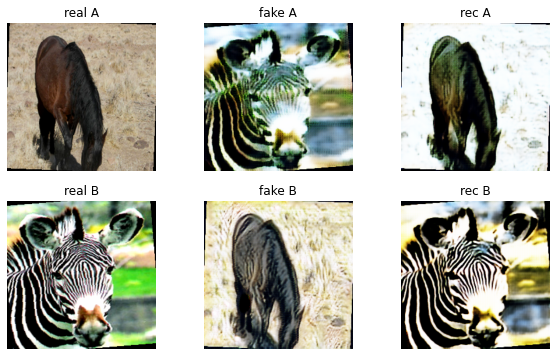

Epoch:  12%|█▏        | 23/200 [7:02:57<54:16:06, 1103.77s/it]

Epoch:  12%|█▏        | 23/200 [7:21:11<54:16:06, 1103.77s/it]



Generator metrics:
ganloss_gen_A: 0.4655026162
ganloss_gen_B: 0.4873562956
ganloss_gen_all: 0.9528589110
cycloss_gen_A: 0.5462129584
cycloss_gen_B: 0.5469018842
cycloss_gen_all: 1.0931148442
full_gen_loss: 11.8840073560

Discriminator metrics: 
ganloss_discr_A: 0.1510131513
ganloss_discr_B: 0.1201698181
ganloss_discr_all: 0.2711829692

lr: 0.0002


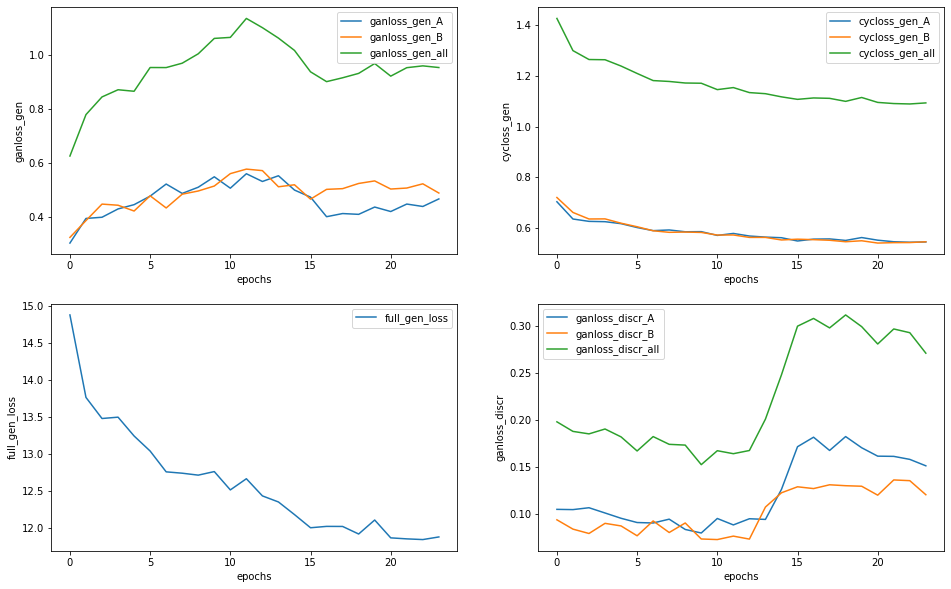

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


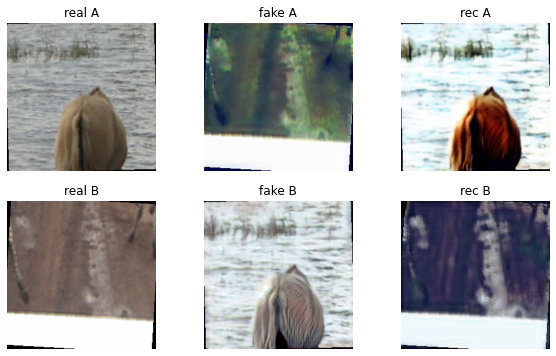

Epoch:  12%|█▏        | 24/200 [7:21:20<53:57:09, 1103.58s/it]

Epoch:  12%|█▏        | 24/200 [7:39:34<53:57:09, 1103.58s/it]



Generator metrics:
ganloss_gen_A: 0.4322296686
ganloss_gen_B: 0.5157559768
ganloss_gen_all: 0.9479856439
cycloss_gen_A: 0.5396119312
cycloss_gen_B: 0.5450543674
cycloss_gen_all: 1.0846663011
full_gen_loss: 11.7946486612

Discriminator metrics: 
ganloss_discr_A: 0.1634363223
ganloss_discr_B: 0.1300418425
ganloss_discr_all: 0.2934781643

lr: 0.0002


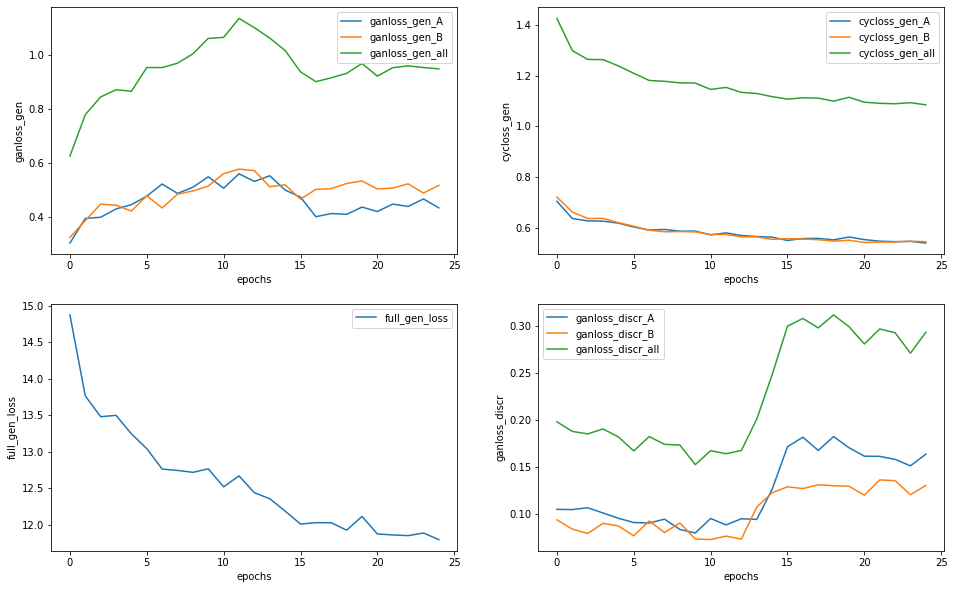

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


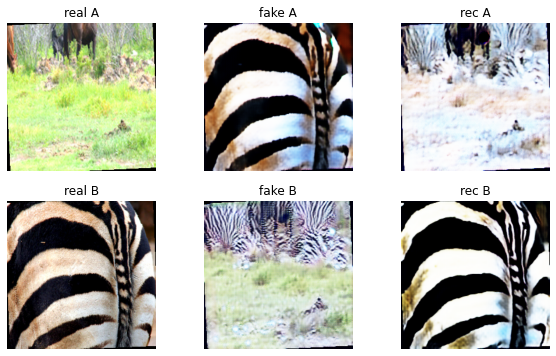

Epoch:  12%|█▎        | 25/200 [7:39:43<53:38:53, 1103.62s/it]

Epoch:  12%|█▎        | 25/200 [7:57:58<53:38:53, 1103.62s/it]



Generator metrics:
ganloss_gen_A: 0.4651706474
ganloss_gen_B: 0.5125239475
ganloss_gen_all: 0.9776945948
cycloss_gen_A: 0.5324848343
cycloss_gen_B: 0.5454198475
cycloss_gen_all: 1.0779046843
full_gen_loss: 11.7567414169

Discriminator metrics: 
ganloss_discr_A: 0.1530641532
ganloss_discr_B: 0.1281104816
ganloss_discr_all: 0.2811746351

lr: 0.0002


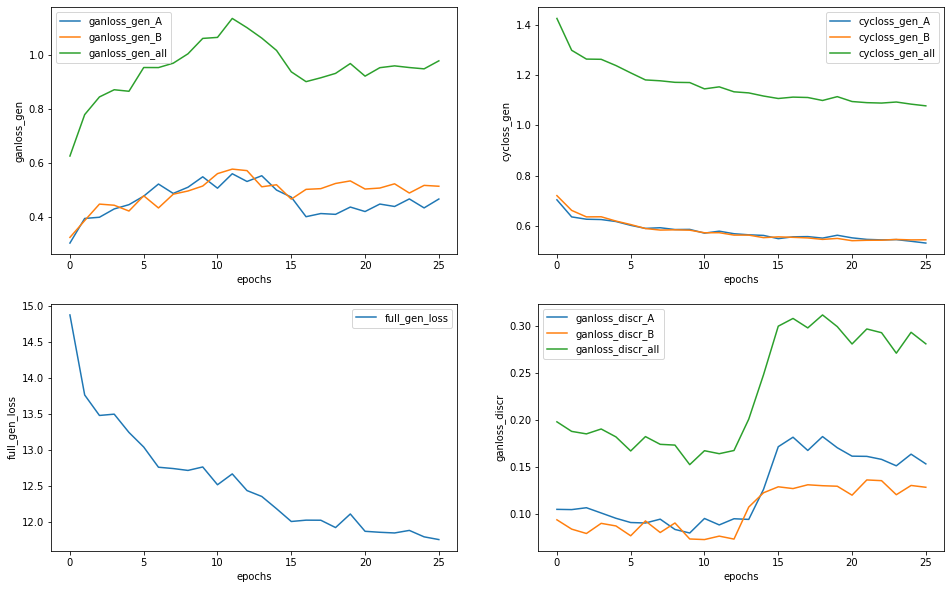

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


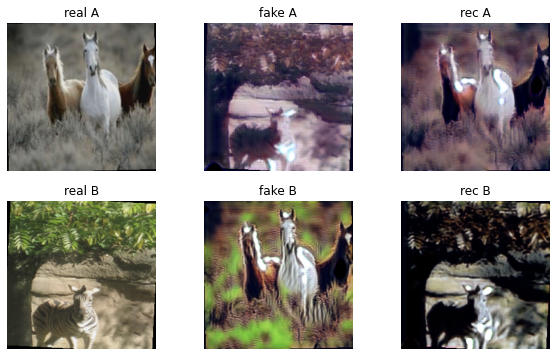

Epoch:  13%|█▎        | 26/200 [7:58:07<53:20:42, 1103.69s/it]

Epoch:  13%|█▎        | 26/200 [8:16:21<53:20:42, 1103.69s/it]



Generator metrics:
ganloss_gen_A: 0.4680234231
ganloss_gen_B: 0.5237505802
ganloss_gen_all: 0.9917740020
cycloss_gen_A: 0.5372173517
cycloss_gen_B: 0.5433246080
cycloss_gen_all: 1.0805419615
full_gen_loss: 11.7971936137

Discriminator metrics: 
ganloss_discr_A: 0.1489473199
ganloss_discr_B: 0.1197250641
ganloss_discr_all: 0.2686723839

lr: 0.0002


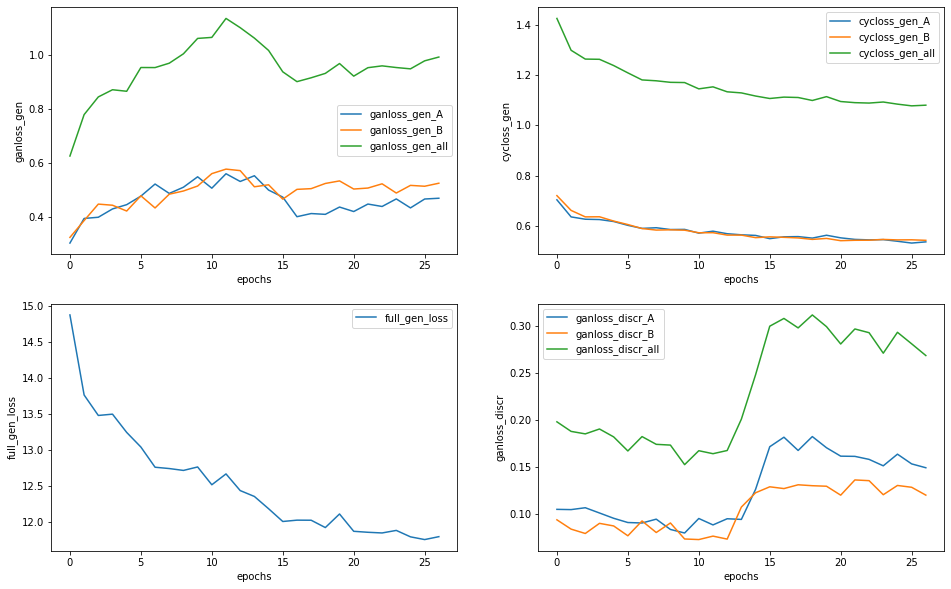

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


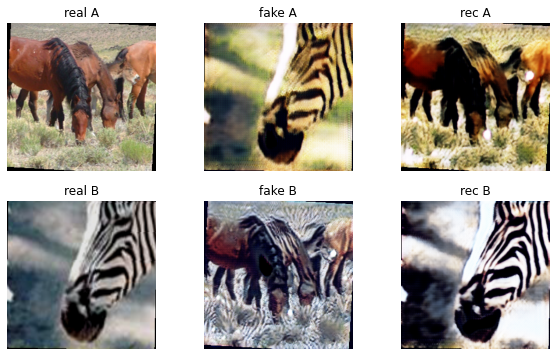

Epoch:  14%|█▎        | 27/200 [8:16:31<53:02:11, 1103.65s/it]

Epoch:  14%|█▎        | 27/200 [8:34:45<53:02:11, 1103.65s/it]



Generator metrics:
ganloss_gen_A: 0.4353391484
ganloss_gen_B: 0.5287787863
ganloss_gen_all: 0.9641179361
cycloss_gen_A: 0.5340605791
cycloss_gen_B: 0.5425193925
cycloss_gen_all: 1.0765799730
full_gen_loss: 11.7299176689

Discriminator metrics: 
ganloss_discr_A: 0.1525931086
ganloss_discr_B: 0.1247067549
ganloss_discr_all: 0.2772998639

lr: 0.0002


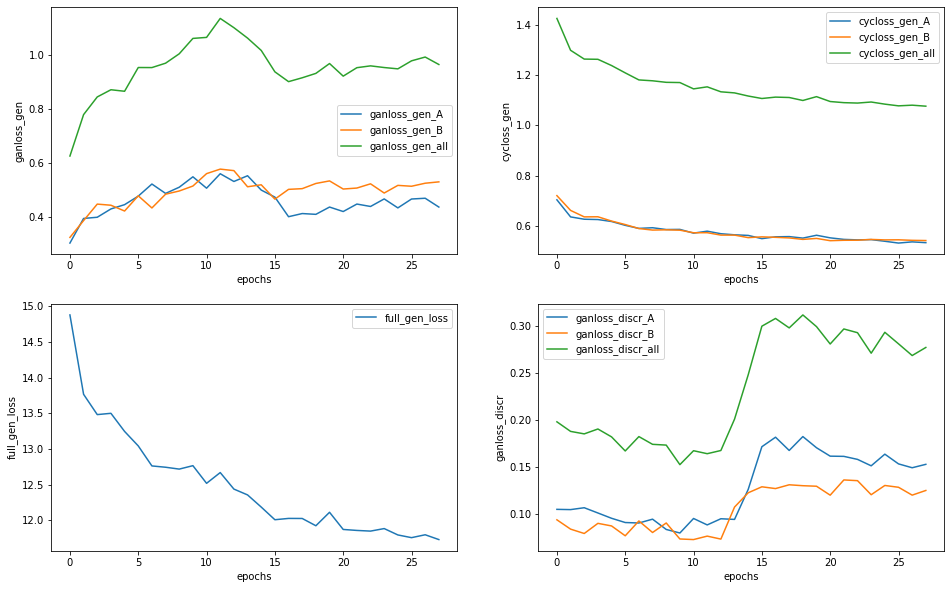

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


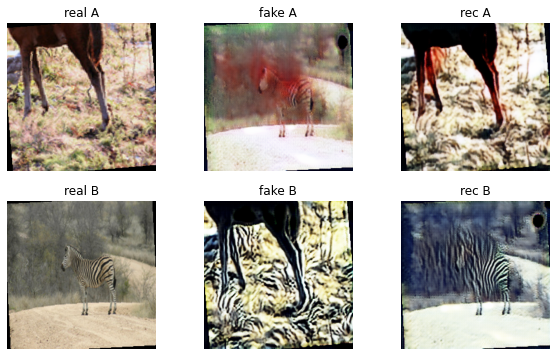

Epoch:  14%|█▍        | 28/200 [8:34:54<52:43:44, 1103.63s/it]

Epoch:  14%|█▍        | 28/200 [8:53:09<52:43:44, 1103.63s/it]



Generator metrics:
ganloss_gen_A: 0.4668545958
ganloss_gen_B: 0.5522604364
ganloss_gen_all: 1.0191150306
cycloss_gen_A: 0.5356277982
cycloss_gen_B: 0.5431775925
cycloss_gen_all: 1.0788053931
full_gen_loss: 11.8071689441

Discriminator metrics: 
ganloss_discr_A: 0.1462630857
ganloss_discr_B: 0.1237745203
ganloss_discr_all: 0.2700376060

lr: 0.0002


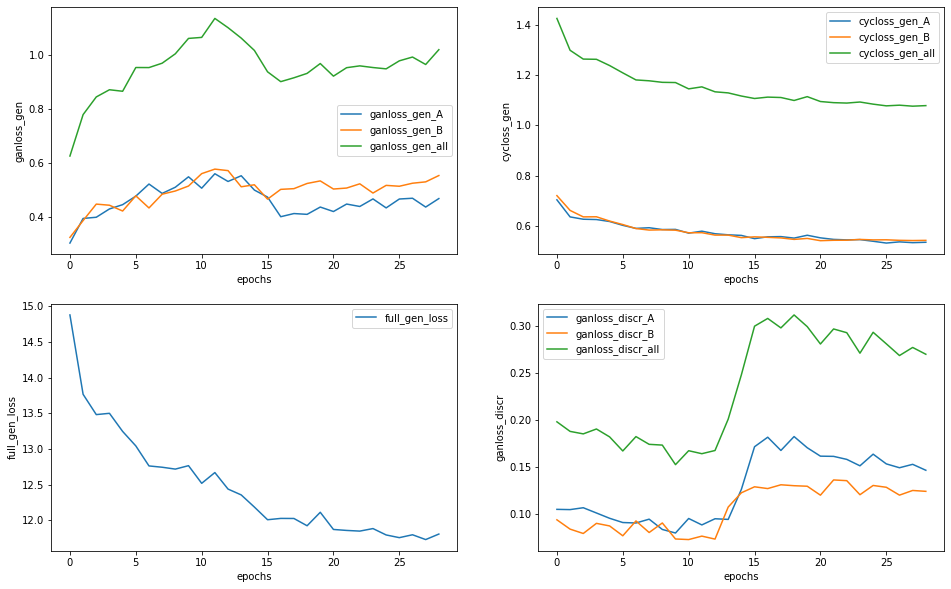

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


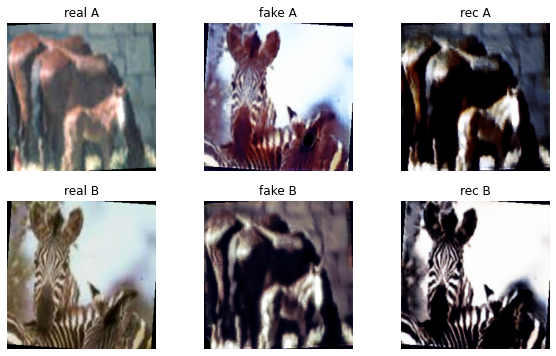

Epoch:  14%|█▍        | 29/200 [8:53:18<52:25:43, 1103.76s/it]

Epoch:  14%|█▍        | 29/200 [9:11:33<52:25:43, 1103.76s/it]



Generator metrics:
ganloss_gen_A: 0.4878964083
ganloss_gen_B: 0.5157319317
ganloss_gen_all: 1.0036283400
cycloss_gen_A: 0.5302535046
cycloss_gen_B: 0.5334646337
cycloss_gen_all: 1.0637181413
full_gen_loss: 11.6408097572

Discriminator metrics: 
ganloss_discr_A: 0.1416092633
ganloss_discr_B: 0.1182974468
ganloss_discr_all: 0.2599067105

lr: 0.0002


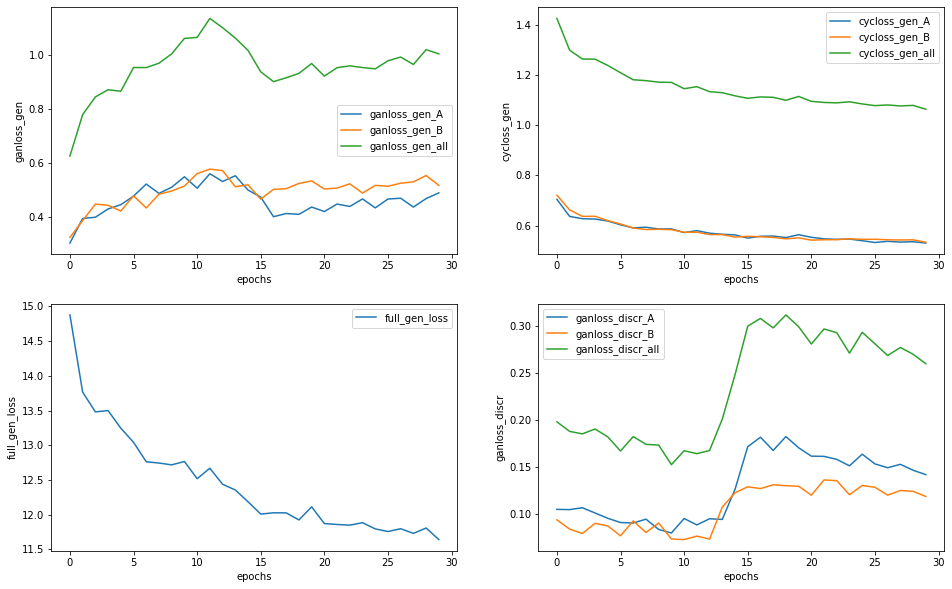

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


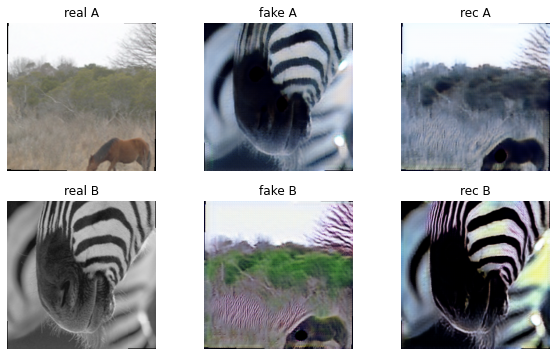

Epoch:  15%|█▌        | 30/200 [9:11:42<52:07:07, 1103.69s/it]

Epoch:  15%|█▌        | 30/200 [9:29:56<52:07:07, 1103.69s/it]



Generator metrics:
ganloss_gen_A: 0.4532674823
ganloss_gen_B: 0.5217190923
ganloss_gen_all: 0.9749865745
cycloss_gen_A: 0.5282823417
cycloss_gen_B: 0.5357353153
cycloss_gen_all: 1.0640176589
full_gen_loss: 11.6151631572

Discriminator metrics: 
ganloss_discr_A: 0.1457118941
ganloss_discr_B: 0.1203768265
ganloss_discr_all: 0.2660887208

lr: 0.0002


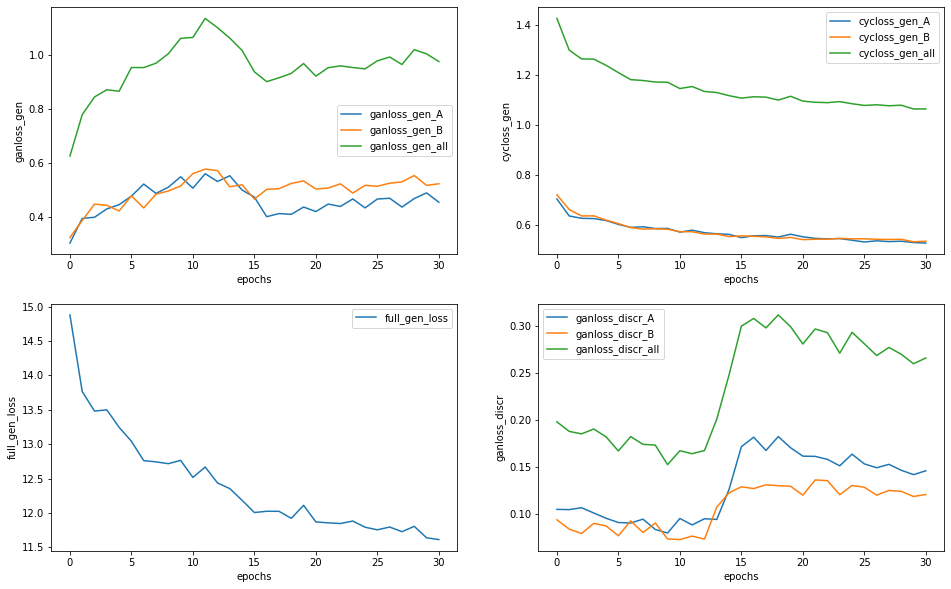

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


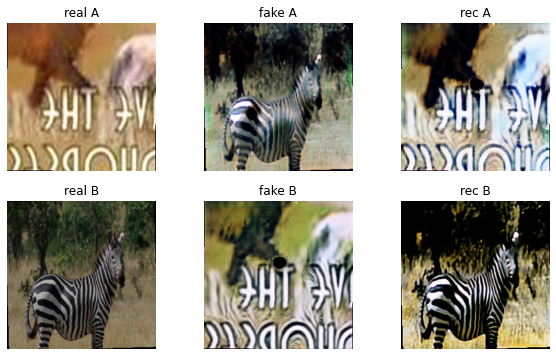

Epoch:  16%|█▌        | 31/200 [9:30:05<51:48:34, 1103.64s/it]

Epoch:  16%|█▌        | 31/200 [9:48:21<51:48:34, 1103.64s/it]



Generator metrics:
ganloss_gen_A: 0.4836193808
ganloss_gen_B: 0.5455195189
ganloss_gen_all: 1.0291388992
cycloss_gen_A: 0.5348449542
cycloss_gen_B: 0.5312207793
cycloss_gen_all: 1.0660657342
full_gen_loss: 11.6897962651

Discriminator metrics: 
ganloss_discr_A: 0.1493710687
ganloss_discr_B: 0.1103615972
ganloss_discr_all: 0.2597326656

lr: 0.0002


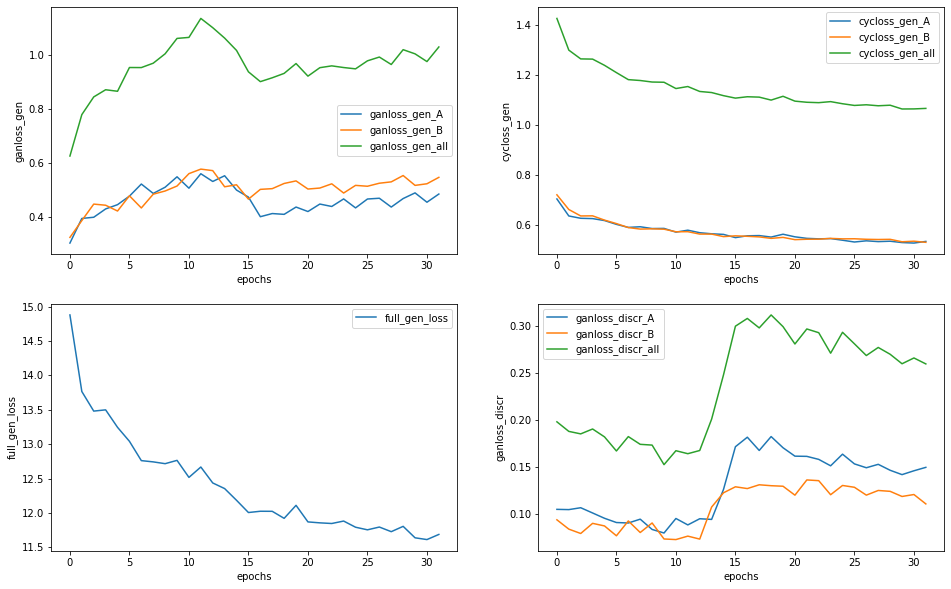

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


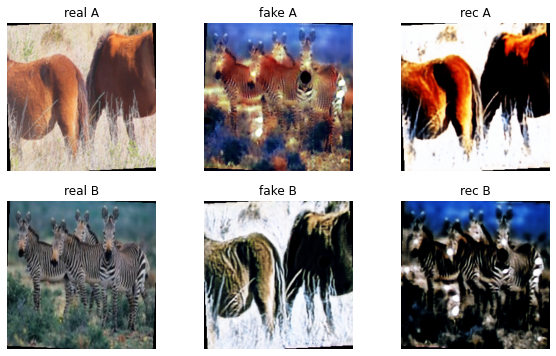

Epoch:  16%|█▌        | 32/200 [9:48:30<51:30:35, 1103.78s/it]

Epoch:  16%|█▌        | 32/200 [10:06:44<51:30:35, 1103.78s/it]



Generator metrics:
ganloss_gen_A: 0.4722409276
ganloss_gen_B: 0.5605087617
ganloss_gen_all: 1.0327496903
cycloss_gen_A: 0.5277363627
cycloss_gen_B: 0.5287387593
cycloss_gen_all: 1.0564751243
full_gen_loss: 11.5975009484

Discriminator metrics: 
ganloss_discr_A: 0.1443753967
ganloss_discr_B: 0.1142886709
ganloss_discr_all: 0.2586640680

lr: 0.0002


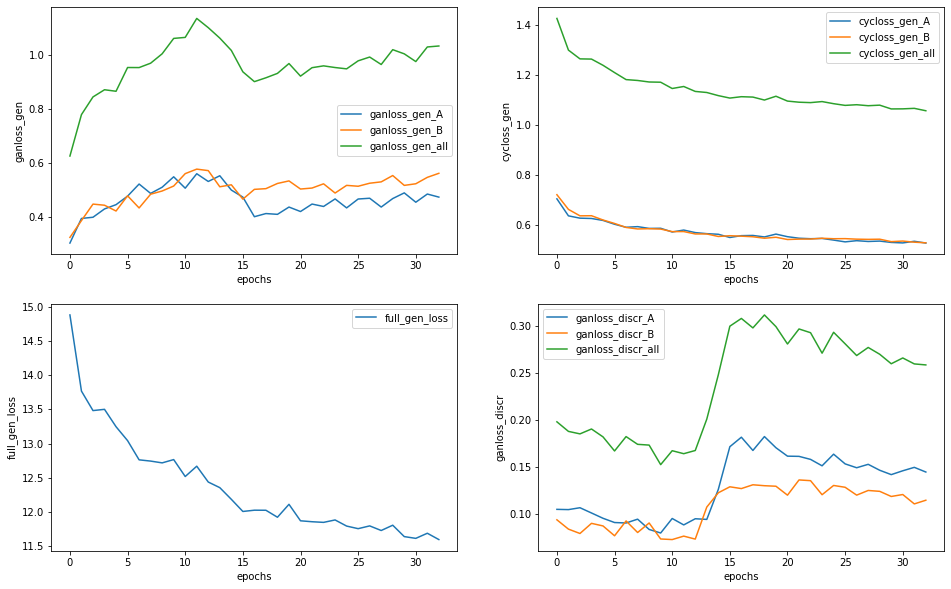

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


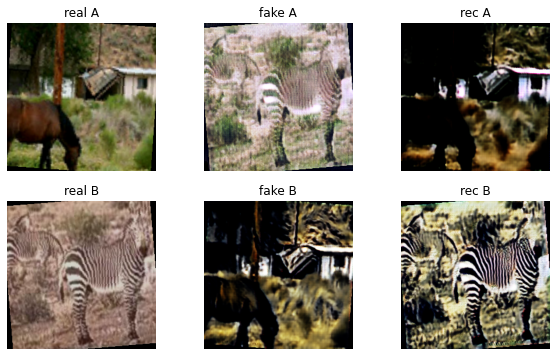

Epoch:  16%|█▋        | 33/200 [10:06:54<51:12:30, 1103.89s/it]

Epoch:  16%|█▋        | 33/200 [10:25:07<51:12:30, 1103.89s/it]



Generator metrics:
ganloss_gen_A: 0.4771181387
ganloss_gen_B: 0.5546402584
ganloss_gen_all: 1.0317583956
cycloss_gen_A: 0.5317320707
cycloss_gen_B: 0.5288172703
cycloss_gen_all: 1.0605493434
full_gen_loss: 11.6372518432

Discriminator metrics: 
ganloss_discr_A: 0.1376126192
ganloss_discr_B: 0.1210786285
ganloss_discr_all: 0.2586912478

lr: 0.0002


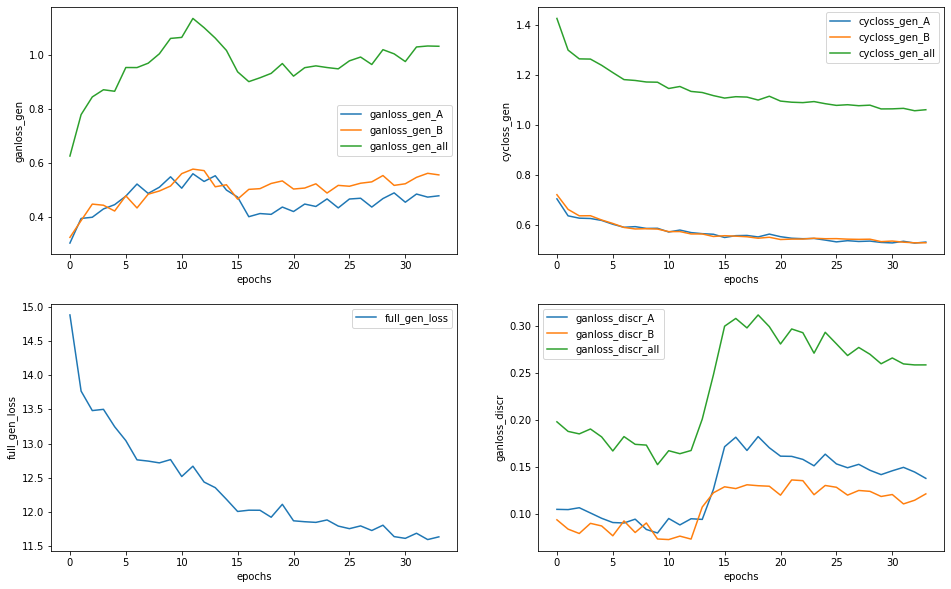

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


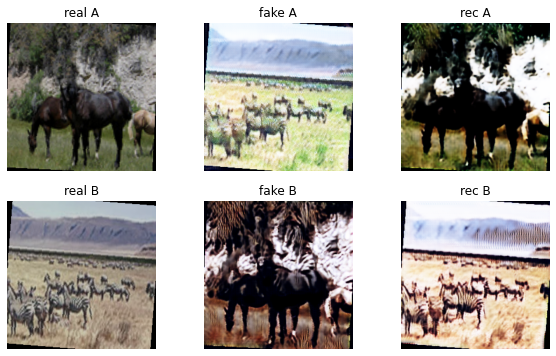

Epoch:  17%|█▋        | 34/200 [10:25:17<50:53:21, 1103.62s/it]

Epoch:  17%|█▋        | 34/200 [10:43:31<50:53:21, 1103.62s/it]



Generator metrics:
ganloss_gen_A: 0.4490080210
ganloss_gen_B: 0.5356998870
ganloss_gen_all: 0.9847079061
cycloss_gen_A: 0.5287704270
cycloss_gen_B: 0.5232395645
cycloss_gen_all: 1.0520099925
full_gen_loss: 11.5048078368

Discriminator metrics: 
ganloss_discr_A: 0.1529648214
ganloss_discr_B: 0.1229029785
ganloss_discr_all: 0.2758678001

lr: 0.0002


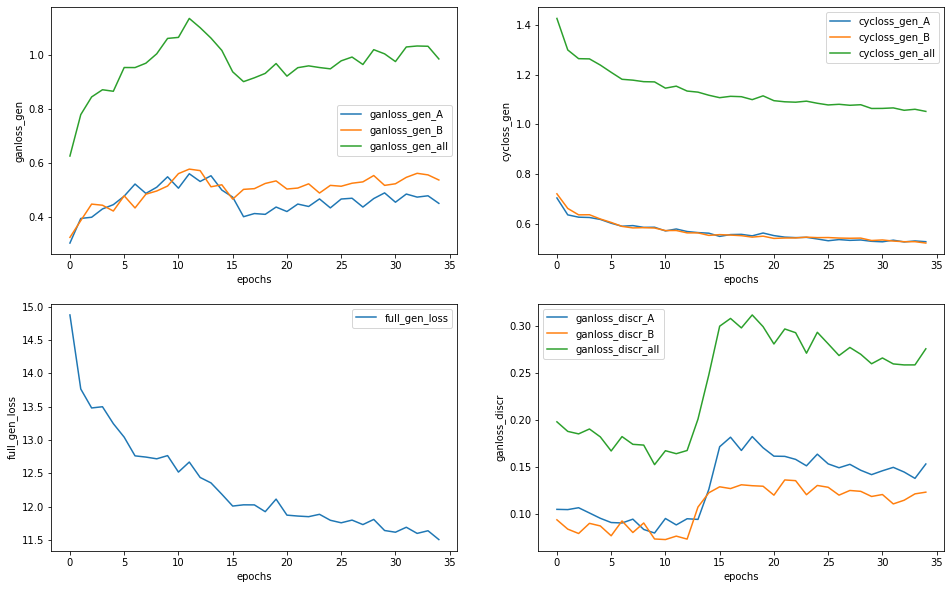

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


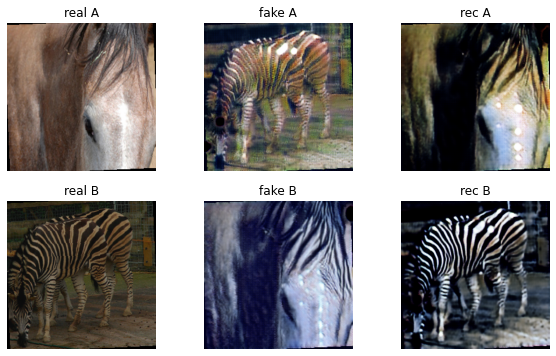

Epoch:  18%|█▊        | 35/200 [10:43:41<50:35:21, 1103.77s/it]

Epoch:  18%|█▊        | 35/200 [11:01:55<50:35:21, 1103.77s/it]



Generator metrics:
ganloss_gen_A: 0.4904026768
ganloss_gen_B: 0.5174448790
ganloss_gen_all: 1.0078475580
cycloss_gen_A: 0.5279862694
cycloss_gen_B: 0.5297344288
cycloss_gen_all: 1.0577206988
full_gen_loss: 11.5850545434

Discriminator metrics: 
ganloss_discr_A: 0.1504032795
ganloss_discr_B: 0.1216907775
ganloss_discr_all: 0.2720940571

lr: 0.0002


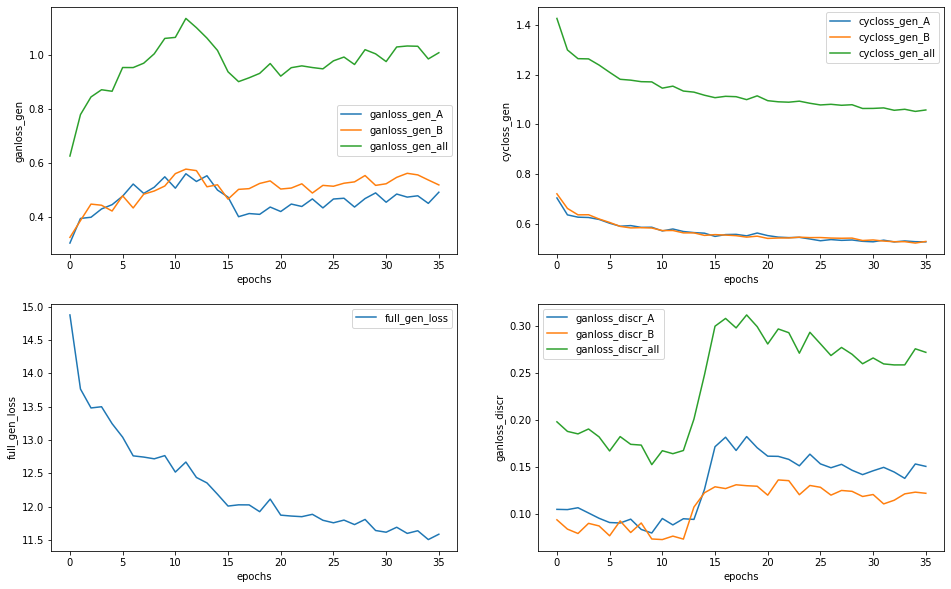

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


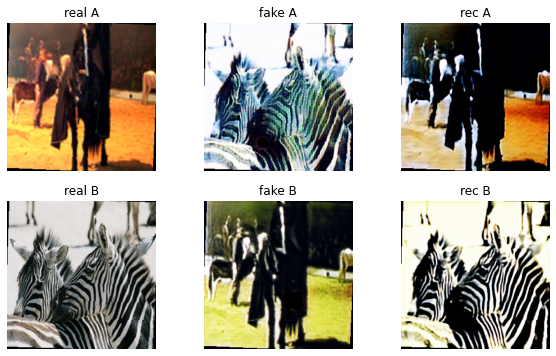

Epoch:  18%|█▊        | 36/200 [11:02:05<50:17:12, 1103.86s/it]

Epoch:  18%|█▊        | 36/200 [11:20:19<50:17:12, 1103.86s/it]



Generator metrics:
ganloss_gen_A: 0.4797463354
ganloss_gen_B: 0.5255835840
ganloss_gen_all: 1.0053299193
cycloss_gen_A: 0.5351339535
cycloss_gen_B: 0.5322271373
cycloss_gen_all: 1.0673610936
full_gen_loss: 11.6789408699

Discriminator metrics: 
ganloss_discr_A: 0.1476582906
ganloss_discr_B: 0.1245086068
ganloss_discr_all: 0.2721668976

lr: 0.0002


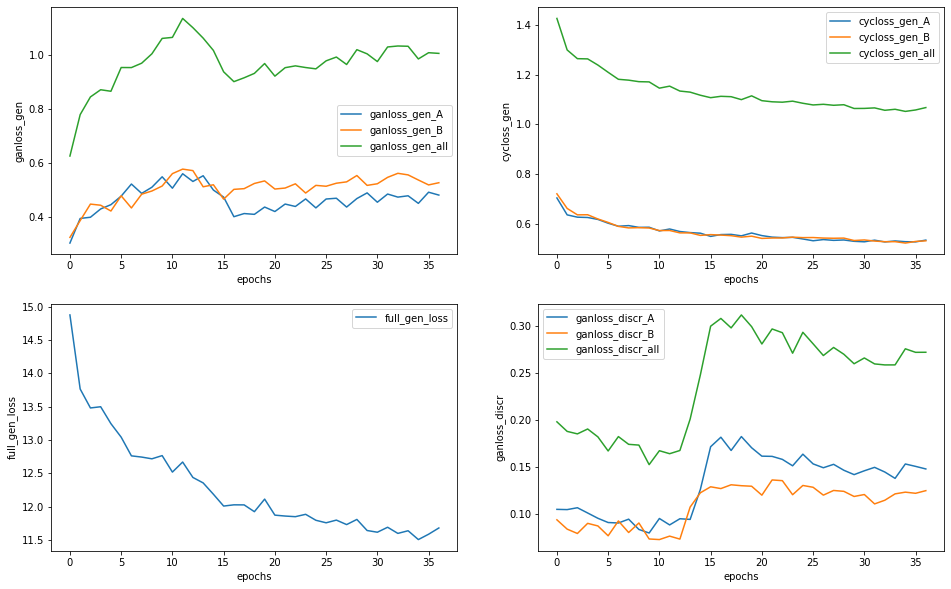

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


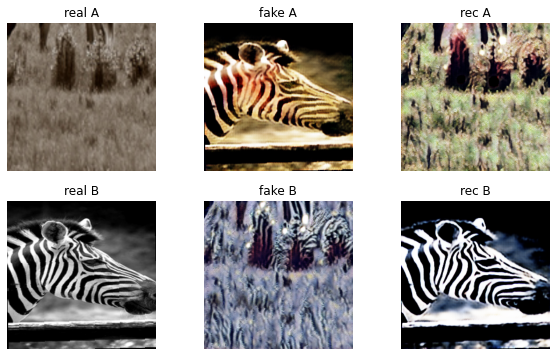

Epoch:  18%|█▊        | 37/200 [11:20:28<49:58:31, 1103.75s/it]

Epoch:  18%|█▊        | 37/200 [11:38:43<49:58:31, 1103.75s/it]



Generator metrics:
ganloss_gen_A: 0.4754520095
ganloss_gen_B: 0.5326357448
ganloss_gen_all: 1.0080877528
cycloss_gen_A: 0.5258378189
cycloss_gen_B: 0.5232498338
cycloss_gen_all: 1.0490876557
full_gen_loss: 11.4989643151

Discriminator metrics: 
ganloss_discr_A: 0.1421209819
ganloss_discr_B: 0.1253736003
ganloss_discr_all: 0.2674945818

lr: 0.0002


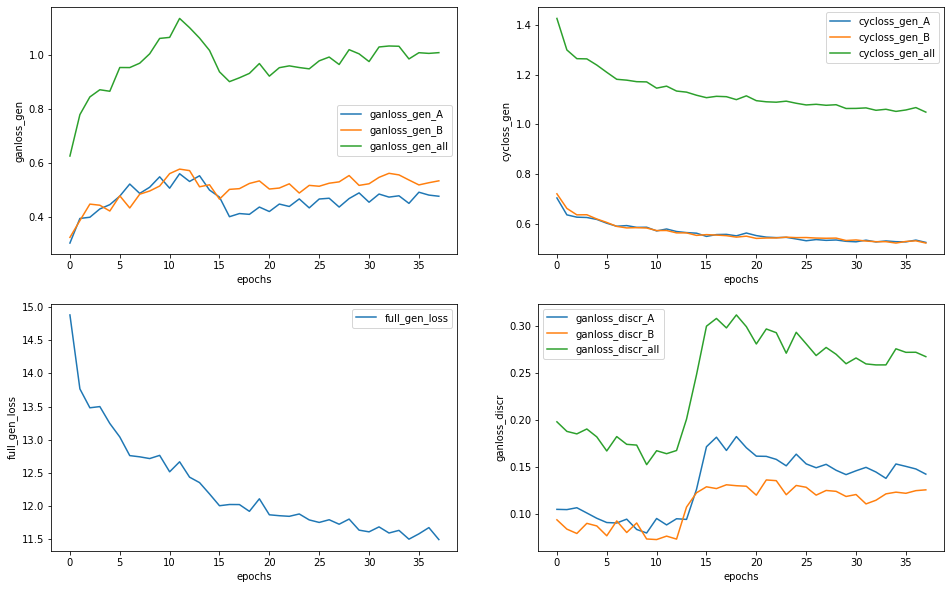

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


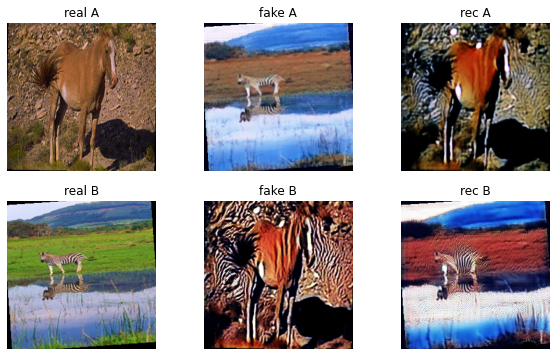

Epoch:  19%|█▉        | 38/200 [11:38:52<49:40:10, 1103.77s/it]

Epoch:  19%|█▉        | 38/200 [11:57:06<49:40:10, 1103.77s/it]



Generator metrics:
ganloss_gen_A: 0.4806284264
ganloss_gen_B: 0.5613088327
ganloss_gen_all: 1.0419372591
cycloss_gen_A: 0.5205788791
cycloss_gen_B: 0.5251283136
cycloss_gen_all: 1.0457071957
full_gen_loss: 11.4990091974

Discriminator metrics: 
ganloss_discr_A: 0.1389212636
ganloss_discr_B: 0.1142472657
ganloss_discr_all: 0.2531685295

lr: 0.0002


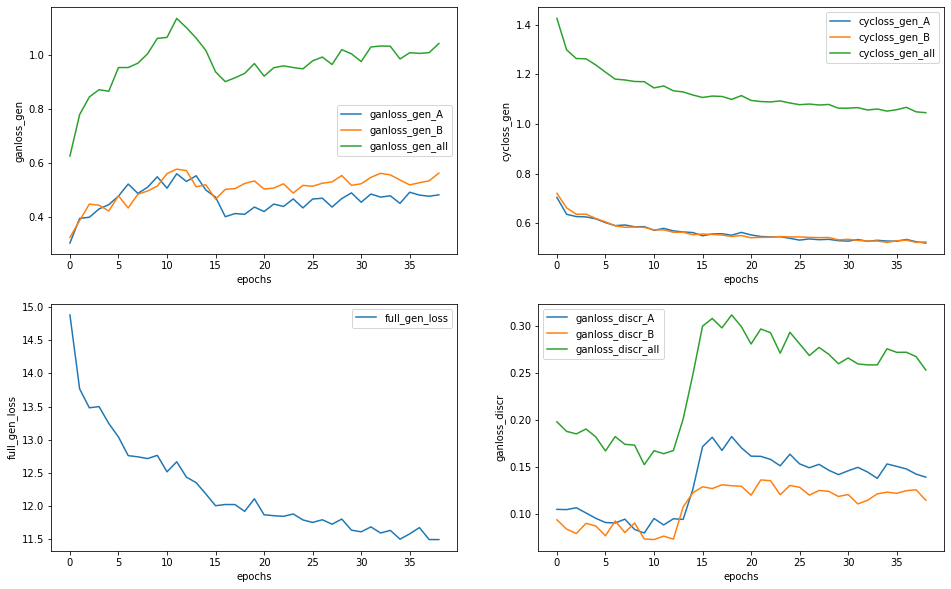

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


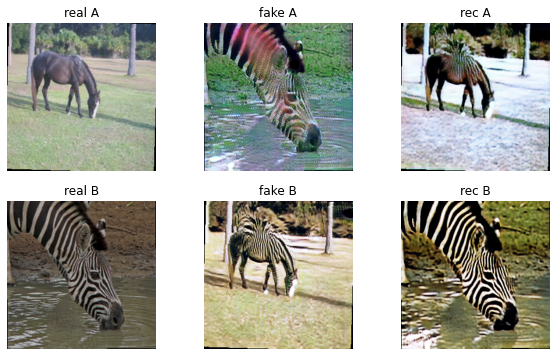

Epoch:  20%|█▉        | 39/200 [11:57:17<49:22:21, 1103.98s/it]

Epoch:  20%|█▉        | 39/200 [12:15:31<49:22:21, 1103.98s/it]



Generator metrics:
ganloss_gen_A: 0.4573379244
ganloss_gen_B: 0.5694050811
ganloss_gen_all: 1.0267430043
cycloss_gen_A: 0.5239156797
cycloss_gen_B: 0.5286701450
cycloss_gen_all: 1.0525858290
full_gen_loss: 11.5526013020

Discriminator metrics: 
ganloss_discr_A: 0.1472868574
ganloss_discr_B: 0.1187422208
ganloss_discr_all: 0.2660290784

lr: 0.0002


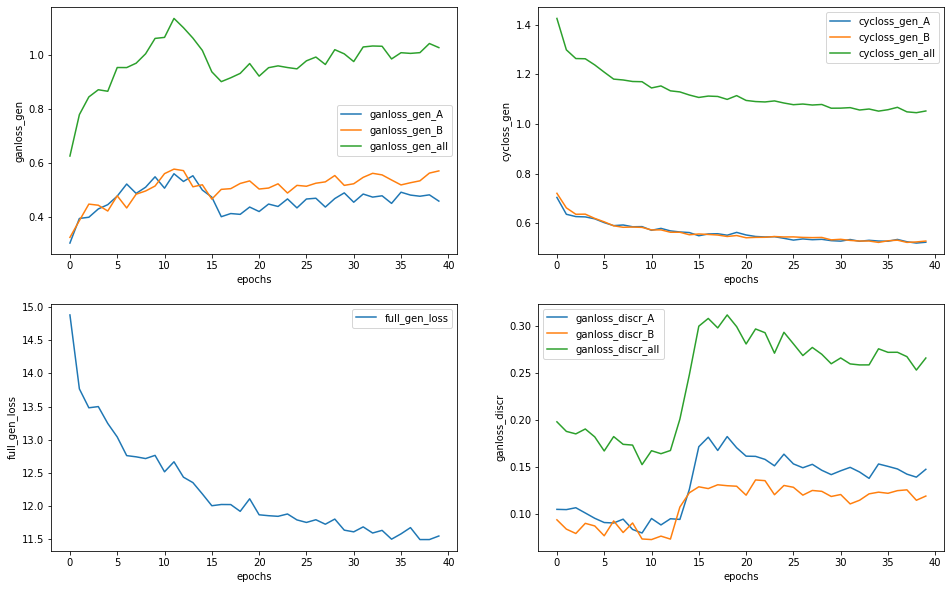

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


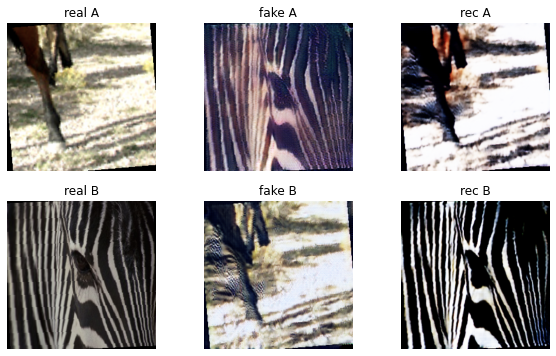

Epoch:  20%|██        | 40/200 [12:15:40<49:03:27, 1103.80s/it]

Epoch:  20%|██        | 40/200 [12:33:55<49:03:27, 1103.80s/it]



Generator metrics:
ganloss_gen_A: 0.4746657181
ganloss_gen_B: 0.5686859577
ganloss_gen_all: 1.0433516751
cycloss_gen_A: 0.5267757945
cycloss_gen_B: 0.5235678519
cycloss_gen_all: 1.0503436488
full_gen_loss: 11.5467881756

Discriminator metrics: 
ganloss_discr_A: 0.1373049609
ganloss_discr_B: 0.1054779093
ganloss_discr_all: 0.2427828706

lr: 0.0002


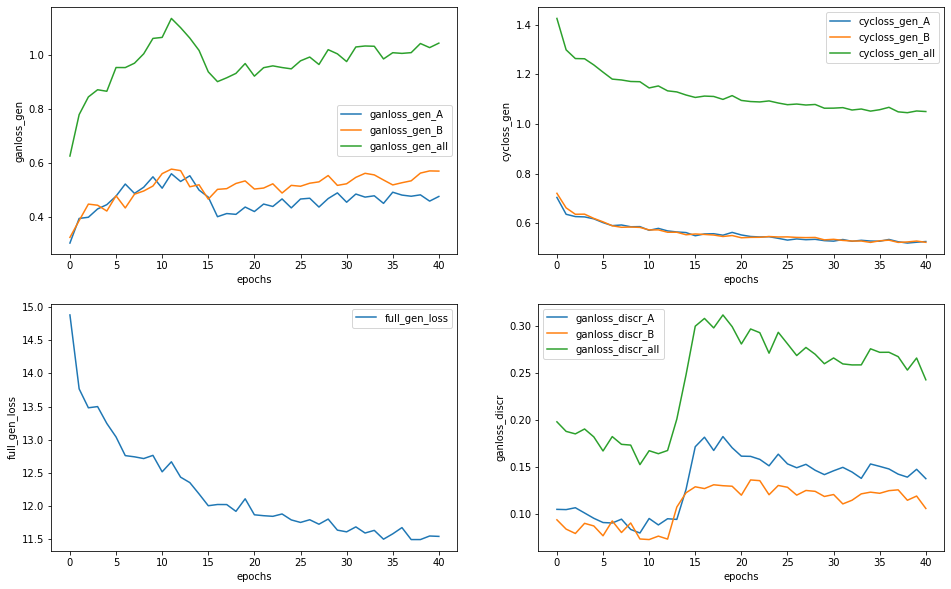

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


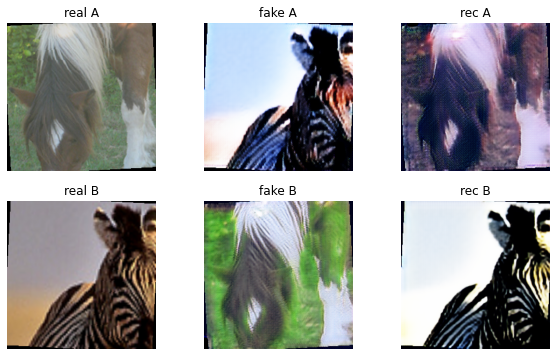

Epoch:  20%|██        | 41/200 [12:34:04<48:45:22, 1103.92s/it]

Epoch:  20%|██        | 41/200 [12:52:19<48:45:22, 1103.92s/it]



Generator metrics:
ganloss_gen_A: 0.4776335801
ganloss_gen_B: 0.5553068411
ganloss_gen_all: 1.0329404221
cycloss_gen_A: 0.5204698792
cycloss_gen_B: 0.5233028882
cycloss_gen_all: 1.0437727693
full_gen_loss: 11.4706680993

Discriminator metrics: 
ganloss_discr_A: 0.1316390855
ganloss_discr_B: 0.1142451327
ganloss_discr_all: 0.2458842185

lr: 0.0002


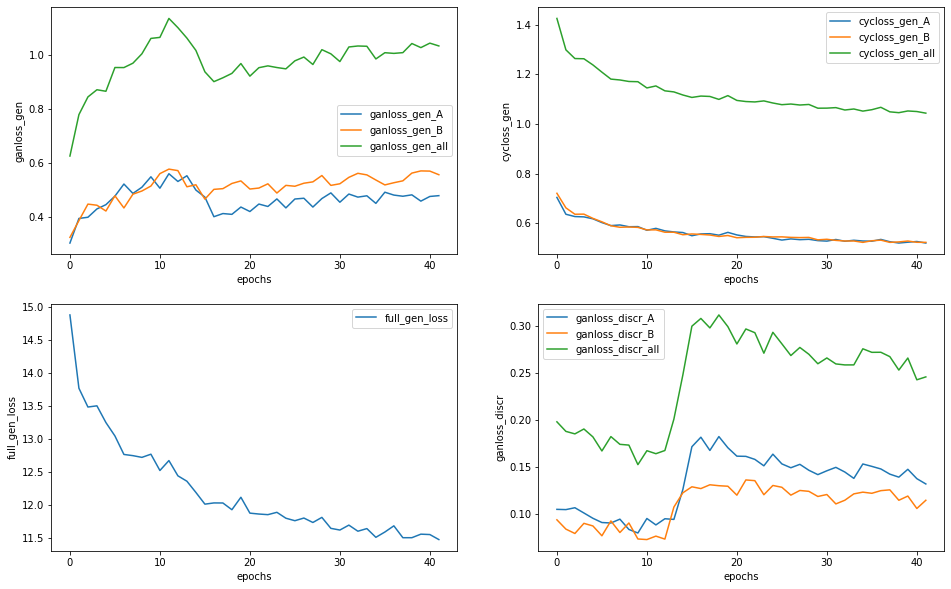

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


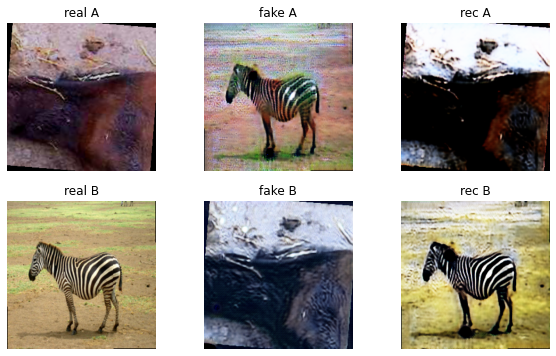

Epoch:  21%|██        | 42/200 [12:52:29<48:27:23, 1104.07s/it]

Epoch:  21%|██        | 42/200 [13:10:43<48:27:23, 1104.07s/it]



Generator metrics:
ganloss_gen_A: 0.4944290599
ganloss_gen_B: 0.5891745380
ganloss_gen_all: 1.0836035987
cycloss_gen_A: 0.5195474778
cycloss_gen_B: 0.5251051098
cycloss_gen_all: 1.0446525891
full_gen_loss: 11.5301294677

Discriminator metrics: 
ganloss_discr_A: 0.1348191153
ganloss_discr_B: 0.1036900432
ganloss_discr_all: 0.2385091580

lr: 0.0002


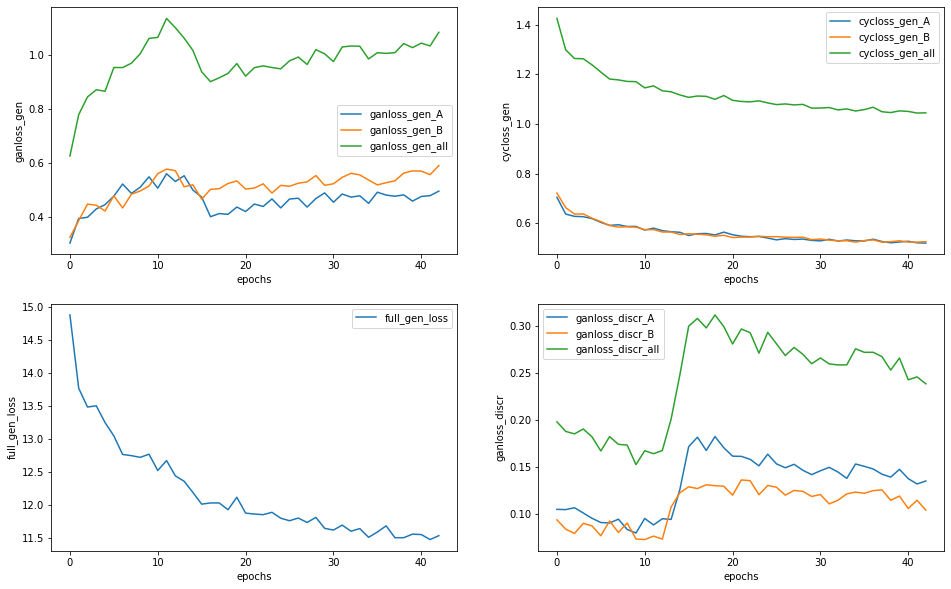

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


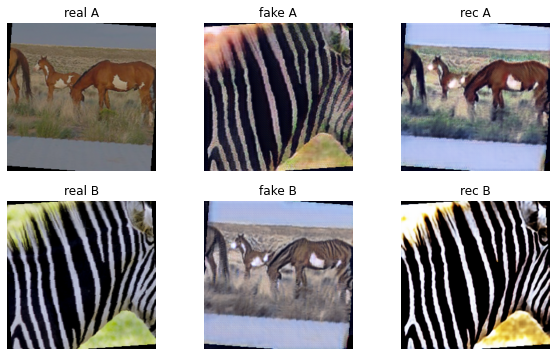

Epoch:  22%|██▏       | 43/200 [13:10:53<48:09:13, 1104.16s/it]

Epoch:  22%|██▏       | 43/200 [13:29:07<48:09:13, 1104.16s/it]



Generator metrics:
ganloss_gen_A: 0.5022850301
ganloss_gen_B: 0.5856649519
ganloss_gen_all: 1.0879499832
cycloss_gen_A: 0.5161448236
cycloss_gen_B: 0.5245911052
cycloss_gen_all: 1.0407359302
full_gen_loss: 11.4953092939

Discriminator metrics: 
ganloss_discr_A: 0.1311383962
ganloss_discr_B: 0.1169968963
ganloss_discr_all: 0.2481352926

lr: 0.0002


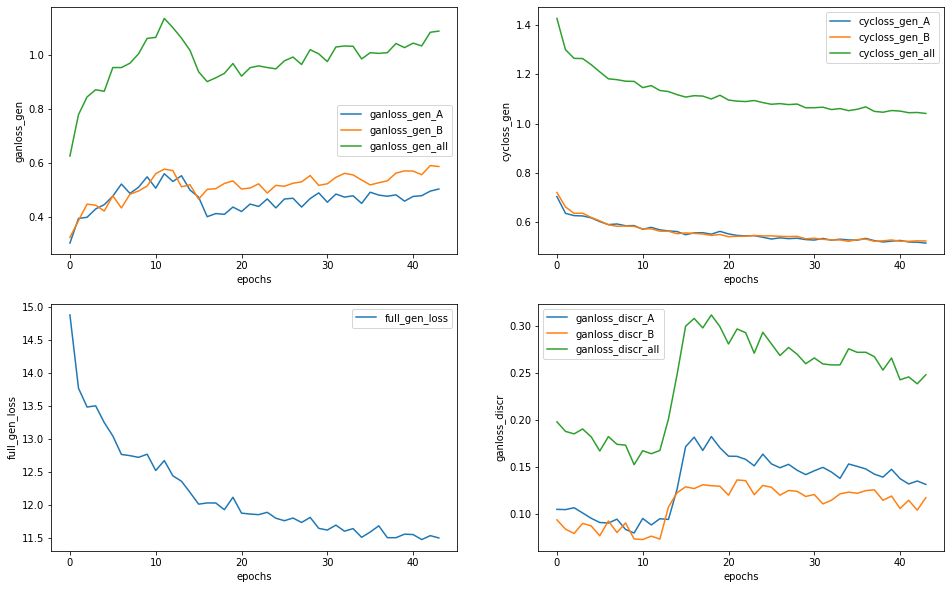

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


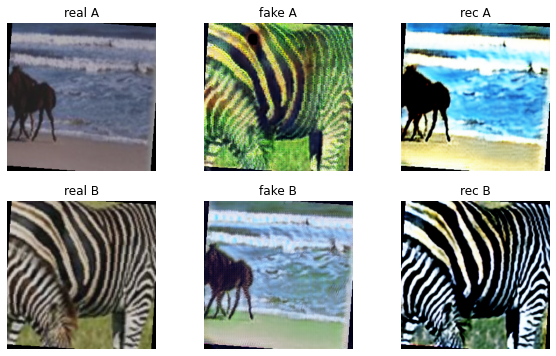

Epoch:  22%|██▏       | 44/200 [13:29:17<47:50:26, 1104.02s/it]

Epoch:  22%|██▏       | 44/200 [13:47:31<47:50:26, 1104.02s/it]



Generator metrics:
ganloss_gen_A: 0.4954881916
ganloss_gen_B: 0.6094204056
ganloss_gen_all: 1.1049085978
cycloss_gen_A: 0.5272865640
cycloss_gen_B: 0.5258277465
cycloss_gen_all: 1.0531143123
full_gen_loss: 11.6360517131

Discriminator metrics: 
ganloss_discr_A: 0.1273289861
ganloss_discr_B: 0.0970414733
ganloss_discr_all: 0.2243704594

lr: 0.0002


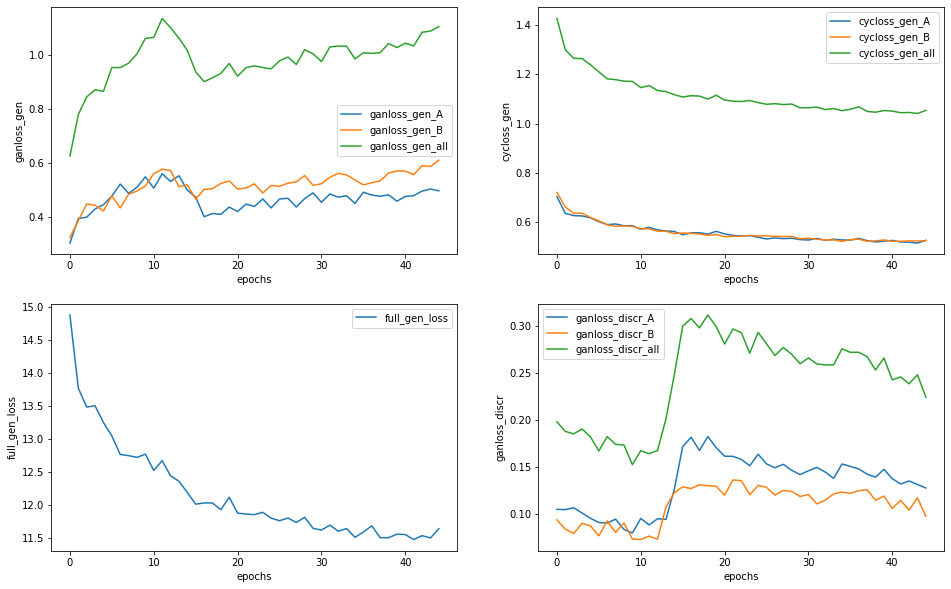

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


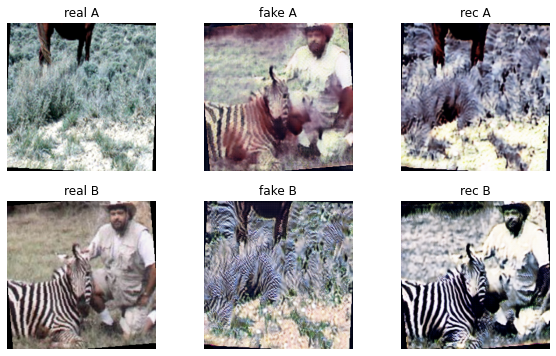

Epoch:  22%|██▎       | 45/200 [13:47:41<47:31:54, 1103.96s/it]

Epoch:  22%|██▎       | 45/200 [14:05:55<47:31:54, 1103.96s/it]



Generator metrics:
ganloss_gen_A: 0.4873244049
ganloss_gen_B: 0.5731170489
ganloss_gen_all: 1.0604414539
cycloss_gen_A: 0.5278192521
cycloss_gen_B: 0.5199134332
cycloss_gen_all: 1.0477326875
full_gen_loss: 11.5377683357

Discriminator metrics: 
ganloss_discr_A: 0.1310133552
ganloss_discr_B: 0.1026376282
ganloss_discr_all: 0.2336509838

lr: 0.0002


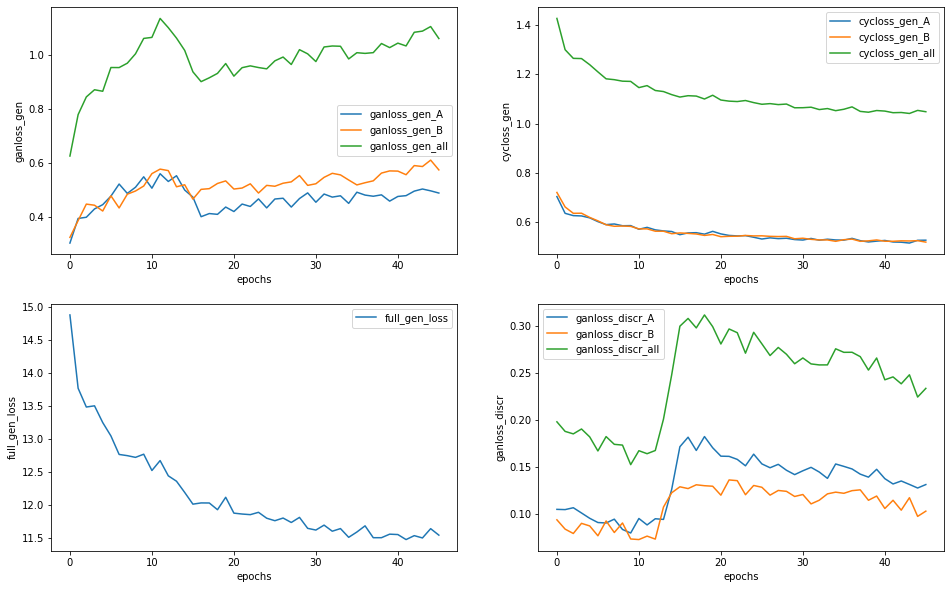

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


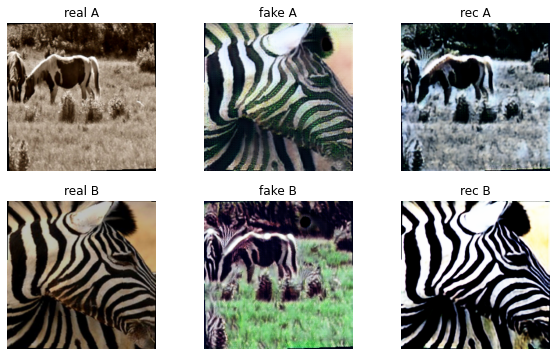

Epoch:  23%|██▎       | 46/200 [14:06:04<47:13:01, 1103.78s/it]

Epoch:  23%|██▎       | 46/200 [14:24:18<47:13:01, 1103.78s/it]



Generator metrics:
ganloss_gen_A: 0.4985957826
ganloss_gen_B: 0.5635961268
ganloss_gen_all: 1.0621919090
cycloss_gen_A: 0.5143607525
cycloss_gen_B: 0.5197913708
cycloss_gen_all: 1.0341521259
full_gen_loss: 11.4037131566

Discriminator metrics: 
ganloss_discr_A: 0.1271150257
ganloss_discr_B: 0.1176691634
ganloss_discr_all: 0.2447841889

lr: 0.0002


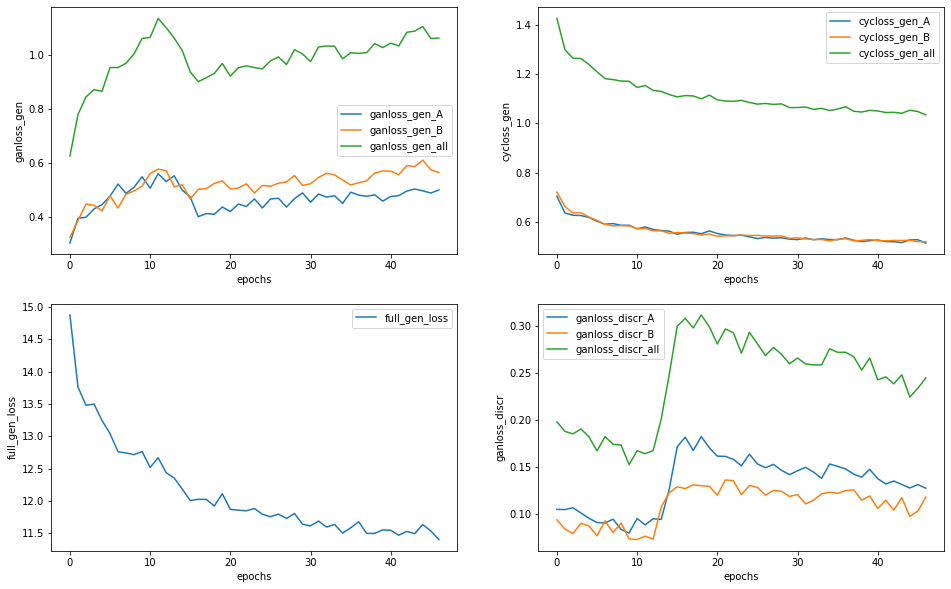

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


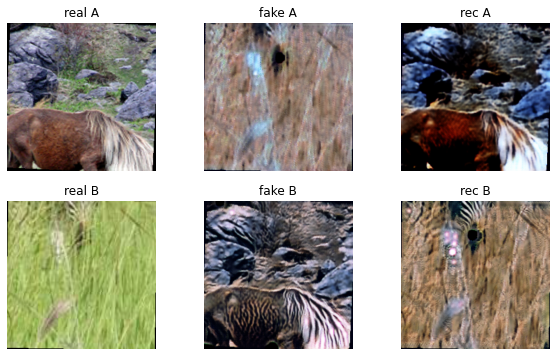

Epoch:  24%|██▎       | 47/200 [14:24:29<46:55:44, 1104.22s/it]

Epoch:  24%|██▎       | 47/200 [14:42:44<46:55:44, 1104.22s/it]



Generator metrics:
ganloss_gen_A: 0.5515422568
ganloss_gen_B: 0.5601764837
ganloss_gen_all: 1.1117187398
cycloss_gen_A: 0.5210905031
cycloss_gen_B: 0.5202553786
cycloss_gen_all: 1.0413458833
full_gen_loss: 11.5251775860

Discriminator metrics: 
ganloss_discr_A: 0.1132659876
ganloss_discr_B: 0.1136301690
ganloss_discr_all: 0.2268961562

lr: 0.0002


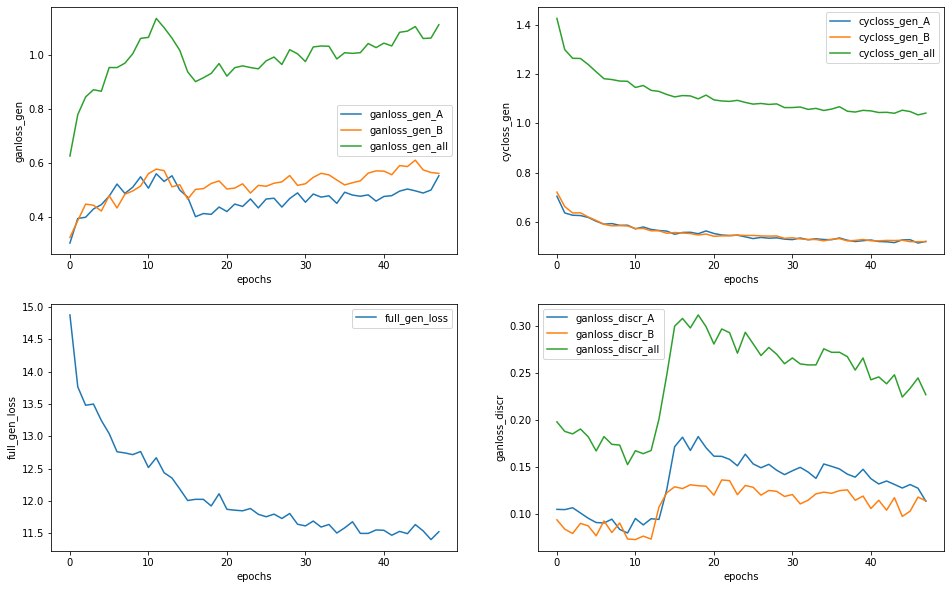

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


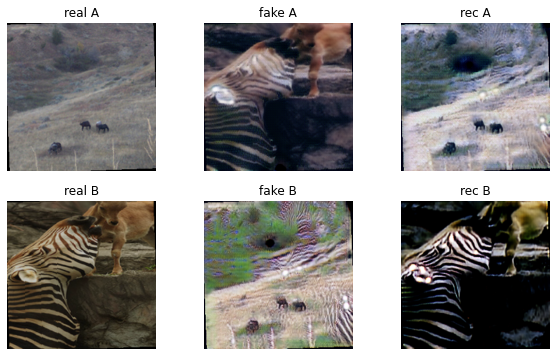

Epoch:  24%|██▍       | 48/200 [14:42:53<46:37:12, 1104.16s/it]

Epoch:  24%|██▍       | 48/200 [15:01:08<46:37:12, 1104.16s/it]



Generator metrics:
ganloss_gen_A: 0.5112748842
ganloss_gen_B: 0.5692223499
ganloss_gen_all: 1.0804972325
cycloss_gen_A: 0.5193353251
cycloss_gen_B: 0.5155180384
cycloss_gen_all: 1.0348533664
full_gen_loss: 11.4290309092

Discriminator metrics: 
ganloss_discr_A: 0.1204674757
ganloss_discr_B: 0.1032950633
ganloss_discr_all: 0.2237625391

lr: 0.0002


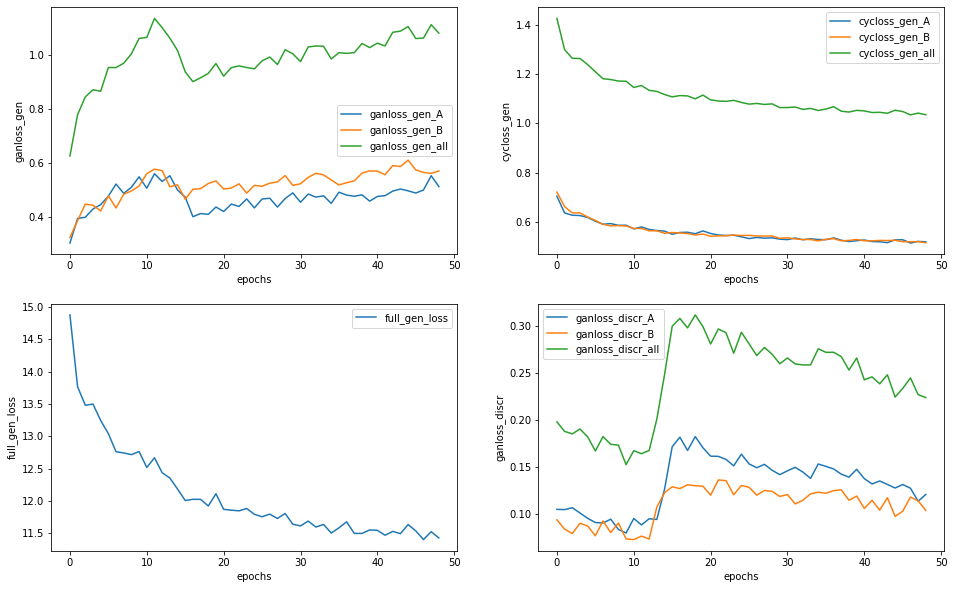

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


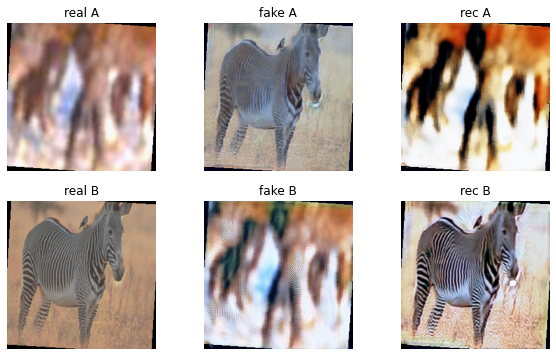

Epoch:  24%|██▍       | 49/200 [15:01:18<46:19:12, 1104.32s/it]

Epoch:  24%|██▍       | 49/200 [15:19:33<46:19:12, 1104.32s/it]



Generator metrics:
ganloss_gen_A: 0.5352910379
ganloss_gen_B: 0.5779138057
ganloss_gen_all: 1.1132048442
cycloss_gen_A: 0.5036711288
cycloss_gen_B: 0.5137612094
cycloss_gen_all: 1.0174323406
full_gen_loss: 11.2875282486

Discriminator metrics: 
ganloss_discr_A: 0.1148217381
ganloss_discr_B: 0.1025367150
ganloss_discr_all: 0.2173584530

lr: 0.0002


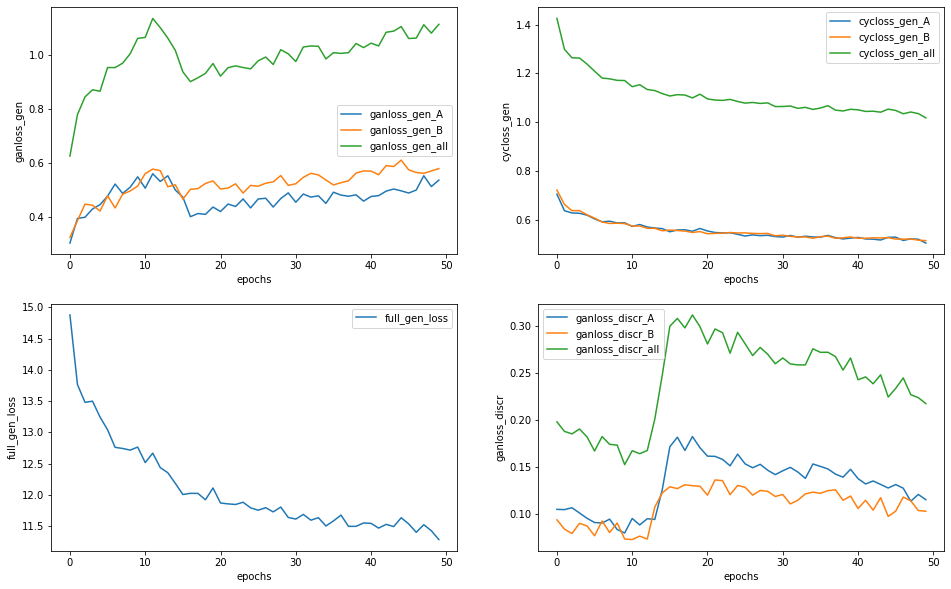

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


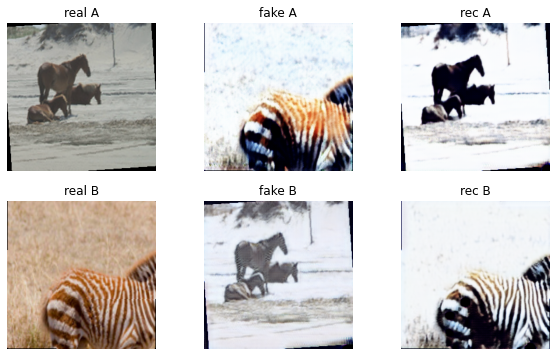

Epoch:  25%|██▌       | 50/200 [15:19:43<46:01:05, 1104.44s/it]

Epoch:  25%|██▌       | 50/200 [15:37:57<46:01:05, 1104.44s/it]



Generator metrics:
ganloss_gen_A: 0.5344661780
ganloss_gen_B: 0.5775836803
ganloss_gen_all: 1.1120498590
cycloss_gen_A: 0.5059908511
cycloss_gen_B: 0.5187353160
cycloss_gen_all: 1.0247261700
full_gen_loss: 11.3593115592

Discriminator metrics: 
ganloss_discr_A: 0.1215716230
ganloss_discr_B: 0.1152836048
ganloss_discr_all: 0.2368552278

lr: 0.0002


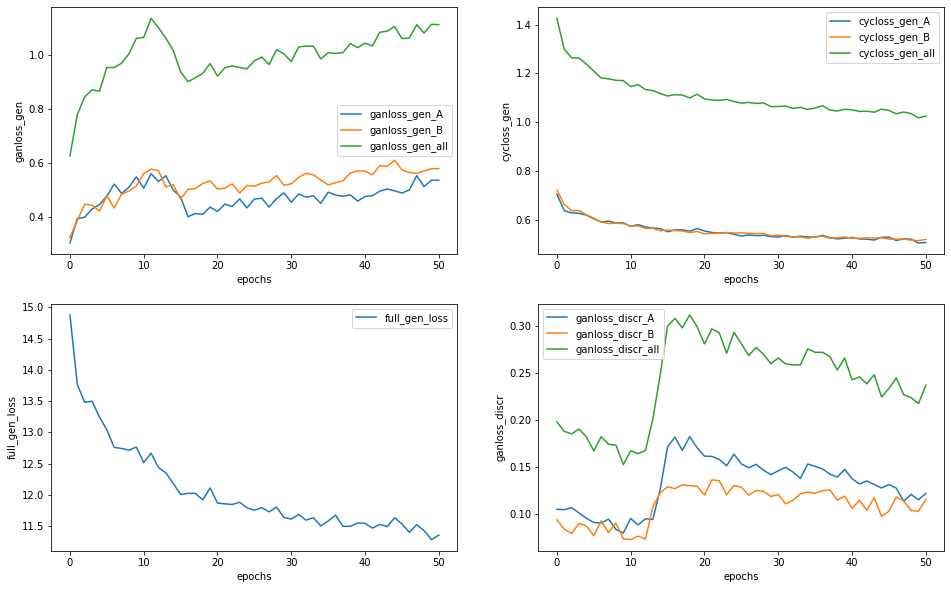

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


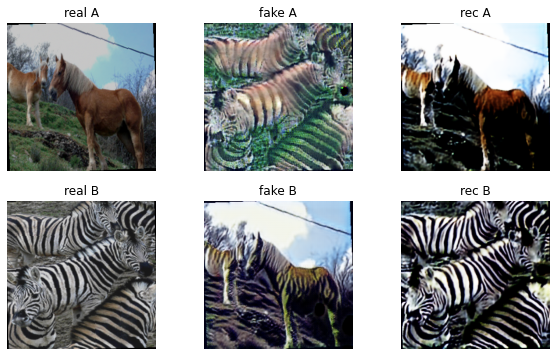

Epoch:  26%|██▌       | 51/200 [15:38:07<45:42:39, 1104.42s/it]

Epoch:  26%|██▌       | 51/200 [15:56:21<45:42:39, 1104.42s/it]



Generator metrics:
ganloss_gen_A: 0.5326162345
ganloss_gen_B: 0.5979916913
ganloss_gen_all: 1.1306079249
cycloss_gen_A: 0.5186757012
cycloss_gen_B: 0.5149259273
cycloss_gen_all: 1.0336016316
full_gen_loss: 11.4666242507

Discriminator metrics: 
ganloss_discr_A: 0.1161908591
ganloss_discr_B: 0.1080243961
ganloss_discr_all: 0.2242152554

lr: 0.0002


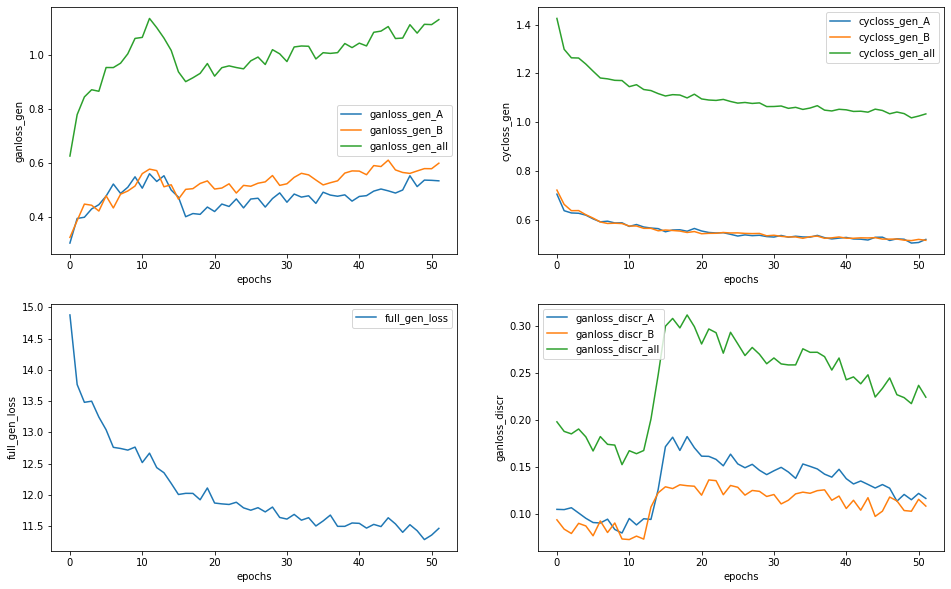

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


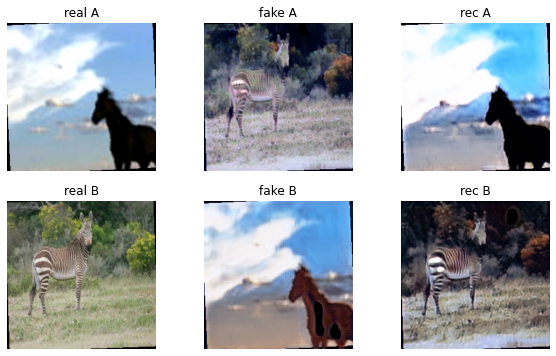

Epoch:  26%|██▌       | 52/200 [15:56:33<45:25:11, 1104.80s/it]

Epoch:  26%|██▌       | 52/200 [16:14:48<45:25:11, 1104.80s/it]



Generator metrics:
ganloss_gen_A: 0.5673764787
ganloss_gen_B: 0.6097242775
ganloss_gen_all: 1.1771007549
cycloss_gen_A: 0.5181639879
cycloss_gen_B: 0.5146023584
cycloss_gen_all: 1.0327663480
full_gen_loss: 11.5047642341

Discriminator metrics: 
ganloss_discr_A: 0.1072027933
ganloss_discr_B: 0.1024899429
ganloss_discr_all: 0.2096927361

lr: 0.0002


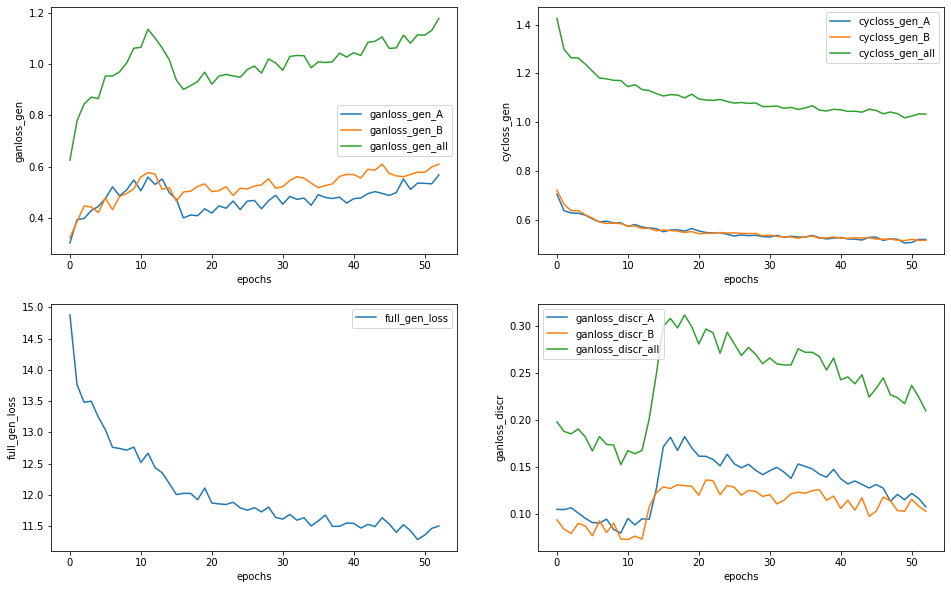

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


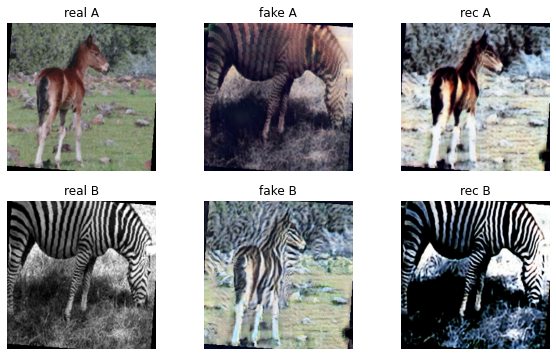

Epoch:  26%|██▋       | 53/200 [16:14:58<45:06:54, 1104.86s/it]

Epoch:  26%|██▋       | 53/200 [16:33:12<45:06:54, 1104.86s/it]



Generator metrics:
ganloss_gen_A: 0.5307867208
ganloss_gen_B: 0.6554765012
ganloss_gen_all: 1.1862632213
cycloss_gen_A: 0.5213428991
cycloss_gen_B: 0.5147700119
cycloss_gen_all: 1.0361129126
full_gen_loss: 11.5473923605

Discriminator metrics: 
ganloss_discr_A: 0.1178655761
ganloss_discr_B: 0.0838301805
ganloss_discr_all: 0.2016957564

lr: 0.0002


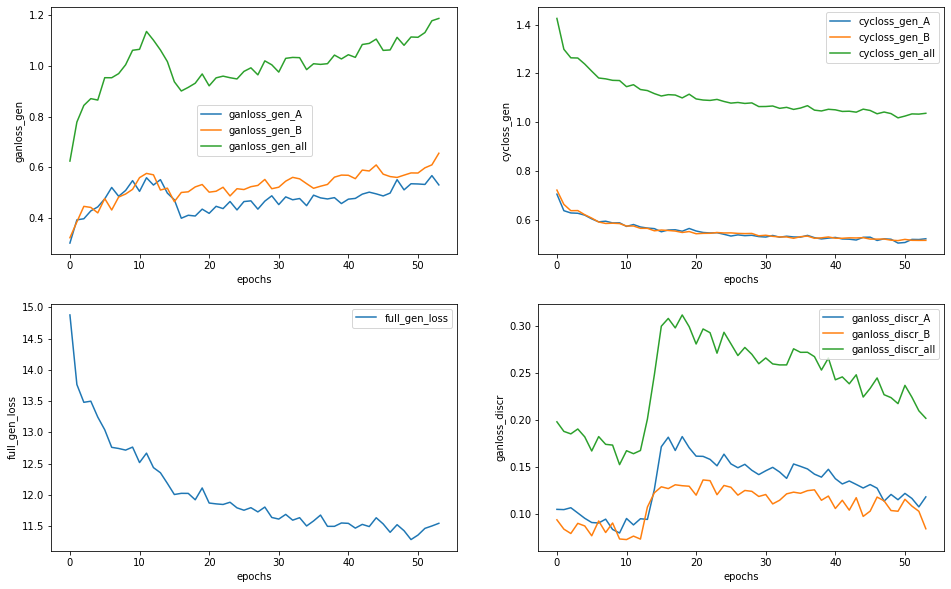

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


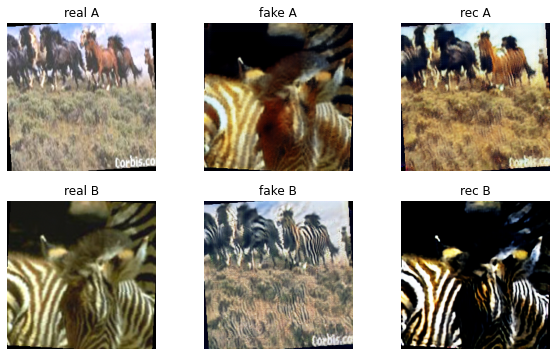

Epoch:  27%|██▋       | 54/200 [16:33:22<44:48:25, 1104.84s/it]

Epoch:  27%|██▋       | 54/200 [16:51:37<44:48:25, 1104.84s/it]



Generator metrics:
ganloss_gen_A: 0.5595049260
ganloss_gen_B: 0.5755261181
ganloss_gen_all: 1.1350310432
cycloss_gen_A: 0.5147965905
cycloss_gen_B: 0.5188077805
cycloss_gen_all: 1.0336043731
full_gen_loss: 11.4710747602

Discriminator metrics: 
ganloss_discr_A: 0.1050507718
ganloss_discr_B: 0.1144391374
ganloss_discr_all: 0.2194899093

lr: 0.0002


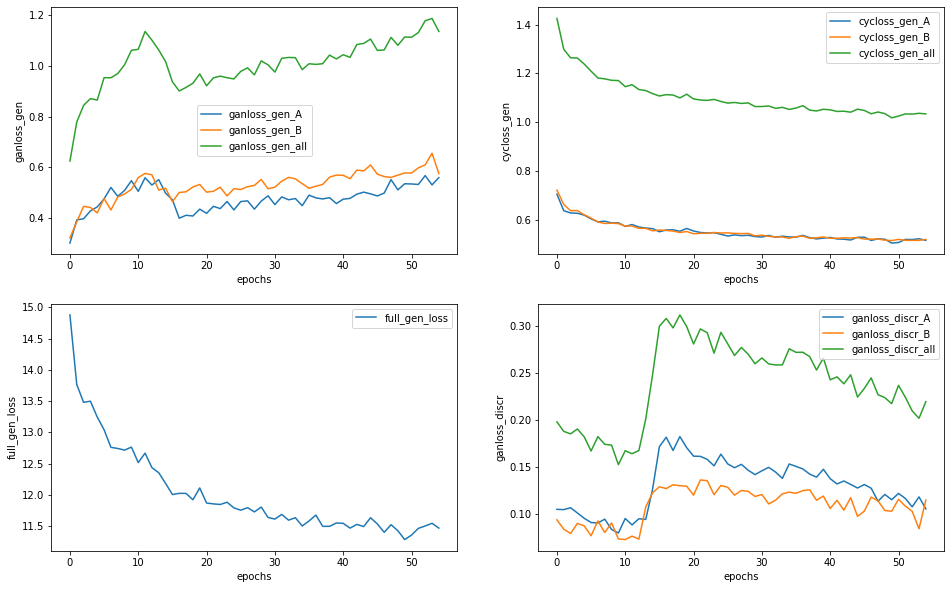

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


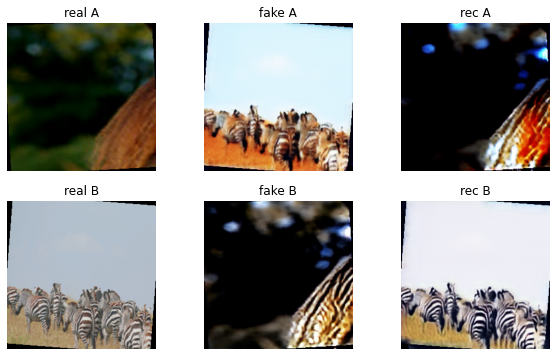

Epoch:  28%|██▊       | 55/200 [16:51:47<44:29:31, 1104.63s/it]

Epoch:  28%|██▊       | 55/200 [17:10:02<44:29:31, 1104.63s/it]



Generator metrics:
ganloss_gen_A: 0.5603657766
ganloss_gen_B: 0.5897792670
ganloss_gen_all: 1.1501450445
cycloss_gen_A: 0.5139308727
cycloss_gen_B: 0.5232608182
cycloss_gen_all: 1.0371916921
full_gen_loss: 11.5220619621

Discriminator metrics: 
ganloss_discr_A: 0.1124667793
ganloss_discr_B: 0.1023645061
ganloss_discr_all: 0.2148312848

lr: 0.0002


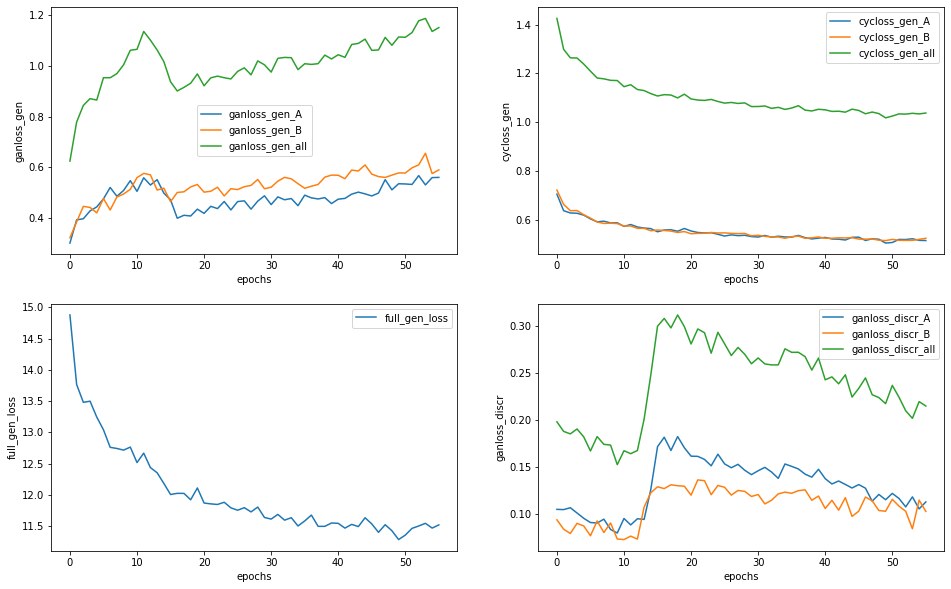

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


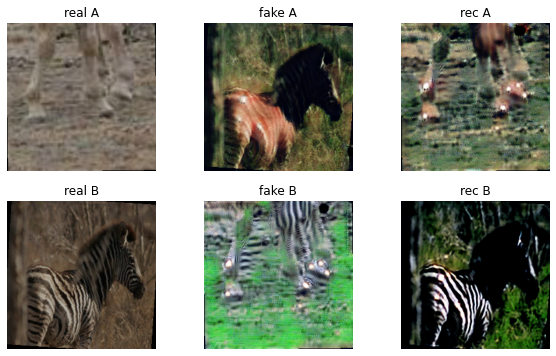

Epoch:  28%|██▊       | 56/200 [17:10:13<44:12:13, 1105.10s/it]

Epoch:  28%|██▊       | 56/200 [17:28:27<44:12:13, 1105.10s/it]



Generator metrics:
ganloss_gen_A: 0.5755597802
ganloss_gen_B: 0.5851259591
ganloss_gen_all: 1.1606857397
cycloss_gen_A: 0.5124046178
cycloss_gen_B: 0.5181703180
cycloss_gen_all: 1.0305749374
full_gen_loss: 11.4664351150

Discriminator metrics: 
ganloss_discr_A: 0.0987554271
ganloss_discr_B: 0.1079298390
ganloss_discr_all: 0.2066852659

lr: 0.0002


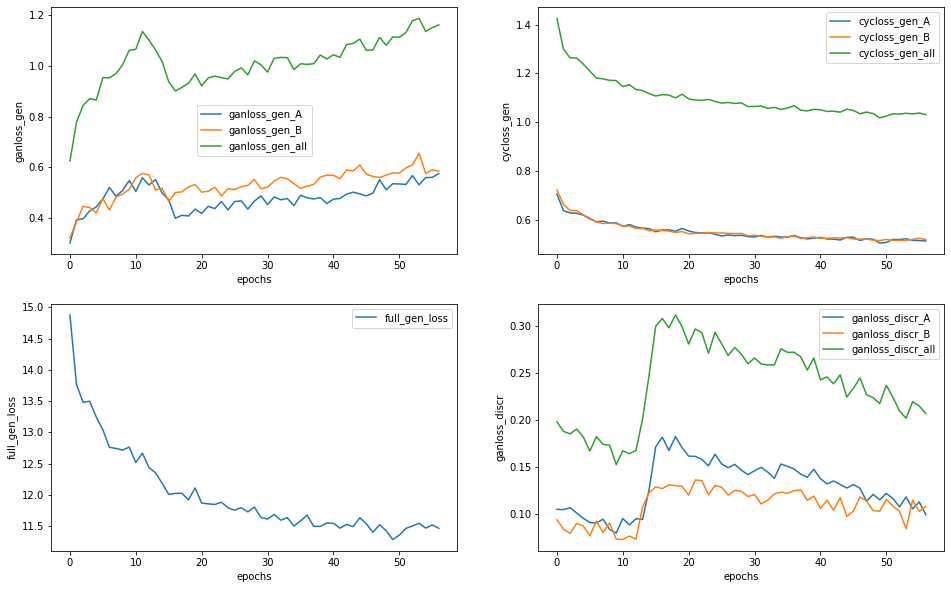

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


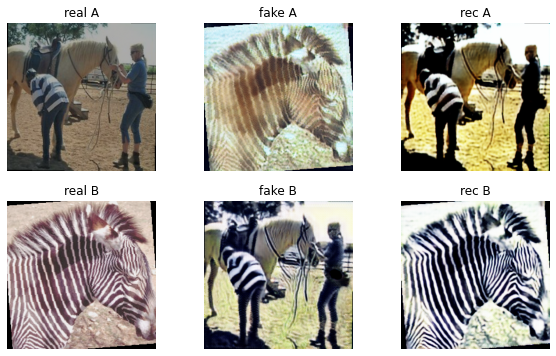

Epoch:  28%|██▊       | 57/200 [17:28:37<43:53:31, 1104.97s/it]

Epoch:  28%|██▊       | 57/200 [17:46:52<43:53:31, 1104.97s/it]



Generator metrics:
ganloss_gen_A: 0.5661471682
ganloss_gen_B: 0.5867531699
ganloss_gen_all: 1.1529003381
cycloss_gen_A: 0.5058831487
cycloss_gen_B: 0.5143682366
cycloss_gen_all: 1.0202513873
full_gen_loss: 11.3554141950

Discriminator metrics: 
ganloss_discr_A: 0.1139937884
ganloss_discr_B: 0.1030893740
ganloss_discr_all: 0.2170831624

lr: 0.0002


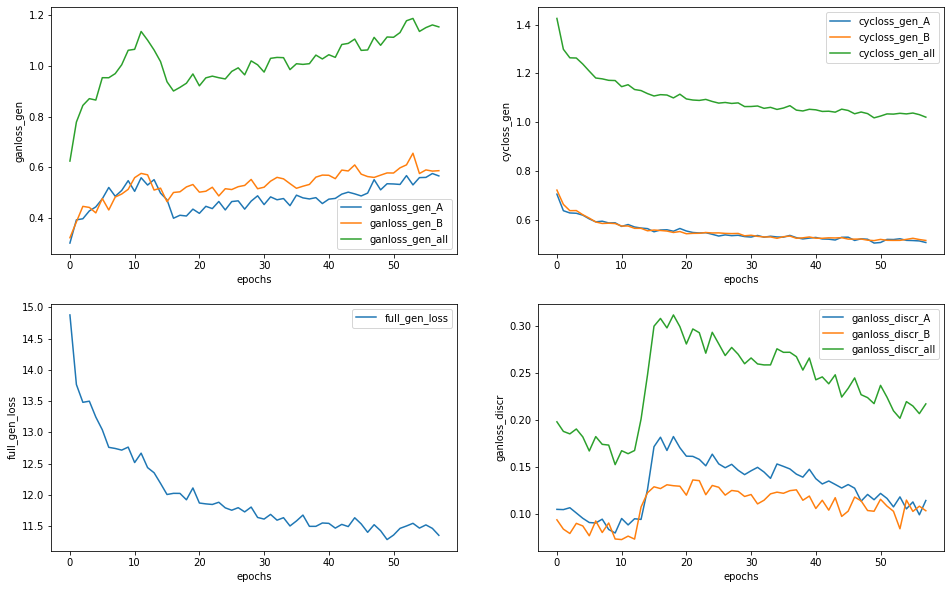

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


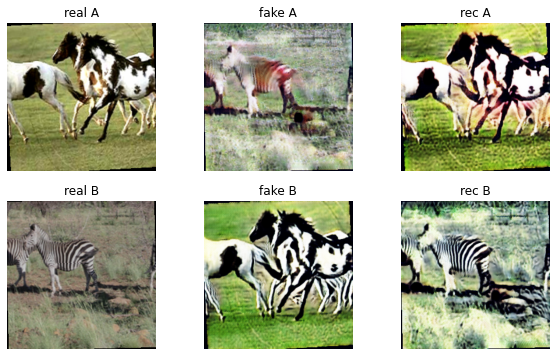

Epoch:  29%|██▉       | 58/200 [17:47:03<43:35:15, 1105.04s/it]

Epoch:  29%|██▉       | 58/200 [18:05:18<43:35:15, 1105.04s/it]



Generator metrics:
ganloss_gen_A: 0.5780646411
ganloss_gen_B: 0.6089151007
ganloss_gen_all: 1.1869797407
cycloss_gen_A: 0.5086589841
cycloss_gen_B: 0.5118357387
cycloss_gen_all: 1.0204947247
full_gen_loss: 11.3919269964

Discriminator metrics: 
ganloss_discr_A: 0.1026854652
ganloss_discr_B: 0.0975020807
ganloss_discr_all: 0.2001875456

lr: 0.0002


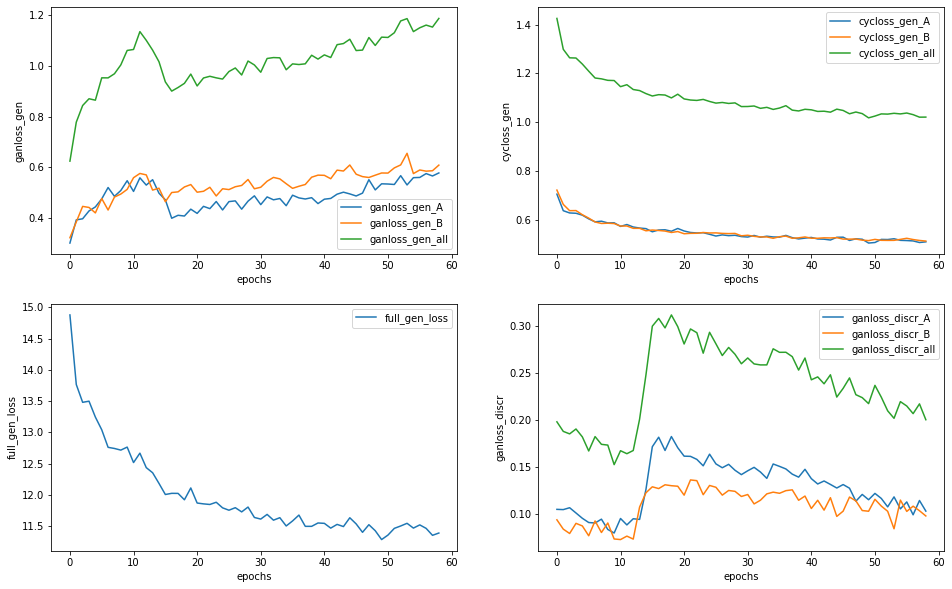

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


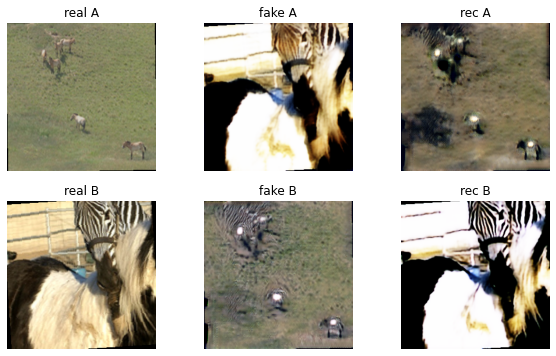

Epoch:  30%|██▉       | 59/200 [18:05:29<43:18:05, 1105.57s/it]

Epoch:  30%|██▉       | 59/200 [18:23:44<43:18:05, 1105.57s/it]



Generator metrics:
ganloss_gen_A: 0.6192722642
ganloss_gen_B: 0.5908577234
ganloss_gen_all: 1.2101299869
cycloss_gen_A: 0.5192235759
cycloss_gen_B: 0.5210672848
cycloss_gen_all: 1.0402908645
full_gen_loss: 11.6130386325

Discriminator metrics: 
ganloss_discr_A: 0.1030624169
ganloss_discr_B: 0.0999567682
ganloss_discr_all: 0.2030191851

lr: 0.0002


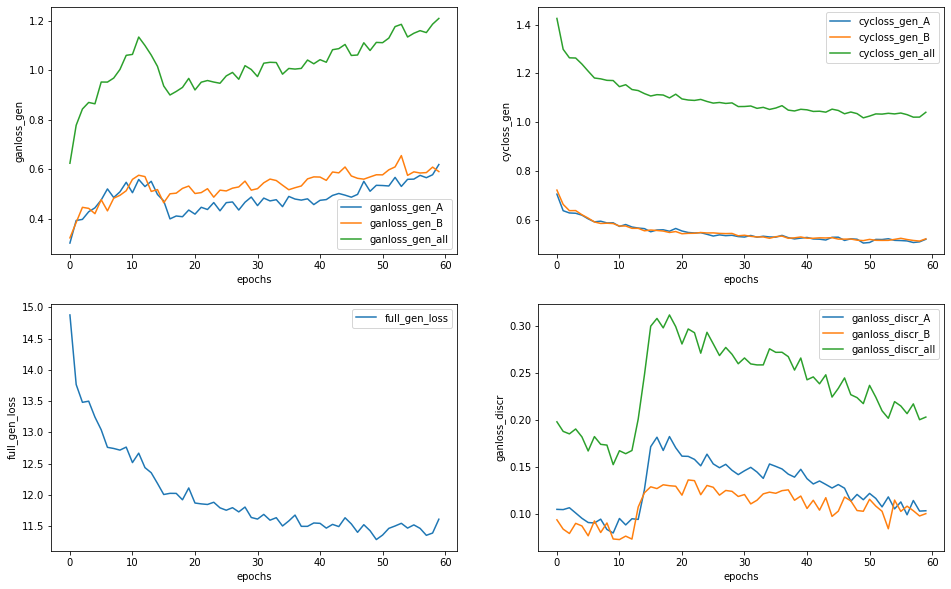

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


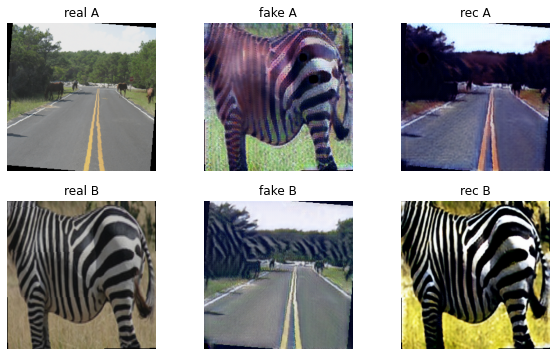

Epoch:  30%|███       | 60/200 [18:23:55<42:59:37, 1105.56s/it]

Epoch:  30%|███       | 60/200 [18:42:10<42:59:37, 1105.56s/it]



Generator metrics:
ganloss_gen_A: 0.5837759508
ganloss_gen_B: 0.6090850011
ganloss_gen_all: 1.1928609514
cycloss_gen_A: 0.5026453636
cycloss_gen_B: 0.5086276749
cycloss_gen_all: 1.0112730420
full_gen_loss: 11.3055913795

Discriminator metrics: 
ganloss_discr_A: 0.1111688731
ganloss_discr_B: 0.1010092566
ganloss_discr_all: 0.2121781299

lr: 0.0002


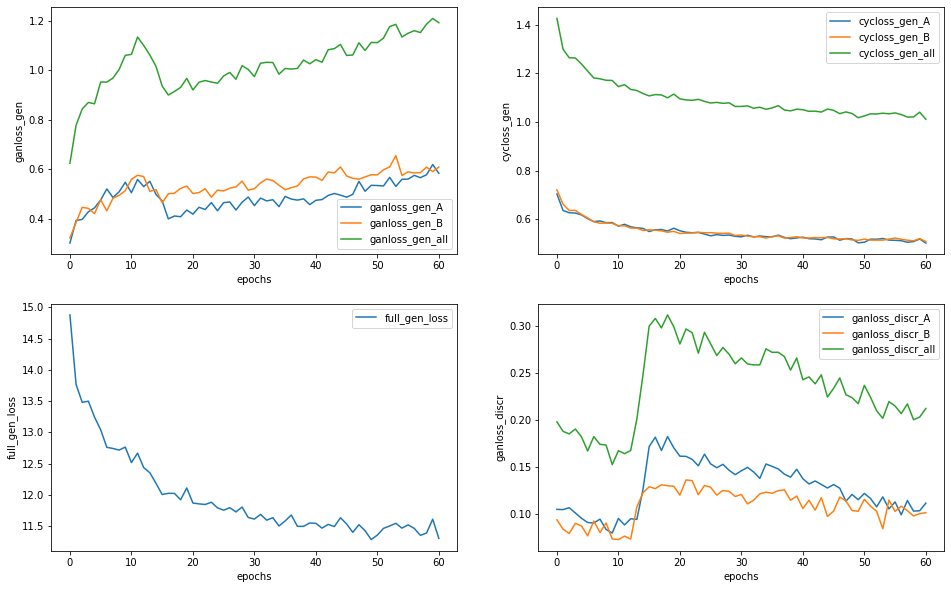

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


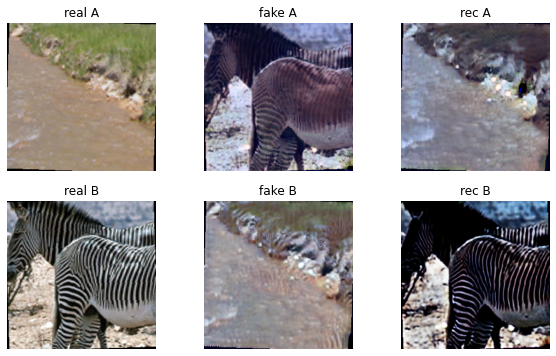

Epoch:  30%|███       | 61/200 [18:42:21<42:41:30, 1105.68s/it]

Epoch:  30%|███       | 61/200 [19:00:36<42:41:30, 1105.68s/it]



Generator metrics:
ganloss_gen_A: 0.5737996255
ganloss_gen_B: 0.6044548534
ganloss_gen_all: 1.1782544795
cycloss_gen_A: 0.5141634342
cycloss_gen_B: 0.5072095834
cycloss_gen_all: 1.0213730186
full_gen_loss: 11.3919846740

Discriminator metrics: 
ganloss_discr_A: 0.1004278362
ganloss_discr_B: 0.1018099695
ganloss_discr_all: 0.2022378056

lr: 0.0002


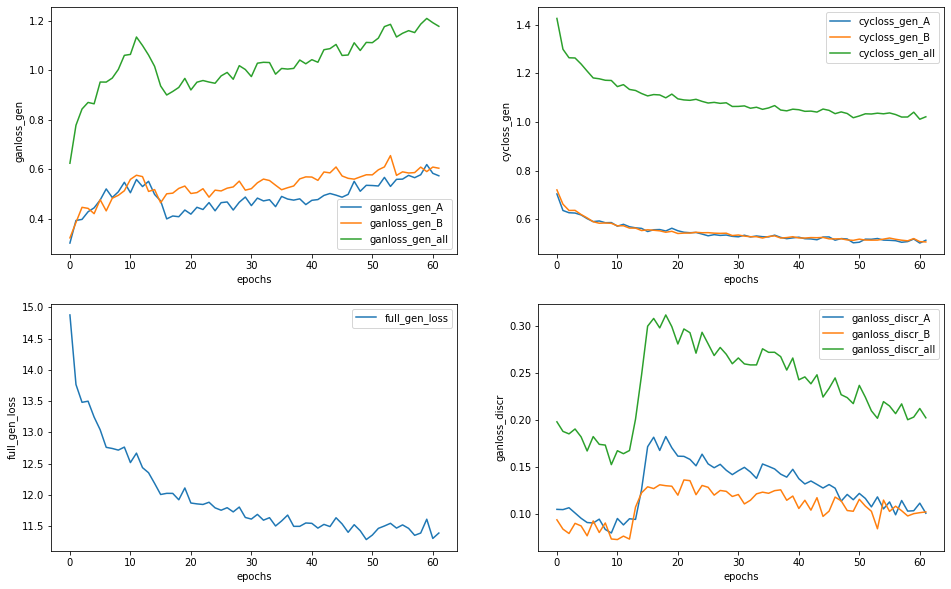

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


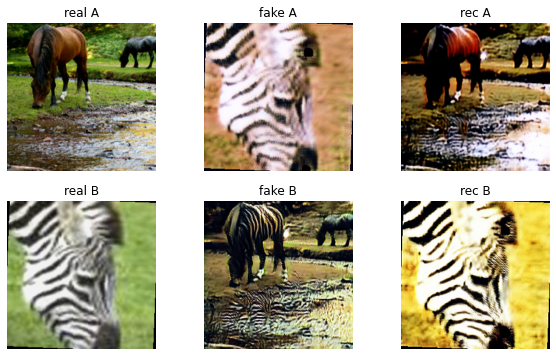

Epoch:  31%|███       | 62/200 [19:00:46<42:22:51, 1105.59s/it]

Epoch:  31%|███       | 62/200 [19:19:01<42:22:51, 1105.59s/it]



Generator metrics:
ganloss_gen_A: 0.6228884330
ganloss_gen_B: 0.5846187016
ganloss_gen_all: 1.2075071343
cycloss_gen_A: 0.5129761850
cycloss_gen_B: 0.5097629967
cycloss_gen_all: 1.0227391833
full_gen_loss: 11.4348989487

Discriminator metrics: 
ganloss_discr_A: 0.1015320426
ganloss_discr_B: 0.1023404303
ganloss_discr_all: 0.2038724729

lr: 0.0002


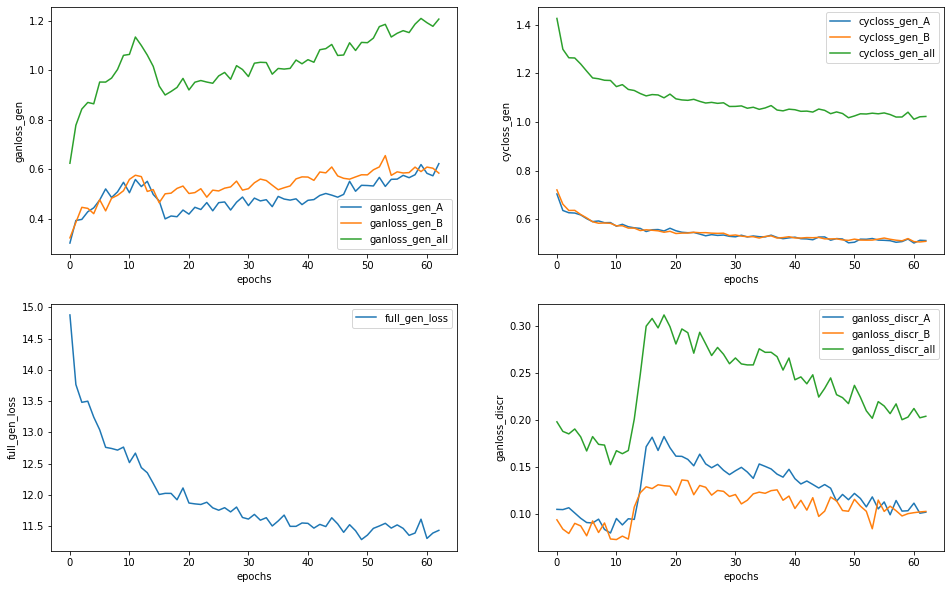

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


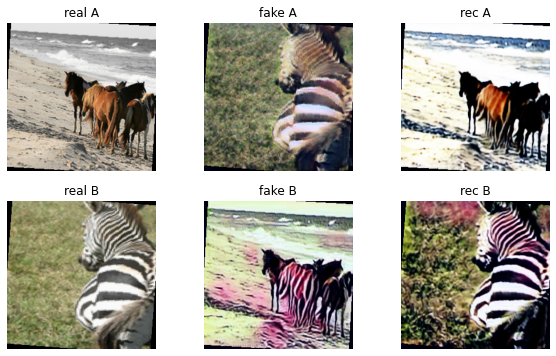

Epoch:  32%|███▏      | 63/200 [19:19:12<42:04:18, 1105.54s/it]

Epoch:  32%|███▏      | 63/200 [19:37:27<42:04:18, 1105.54s/it]



Generator metrics:
ganloss_gen_A: 0.6009910330
ganloss_gen_B: 0.6181953225
ganloss_gen_all: 1.2191863555
cycloss_gen_A: 0.5025602855
cycloss_gen_B: 0.5097085478
cycloss_gen_all: 1.0122688356
full_gen_loss: 11.3418747217

Discriminator metrics: 
ganloss_discr_A: 0.1069607765
ganloss_discr_B: 0.0939309167
ganloss_discr_all: 0.2008916931

lr: 0.0002


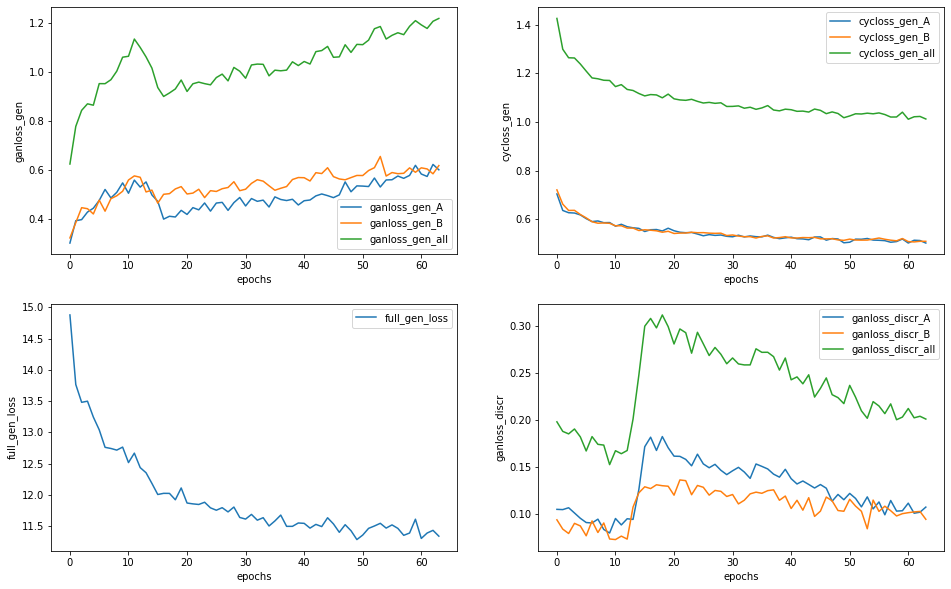

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


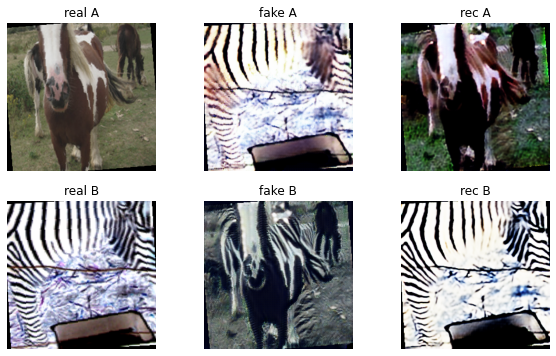

Epoch:  32%|███▏      | 64/200 [19:37:37<41:45:34, 1105.40s/it]

Epoch:  32%|███▏      | 64/200 [19:55:51<41:45:34, 1105.40s/it]



Generator metrics:
ganloss_gen_A: 0.5983725220
ganloss_gen_B: 0.6458633432
ganloss_gen_all: 1.2442358638
cycloss_gen_A: 0.5137023569
cycloss_gen_B: 0.5040064167
cycloss_gen_all: 1.0177087751
full_gen_loss: 11.4213236107

Discriminator metrics: 
ganloss_discr_A: 0.1049096919
ganloss_discr_B: 0.0800429572
ganloss_discr_all: 0.1849526494

lr: 0.0002


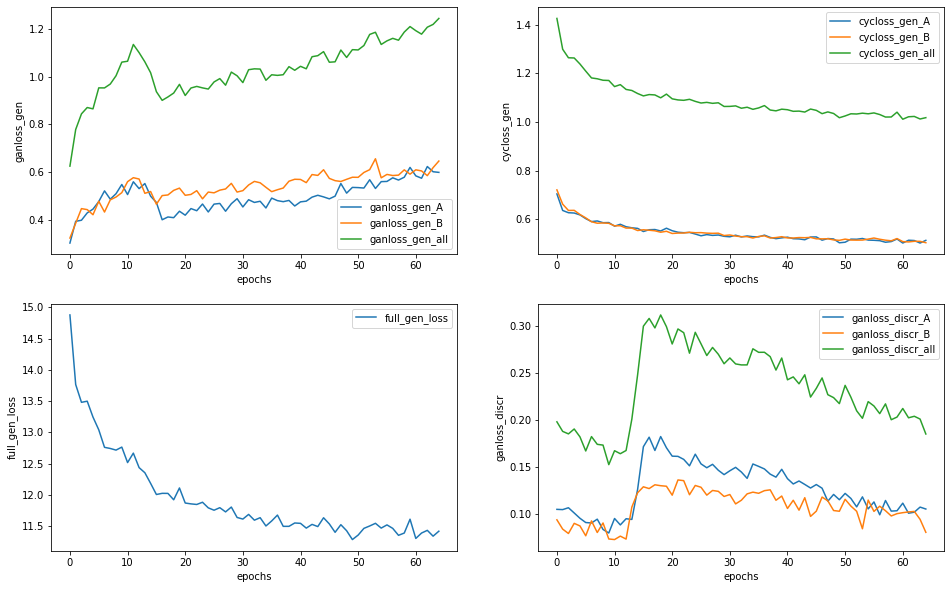

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


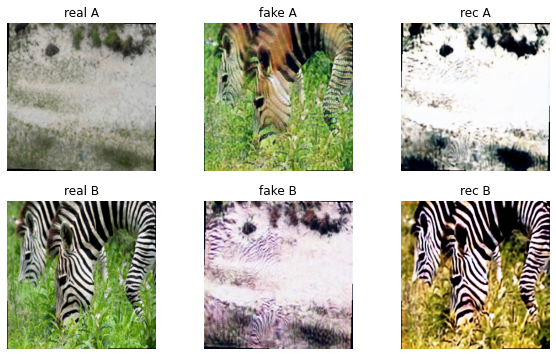

Epoch:  32%|███▎      | 65/200 [19:56:01<41:26:37, 1105.17s/it]

Epoch:  32%|███▎      | 65/200 [20:14:16<41:26:37, 1105.17s/it]



Generator metrics:
ganloss_gen_A: 0.6005284754
ganloss_gen_B: 0.6313790057
ganloss_gen_all: 1.2319074813
cycloss_gen_A: 0.5174772151
cycloss_gen_B: 0.5196339389
cycloss_gen_all: 1.0371111566
full_gen_loss: 11.6030190402

Discriminator metrics: 
ganloss_discr_A: 0.1003445326
ganloss_discr_B: 0.0960862947
ganloss_discr_all: 0.1964308269

lr: 0.0002


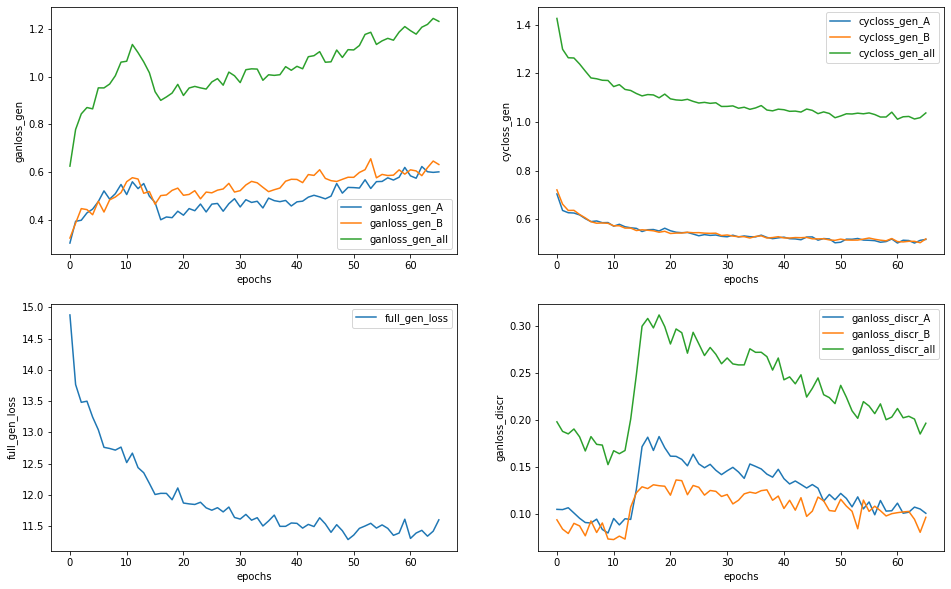

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


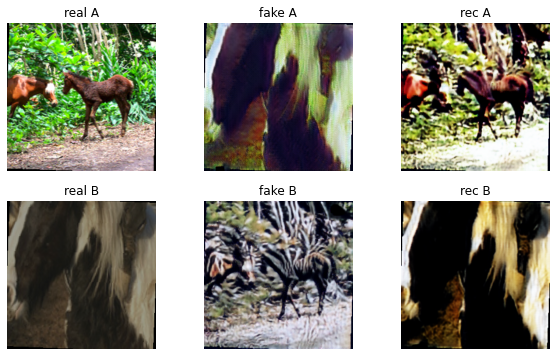

Epoch:  33%|███▎      | 66/200 [20:14:27<41:08:39, 1105.37s/it]

Epoch:  33%|███▎      | 66/200 [20:32:42<41:08:39, 1105.37s/it]



Generator metrics:
ganloss_gen_A: 0.5925090992
ganloss_gen_B: 0.6358328955
ganloss_gen_all: 1.2283419940
cycloss_gen_A: 0.5055669158
cycloss_gen_B: 0.5051816815
cycloss_gen_all: 1.0107486002
full_gen_loss: 11.3358280108

Discriminator metrics: 
ganloss_discr_A: 0.0953317854
ganloss_discr_B: 0.0950047671
ganloss_discr_all: 0.1903365525

lr: 0.0002


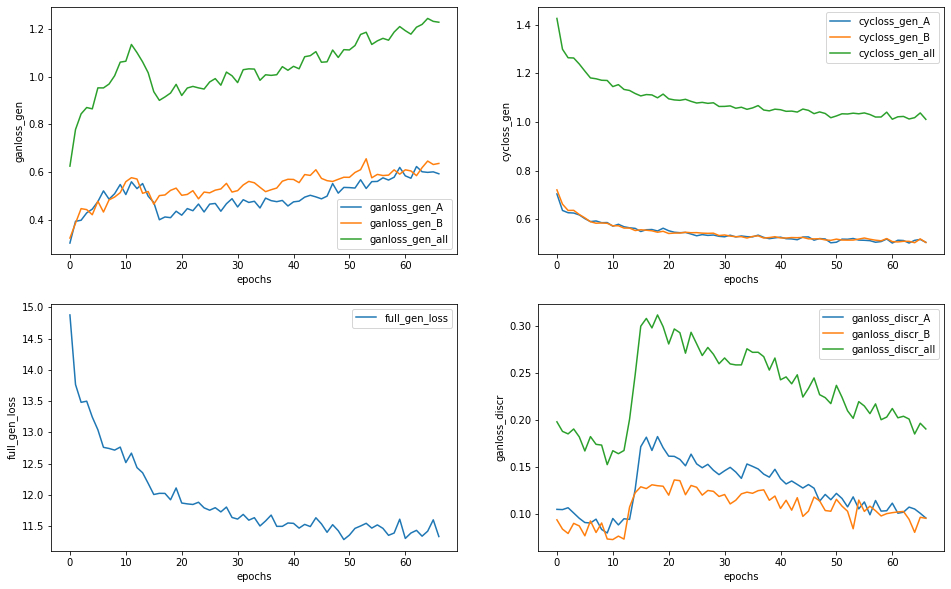

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


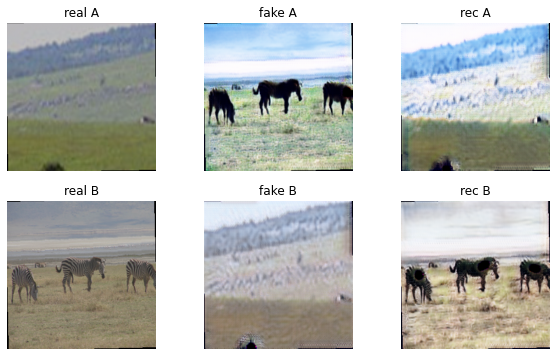

Epoch:  34%|███▎      | 67/200 [20:32:53<40:50:22, 1105.43s/it]

Epoch:  34%|███▎      | 67/200 [20:51:08<40:50:22, 1105.43s/it]



Generator metrics:
ganloss_gen_A: 0.6349962538
ganloss_gen_B: 0.6305730957
ganloss_gen_all: 1.2655693503
cycloss_gen_A: 0.4982292467
cycloss_gen_B: 0.5123099138
cycloss_gen_all: 1.0105391622
full_gen_loss: 11.3709609887

Discriminator metrics: 
ganloss_discr_A: 0.0849492360
ganloss_discr_B: 0.0857692047
ganloss_discr_all: 0.1707184409

lr: 0.0002


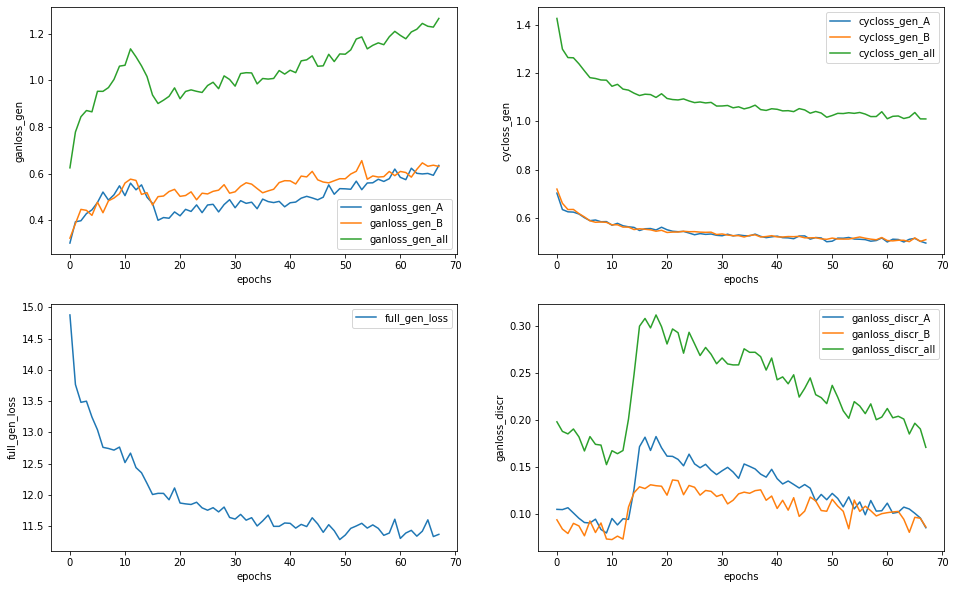

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


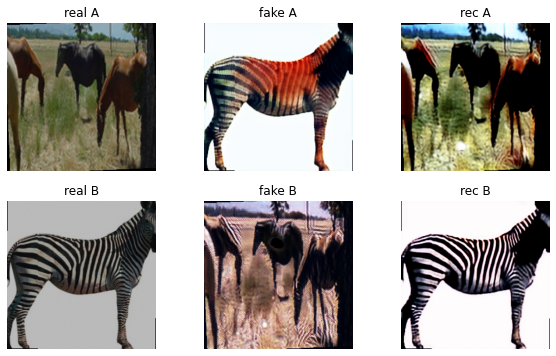

Epoch:  34%|███▍      | 68/200 [20:51:19<40:32:31, 1105.70s/it]

Epoch:  34%|███▍      | 68/200 [21:09:34<40:32:31, 1105.70s/it]



Generator metrics:
ganloss_gen_A: 0.6778175410
ganloss_gen_B: 0.6834361500
ganloss_gen_all: 1.3612536903
cycloss_gen_A: 0.5006152757
cycloss_gen_B: 0.5092969181
cycloss_gen_all: 1.0099121961
full_gen_loss: 11.4603756614

Discriminator metrics: 
ganloss_discr_A: 0.0761748679
ganloss_discr_B: 0.0762238614
ganloss_discr_all: 0.1523987294

lr: 0.0002


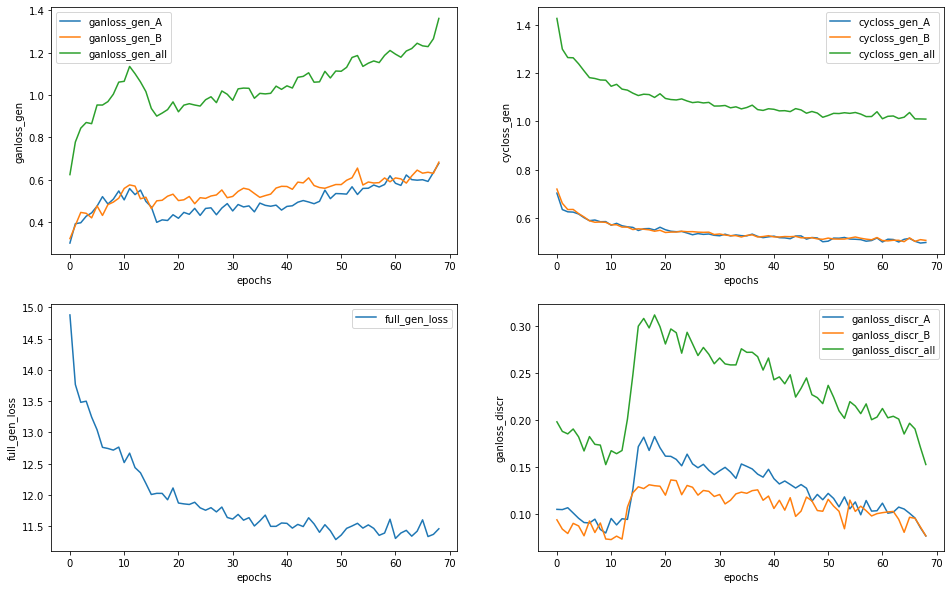

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


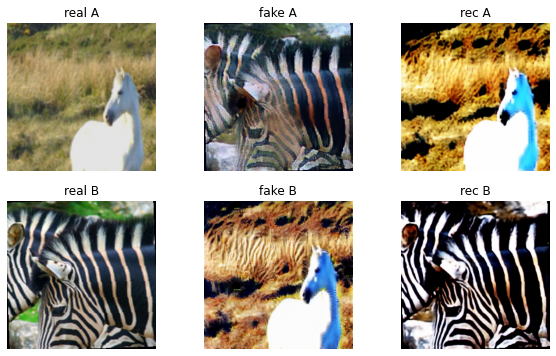

Epoch:  34%|███▍      | 69/200 [21:09:44<40:13:29, 1105.42s/it]

Epoch:  34%|███▍      | 69/200 [21:27:59<40:13:29, 1105.42s/it]



Generator metrics:
ganloss_gen_A: 0.6450208993
ganloss_gen_B: 0.6713209239
ganloss_gen_all: 1.3163418227
cycloss_gen_A: 0.5024007763
cycloss_gen_B: 0.5074289261
cycloss_gen_all: 1.0098297036
full_gen_loss: 11.4146388453

Discriminator metrics: 
ganloss_discr_A: 0.0807085792
ganloss_discr_B: 0.0836153102
ganloss_discr_all: 0.1643238895

lr: 0.0002


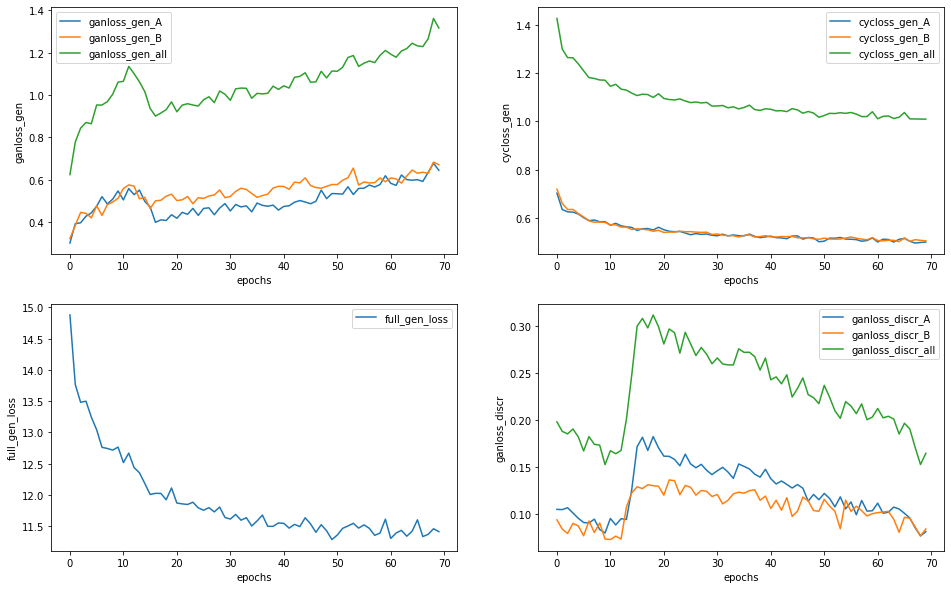

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


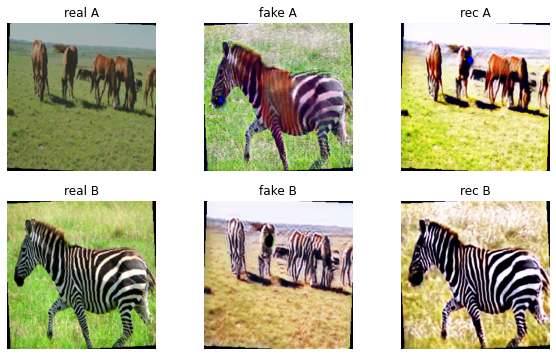

Epoch:  35%|███▌      | 70/200 [21:28:10<39:55:42, 1105.71s/it]

Epoch:  35%|███▌      | 70/200 [21:46:25<39:55:42, 1105.71s/it]



Generator metrics:
ganloss_gen_A: 0.6798760104
ganloss_gen_B: 0.6413257770
ganloss_gen_all: 1.3212017870
cycloss_gen_A: 0.5076017468
cycloss_gen_B: 0.5060389339
cycloss_gen_all: 1.0136406825
full_gen_loss: 11.4576086226

Discriminator metrics: 
ganloss_discr_A: 0.0833305104
ganloss_discr_B: 0.0888448970
ganloss_discr_all: 0.1721754075

lr: 0.0002


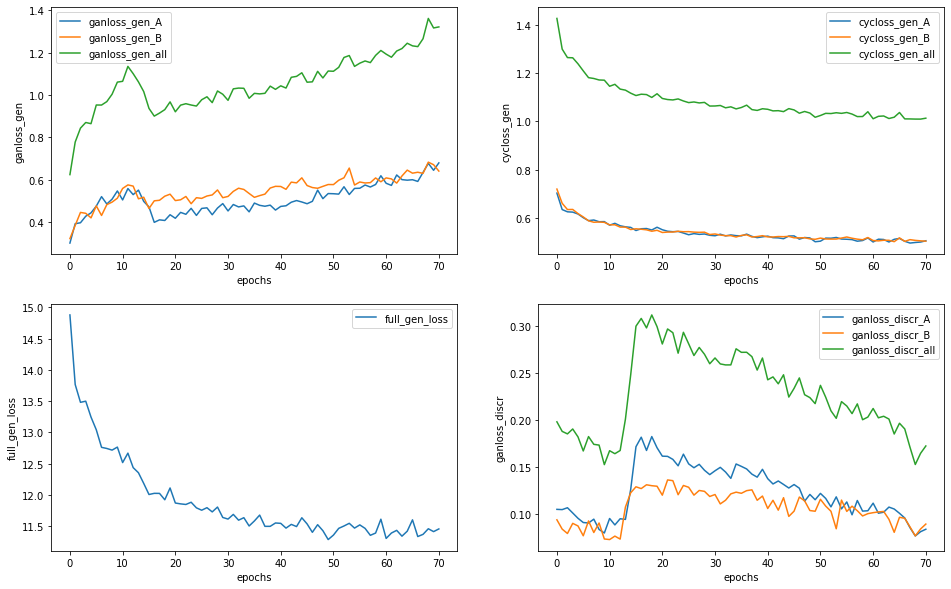

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


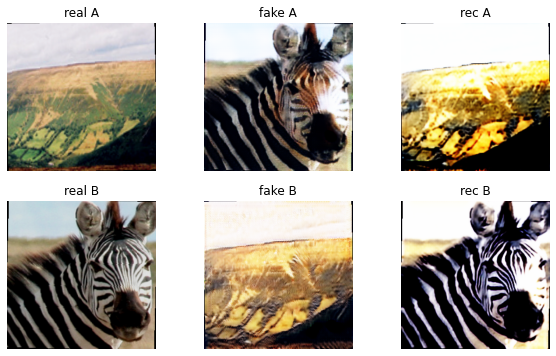

Epoch:  36%|███▌      | 71/200 [21:46:36<39:37:13, 1105.69s/it]

Epoch:  36%|███▌      | 71/200 [22:04:51<39:37:13, 1105.69s/it]



Generator metrics:
ganloss_gen_A: 0.6335285341
ganloss_gen_B: 0.6743852722
ganloss_gen_all: 1.3079138060
cycloss_gen_A: 0.5126939049
cycloss_gen_B: 0.5119834311
cycloss_gen_all: 1.0246773386
full_gen_loss: 11.5546871751

Discriminator metrics: 
ganloss_discr_A: 0.0895337267
ganloss_discr_B: 0.0737602230
ganloss_discr_all: 0.1632939497

lr: 0.0002


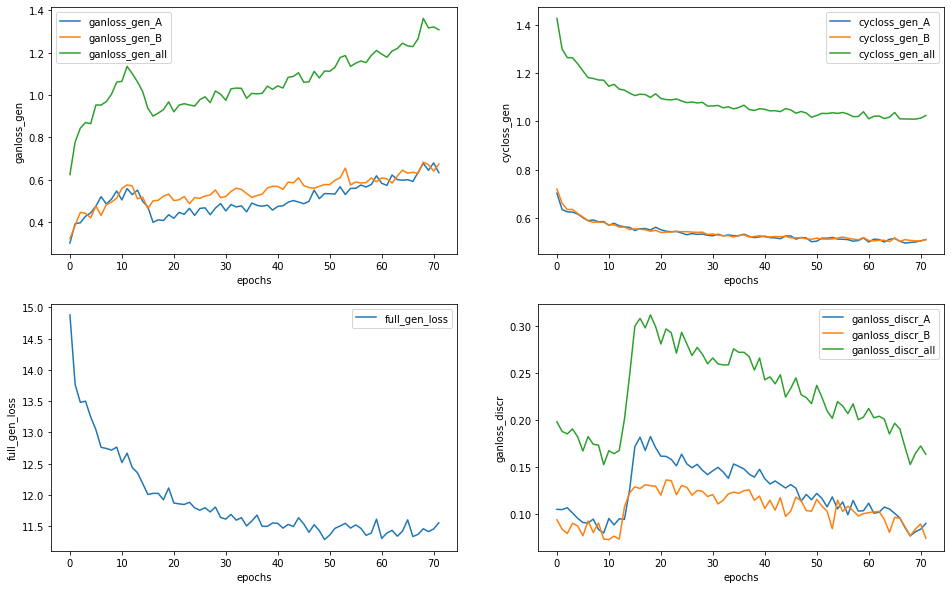

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


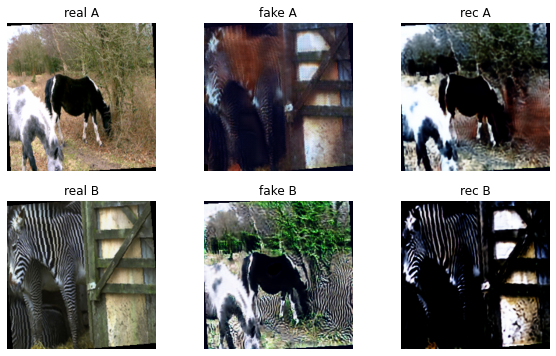

Epoch:  36%|███▌      | 72/200 [22:05:01<39:18:38, 1105.61s/it]

Epoch:  36%|███▌      | 72/200 [22:23:16<39:18:38, 1105.61s/it]



Generator metrics:
ganloss_gen_A: 0.6725928422
ganloss_gen_B: 0.6669248731
ganloss_gen_all: 1.3395177144
cycloss_gen_A: 0.5004210894
cycloss_gen_B: 0.5040141656
cycloss_gen_all: 1.0044352578
full_gen_loss: 11.3838702960

Discriminator metrics: 
ganloss_discr_A: 0.0708526139
ganloss_discr_B: 0.0803462327
ganloss_discr_all: 0.1511988465

lr: 0.0002


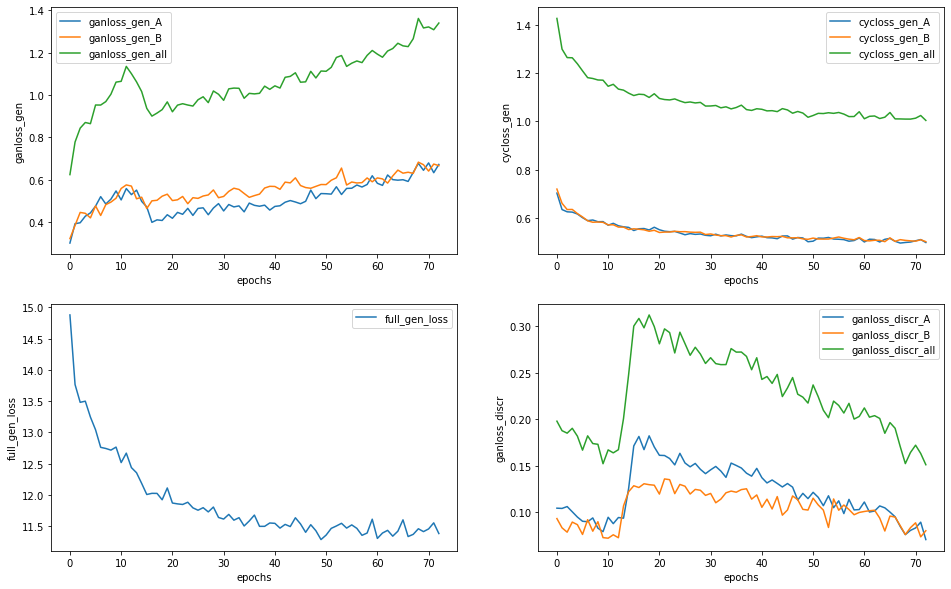

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


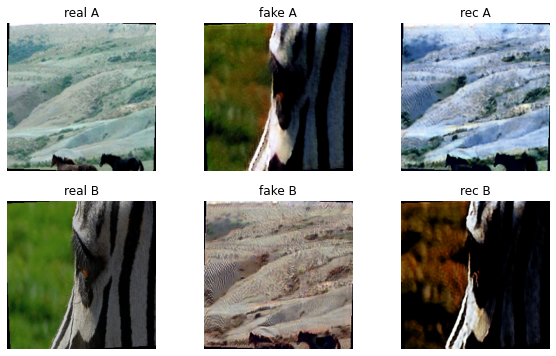

Epoch:  36%|███▋      | 73/200 [22:23:27<38:59:54, 1105.47s/it]

Epoch:  36%|███▋      | 73/200 [22:41:41<38:59:54, 1105.47s/it]



Generator metrics:
ganloss_gen_A: 0.6667643954
ganloss_gen_B: 0.6558027835
ganloss_gen_all: 1.3225671778
cycloss_gen_A: 0.5069981816
cycloss_gen_B: 0.5147850186
cycloss_gen_all: 1.0217832029
full_gen_loss: 11.5403991879

Discriminator metrics: 
ganloss_discr_A: 0.0817561022
ganloss_discr_B: 0.0897755364
ganloss_discr_all: 0.1715316386

lr: 0.0002


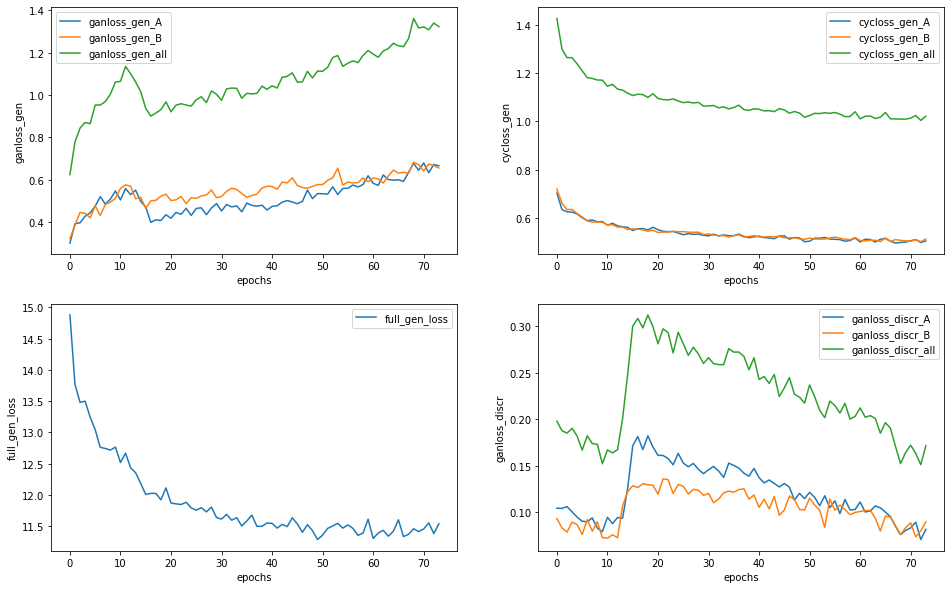

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


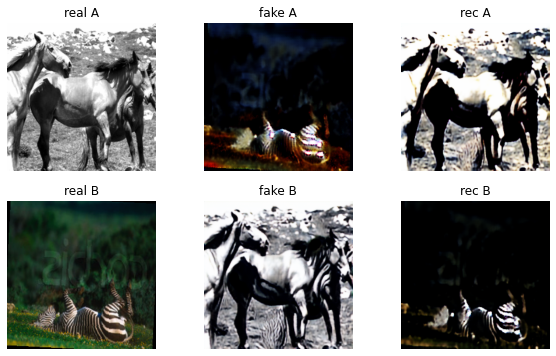

Epoch:  37%|███▋      | 74/200 [22:41:53<38:41:58, 1105.70s/it]

Epoch:  37%|███▋      | 74/200 [23:00:07<38:41:58, 1105.70s/it]



Generator metrics:
ganloss_gen_A: 0.6374909791
ganloss_gen_B: 0.6458222281
ganloss_gen_all: 1.2833132043
cycloss_gen_A: 0.4954653766
cycloss_gen_B: 0.5093113167
cycloss_gen_all: 1.0047766939
full_gen_loss: 11.3310801593

Discriminator metrics: 
ganloss_discr_A: 0.0934428130
ganloss_discr_B: 0.0933248274
ganloss_discr_all: 0.1867676408

lr: 0.0002


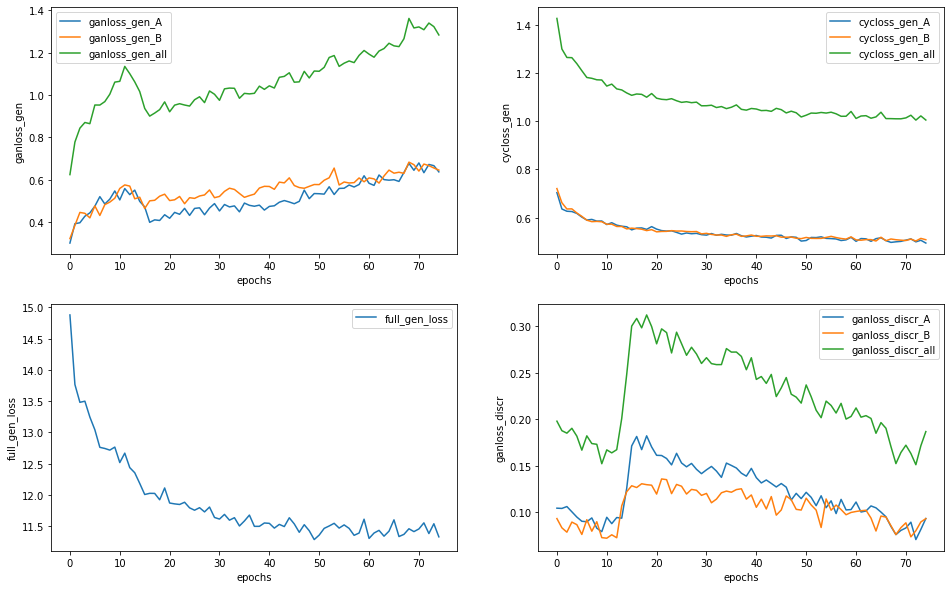

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


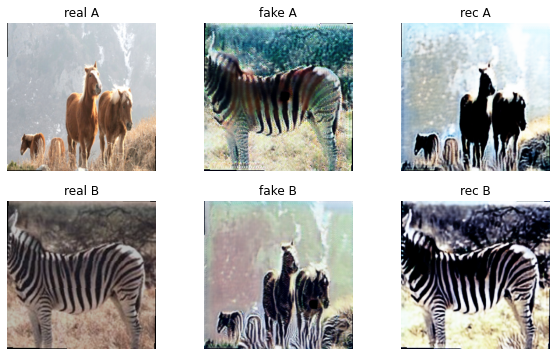

Epoch:  38%|███▊      | 75/200 [23:00:18<38:23:30, 1105.68s/it]

Epoch:  38%|███▊      | 75/200 [23:18:33<38:23:30, 1105.68s/it]



Generator metrics:
ganloss_gen_A: 0.7264311982
ganloss_gen_B: 0.6741169160
ganloss_gen_all: 1.4005481129
cycloss_gen_A: 0.5101542567
cycloss_gen_B: 0.5057213121
cycloss_gen_all: 1.0158755721
full_gen_loss: 11.5593038327

Discriminator metrics: 
ganloss_discr_A: 0.0658525159
ganloss_discr_B: 0.0852047834
ganloss_discr_all: 0.1510572993

lr: 0.0002


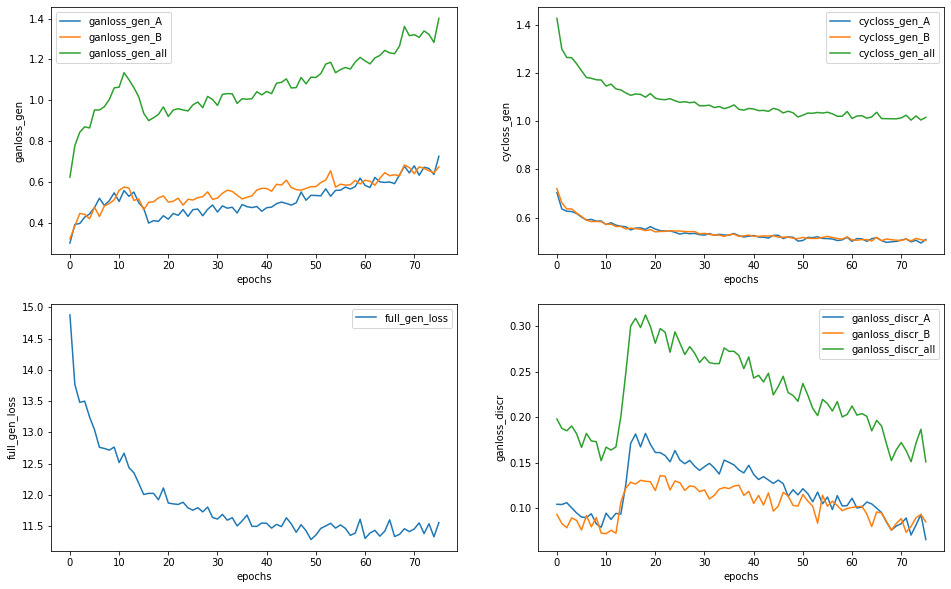

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


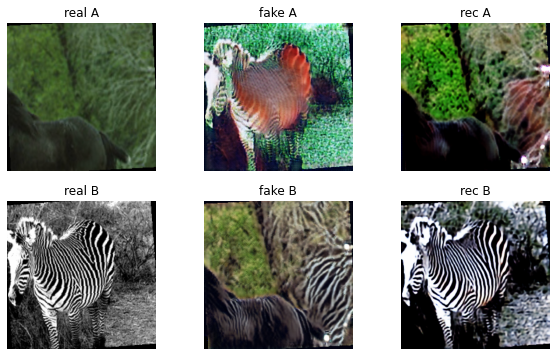

Epoch:  38%|███▊      | 76/200 [23:18:45<38:05:20, 1105.81s/it]

Epoch:  38%|███▊      | 76/200 [23:37:01<38:05:20, 1105.81s/it]



Generator metrics:
ganloss_gen_A: 0.6969908029
ganloss_gen_B: 0.7236114247
ganloss_gen_all: 1.4206022293
cycloss_gen_A: 0.4995005753
cycloss_gen_B: 0.5127779920
cycloss_gen_all: 1.0122785697
full_gen_loss: 11.5433879435

Discriminator metrics: 
ganloss_discr_A: 0.0704687782
ganloss_discr_B: 0.0637943202
ganloss_discr_all: 0.1342630983

lr: 0.0002


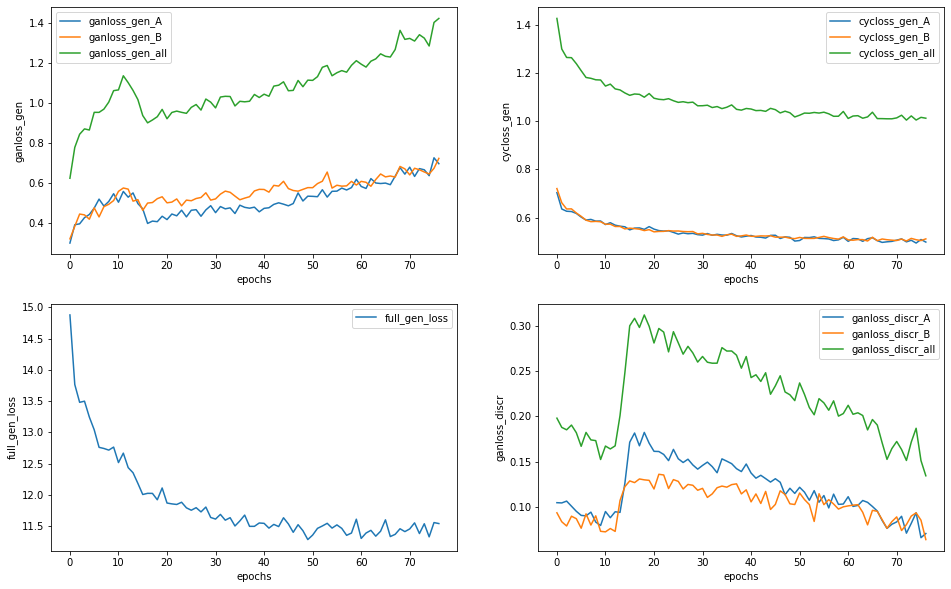

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


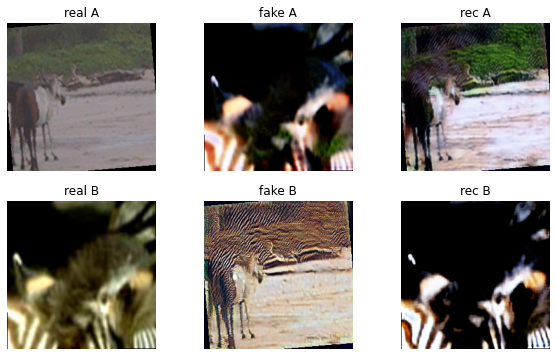

Epoch:  38%|███▊      | 77/200 [23:37:13<37:48:14, 1106.46s/it]

In [ ]:
gan.fit(h_trdl, z_trdl)

Stage 2<br>

Логирование обучения с 77 эпохи по ~100, были утеряны из-за disconnect-а

Stage 3



Epoch:   0%|          | 0/100 [00:00<?, ?it/s]



Epoch:   1%|          | 1/100 [18:16<30:08:28, 1096.05s/it]



Epoch:   2%|▏         | 2/100 [36:32<29:50:13, 1096.06s/it]



Epoch:   3%|▎         | 3/100 [54:47<29:31:52, 1096.00s/it]



Epoch:   4%|▍         | 4/100 [1:13:03<29:13:35, 1096.00s/it]



Epoch:   0%|          | 0/100 [1:50:44<?, ?it/s]

Epoch:   4%|▍         | 4/100 [1:31:15<29:13:35, 1096.00s/it]



Generator metrics:
ganloss_gen_A: 0.8850367420
ganloss_gen_B: 0.8907103559
ganloss_gen_all: 1.7757470984
cycloss_gen_A: 0.4608790701
cycloss_gen_B: 0.4631831392
cycloss_gen_all: 0.9240622113
full_gen_loss: 11.0163692170

Discriminator metrics: 
ganloss_discr_A: 0.0298014037
ganloss_discr_B: 0.0341454293
ganloss_discr_all: 0.0639468329

lr: 5e-05


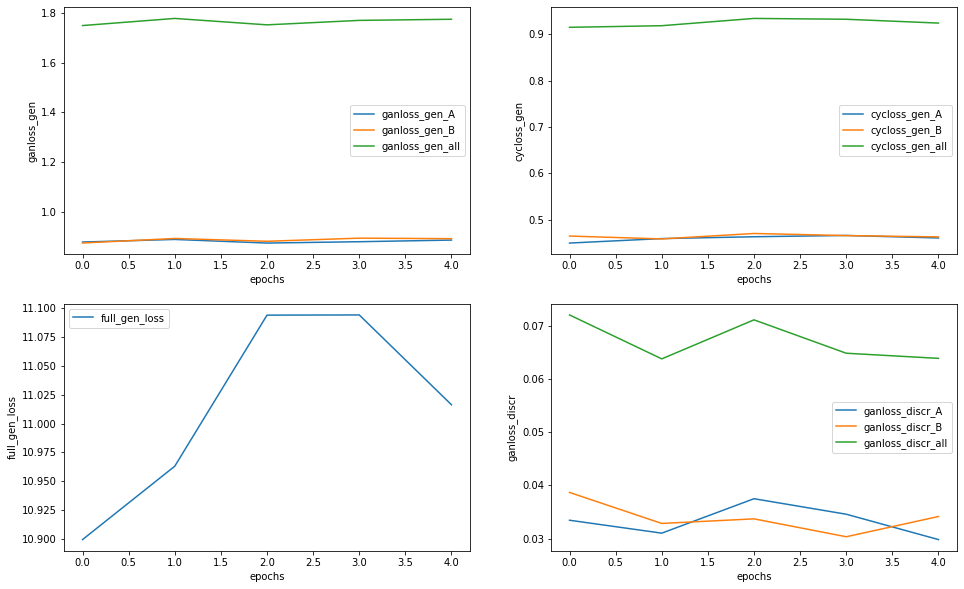

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


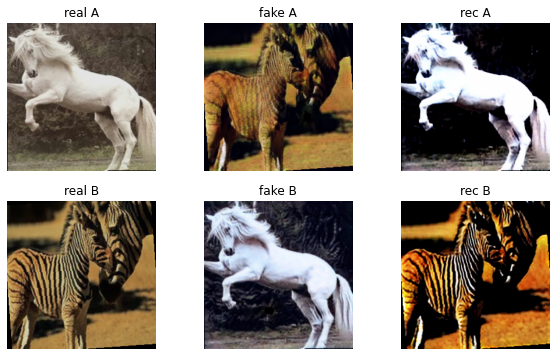



Epoch:   5%|▌         | 5/100 [1:31:22<28:56:19, 1096.63s/it]



Epoch:   6%|▌         | 6/100 [1:49:37<28:37:24, 1096.22s/it]



Epoch:   7%|▋         | 7/100 [2:07:53<28:18:57, 1096.10s/it]



Epoch:   8%|▊         | 8/100 [2:26:09<28:00:33, 1096.02s/it]



Epoch:   9%|▉         | 9/100 [2:44:25<27:42:17, 1096.02s/it]



Epoch:   0%|          | 0/100 [3:22:05<?, ?it/s]

Epoch:   9%|▉         | 9/100 [3:02:36<27:42:17, 1096.02s/it]



Generator metrics:
ganloss_gen_A: 0.8836002137
ganloss_gen_B: 0.8894094376
ganloss_gen_all: 1.7730096522
cycloss_gen_A: 0.4504619494
cycloss_gen_B: 0.4594925144
cycloss_gen_all: 0.9099544647
full_gen_loss: 10.8725542983

Discriminator metrics: 
ganloss_discr_A: 0.0319882686
ganloss_discr_B: 0.0289601620
ganloss_discr_all: 0.0609484306

lr: 2.5e-05


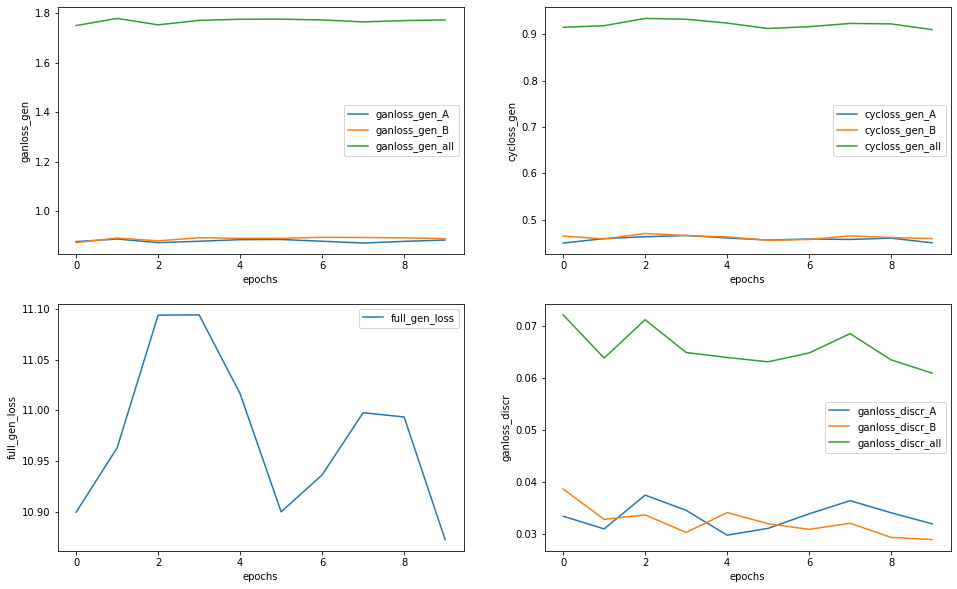

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


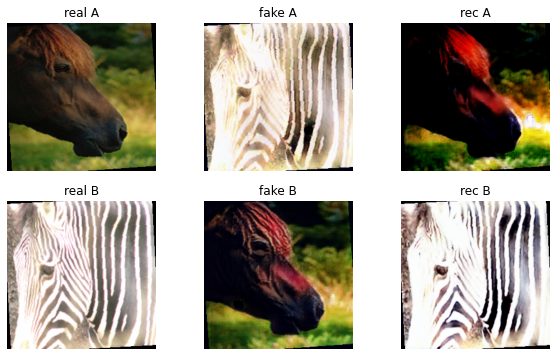



Epoch:  10%|█         | 10/100 [3:02:42<27:24:41, 1096.46s/it]



Epoch:  11%|█         | 11/100 [3:20:58<27:06:10, 1096.30s/it]



Epoch:  12%|█▏        | 12/100 [3:39:14<26:47:57, 1096.34s/it]



Epoch:  13%|█▎        | 13/100 [3:57:30<26:29:23, 1096.13s/it]



Epoch:  14%|█▍        | 14/100 [4:15:46<26:10:56, 1096.01s/it]



Epoch:   0%|          | 0/100 [4:53:26<?, ?it/s]

Epoch:  14%|█▍        | 14/100 [4:33:57<26:10:56, 1096.01s/it]



Generator metrics:
ganloss_gen_A: 0.8949133192
ganloss_gen_B: 0.8935307249
ganloss_gen_all: 1.7884440432
cycloss_gen_A: 0.4467578847
cycloss_gen_B: 0.4606335180
cycloss_gen_all: 0.9073914040
full_gen_loss: 10.8623580825

Discriminator metrics: 
ganloss_discr_A: 0.0337800616
ganloss_discr_B: 0.0366234185
ganloss_discr_all: 0.0704034803

lr: 2.5e-05


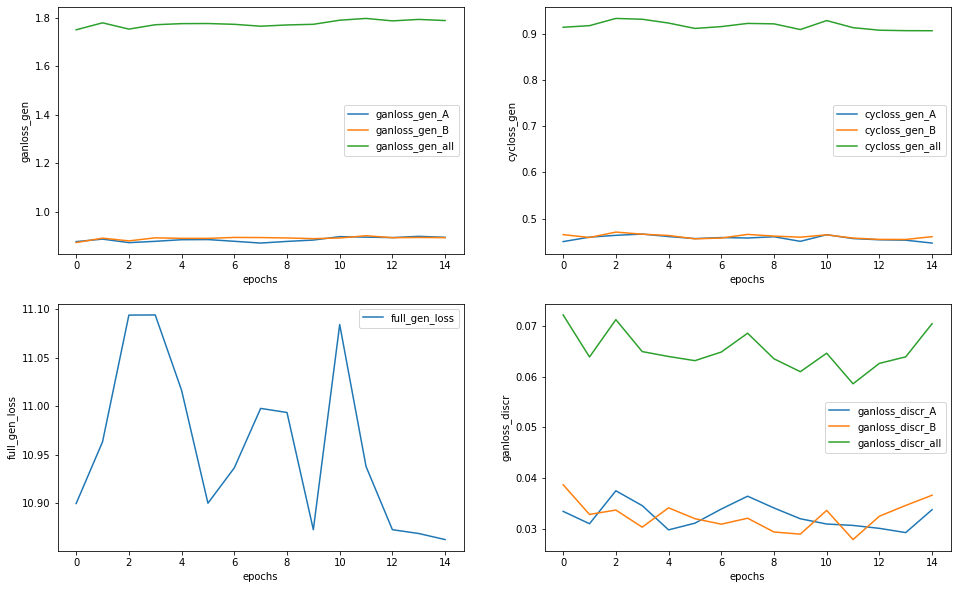

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


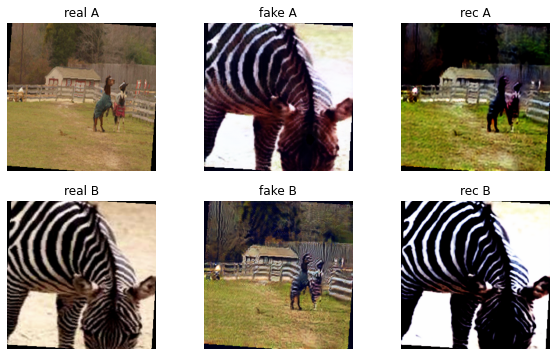



Epoch:  15%|█▌        | 15/100 [4:34:03<25:53:11, 1096.37s/it]



Epoch:  16%|█▌        | 16/100 [4:52:19<25:34:42, 1096.22s/it]



Epoch:  17%|█▋        | 17/100 [5:10:34<25:16:05, 1095.98s/it]



Epoch:  18%|█▊        | 18/100 [5:28:50<24:57:39, 1095.85s/it]



Epoch:  19%|█▉        | 19/100 [5:47:06<24:39:22, 1095.83s/it]



Epoch:   0%|          | 0/100 [6:24:45<?, ?it/s]

Epoch:  19%|█▉        | 19/100 [6:05:17<24:39:22, 1095.83s/it]



Generator metrics:
ganloss_gen_A: 0.8833602207
ganloss_gen_B: 0.9001973847
ganloss_gen_all: 1.7835576060
cycloss_gen_A: 0.4606104185
cycloss_gen_B: 0.4564043996
cycloss_gen_all: 0.9170148198
full_gen_loss: 10.9537058087

Discriminator metrics: 
ganloss_discr_A: 0.0363491592
ganloss_discr_B: 0.0302387155
ganloss_discr_all: 0.0665878747

lr: 1.25e-05


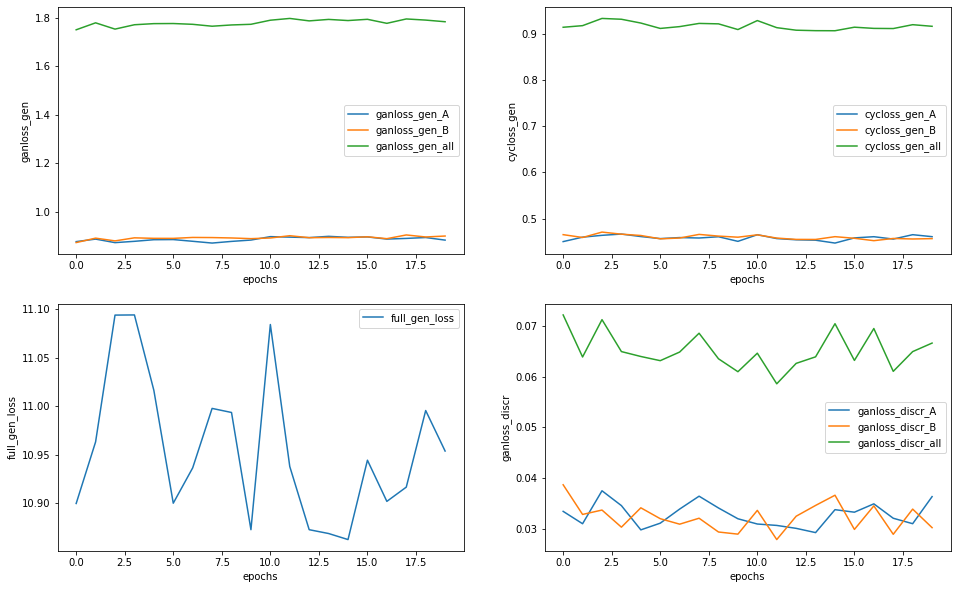

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


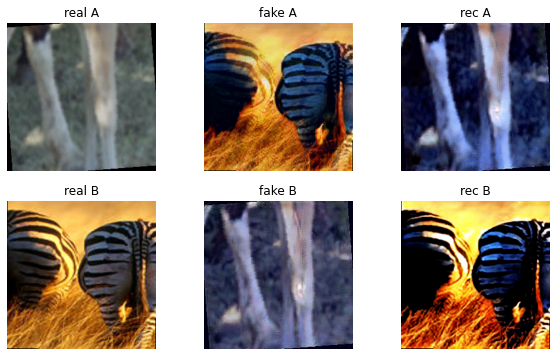



Epoch:  20%|██        | 20/100 [6:05:23<24:21:35, 1096.20s/it]



Epoch:  21%|██        | 21/100 [6:23:38<24:03:08, 1096.06s/it]



Epoch:  22%|██▏       | 22/100 [6:41:54<23:44:50, 1096.03s/it]



Epoch:  23%|██▎       | 23/100 [7:00:11<23:26:45, 1096.17s/it]



Epoch:  24%|██▍       | 24/100 [7:18:27<23:08:23, 1096.10s/it]



Epoch:   0%|          | 0/100 [7:56:08<?, ?it/s]

Epoch:  24%|██▍       | 24/100 [7:36:39<23:08:23, 1096.10s/it]



Generator metrics:
ganloss_gen_A: 0.8995533742
ganloss_gen_B: 0.8937672484
ganloss_gen_all: 1.7933206225
cycloss_gen_A: 0.4435529781
cycloss_gen_B: 0.4617736753
cycloss_gen_all: 0.9053266545
full_gen_loss: 10.8465871822

Discriminator metrics: 
ganloss_discr_A: 0.0332809771
ganloss_discr_B: 0.0373010370
ganloss_discr_all: 0.0705820143

lr: 1.25e-05


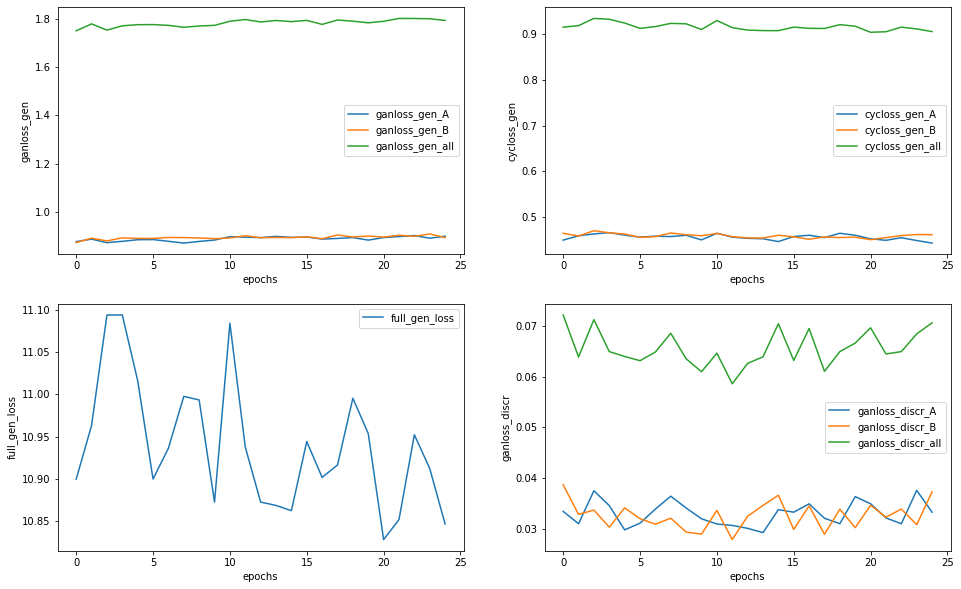

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


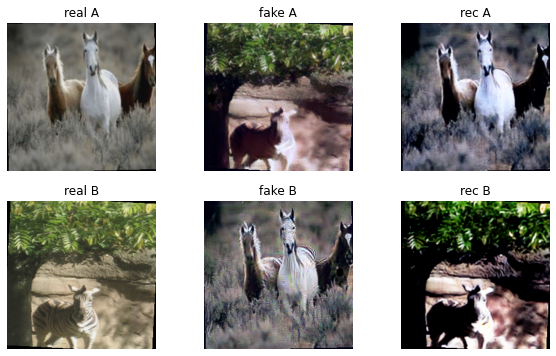



Epoch:  25%|██▌       | 25/100 [7:36:45<22:51:02, 1096.83s/it]



Epoch:  26%|██▌       | 26/100 [7:55:03<22:33:04, 1097.08s/it]



Epoch:  27%|██▋       | 27/100 [8:13:20<22:14:55, 1097.20s/it]



Epoch:  28%|██▊       | 28/100 [8:31:37<21:56:28, 1097.06s/it]



Epoch:  29%|██▉       | 29/100 [8:49:54<21:38:04, 1096.96s/it]



Epoch:   0%|          | 0/100 [9:27:34<?, ?it/s]

Epoch:  29%|██▉       | 29/100 [9:08:06<21:38:04, 1096.96s/it]



Generator metrics:
ganloss_gen_A: 0.8955704737
ganloss_gen_B: 0.9001558079
ganloss_gen_all: 1.7957262814
cycloss_gen_A: 0.4464270388
cycloss_gen_B: 0.4593560094
cycloss_gen_all: 0.9057830496
full_gen_loss: 10.8535567756

Discriminator metrics: 
ganloss_discr_A: 0.0342139628
ganloss_discr_B: 0.0324981721
ganloss_discr_all: 0.0667121349

lr: 6.25e-06


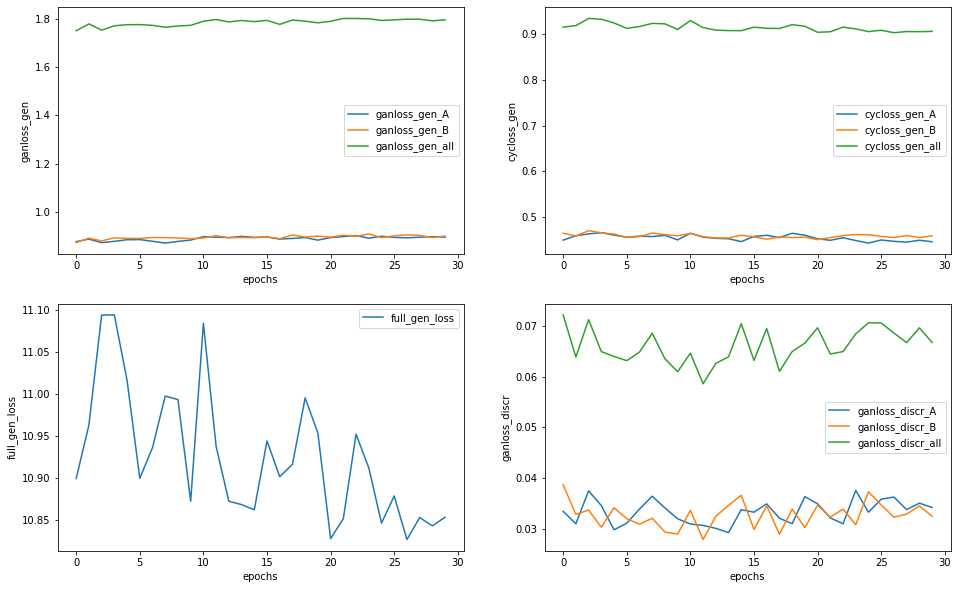

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


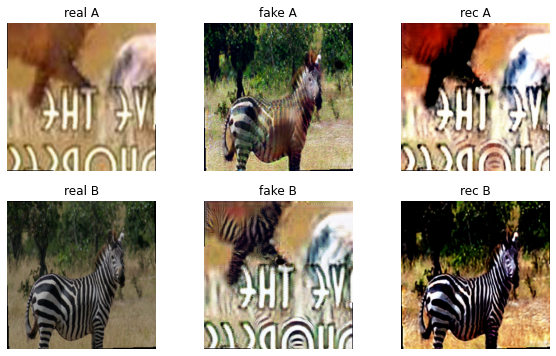



Epoch:  30%|███       | 30/100 [9:08:12<21:20:06, 1097.23s/it]



Epoch:  31%|███       | 31/100 [9:26:28<21:01:28, 1096.93s/it]



Epoch:  32%|███▏      | 32/100 [9:44:45<20:43:04, 1096.84s/it]



Epoch:  33%|███▎      | 33/100 [10:03:01<20:24:44, 1096.78s/it]



Epoch:  34%|███▍      | 34/100 [10:21:18<20:06:23, 1096.71s/it]



Epoch:   0%|          | 0/100 [10:58:58<?, ?it/s]

Epoch:  34%|███▍      | 34/100 [10:39:30<20:06:23, 1096.71s/it]



Generator metrics:
ganloss_gen_A: 0.9057820297
ganloss_gen_B: 0.8966719068
ganloss_gen_all: 1.8024539376
cycloss_gen_A: 0.4444688307
cycloss_gen_B: 0.4581495315
cycloss_gen_all: 0.9026183640
full_gen_loss: 10.8286375828

Discriminator metrics: 
ganloss_discr_A: 0.0317943420
ganloss_discr_B: 0.0377065714
ganloss_discr_all: 0.0695009134

lr: 6.25e-06


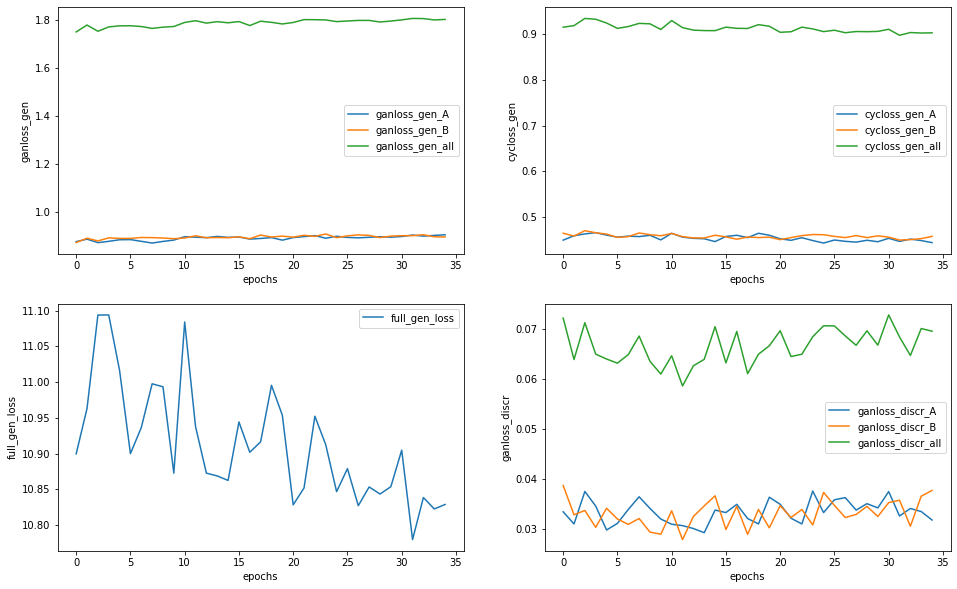

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


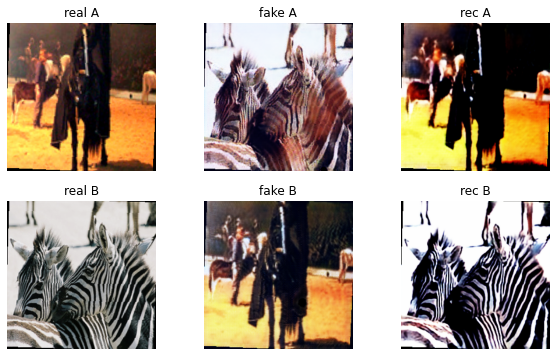



Epoch:  35%|███▌      | 35/100 [10:39:36<19:48:34, 1097.14s/it]



Epoch:  36%|███▌      | 36/100 [10:57:53<19:30:14, 1097.11s/it]



Epoch:  37%|███▋      | 37/100 [11:16:10<19:11:54, 1097.06s/it]



Epoch:  38%|███▊      | 38/100 [11:34:26<18:53:22, 1096.81s/it]



Epoch:  39%|███▉      | 39/100 [11:52:43<18:35:00, 1096.73s/it]



Epoch:   0%|          | 0/100 [12:30:23<?, ?it/s]

Epoch:  39%|███▉      | 39/100 [12:10:54<18:35:00, 1096.73s/it]



Generator metrics:
ganloss_gen_A: 0.9012779707
ganloss_gen_B: 0.8994510355
ganloss_gen_all: 1.8007290068
cycloss_gen_A: 0.4548056307
cycloss_gen_B: 0.4520322319
cycloss_gen_all: 0.9068378645
full_gen_loss: 10.8691076564

Discriminator metrics: 
ganloss_discr_A: 0.0346264921
ganloss_discr_B: 0.0361013468
ganloss_discr_all: 0.0707278388

lr: 3.125e-06


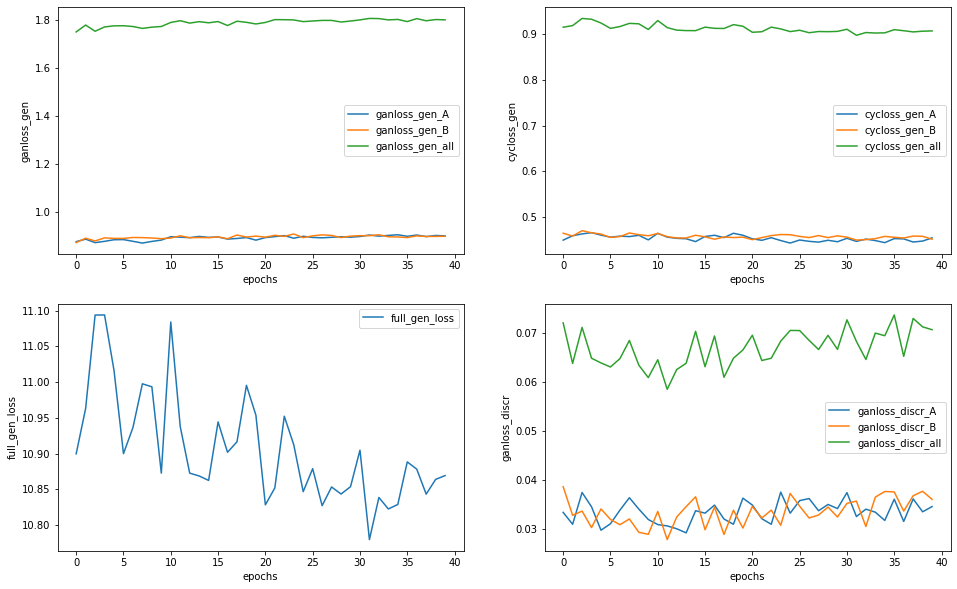

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


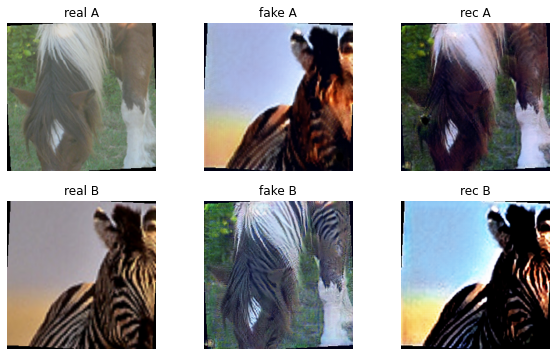



Epoch:  40%|████      | 40/100 [12:11:01<18:17:09, 1097.15s/it]



Epoch:  41%|████      | 41/100 [12:29:17<17:58:34, 1096.86s/it]



Epoch:  42%|████▏     | 42/100 [12:47:33<17:40:03, 1096.60s/it]



Epoch:  43%|████▎     | 43/100 [13:05:49<17:21:42, 1096.53s/it]



Epoch:  44%|████▍     | 44/100 [13:24:06<17:03:21, 1096.46s/it]



Epoch:   0%|          | 0/100 [14:01:47<?, ?it/s]

Epoch:  44%|████▍     | 44/100 [13:42:18<17:03:21, 1096.46s/it]



Generator metrics:
ganloss_gen_A: 0.8984721463
ganloss_gen_B: 0.9030161988
ganloss_gen_all: 1.8014883446
cycloss_gen_A: 0.4533881625
cycloss_gen_B: 0.4545193217
cycloss_gen_all: 0.9079074853
full_gen_loss: 10.8805632152

Discriminator metrics: 
ganloss_discr_A: 0.0369660689
ganloss_discr_B: 0.0352359472
ganloss_discr_all: 0.0722020161

lr: 3.125e-06


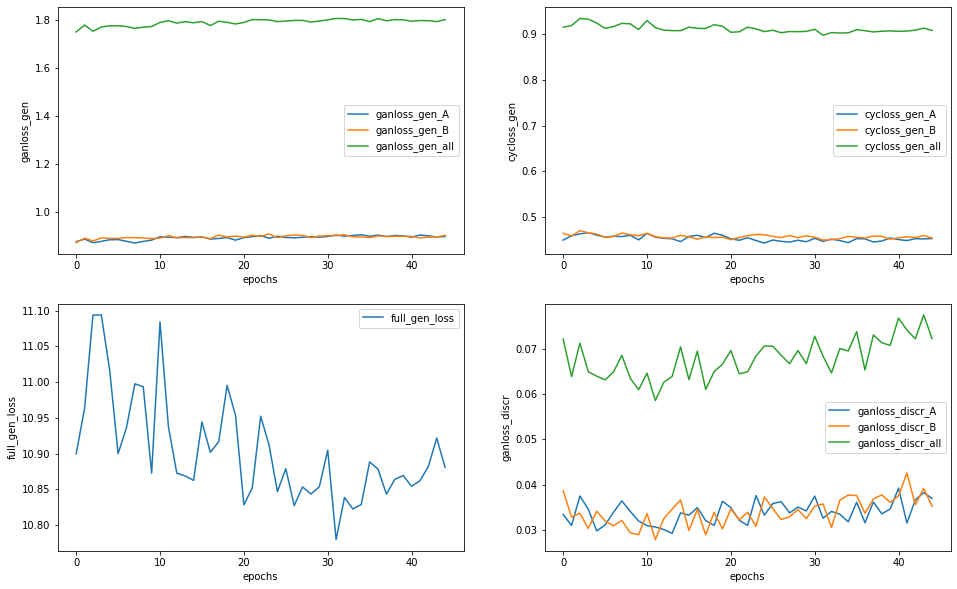

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


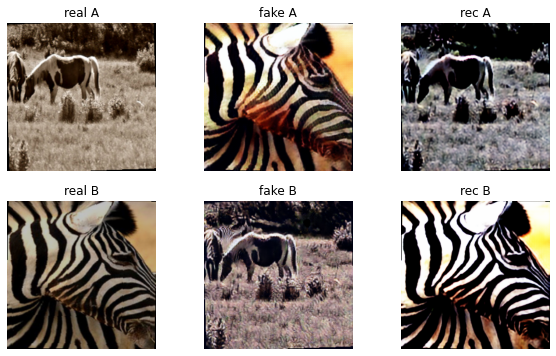



Epoch:  45%|████▌     | 45/100 [13:42:24<16:45:37, 1097.04s/it]



Epoch:  46%|████▌     | 46/100 [14:00:40<16:27:09, 1096.85s/it]



Epoch:  47%|████▋     | 47/100 [14:18:57<16:08:44, 1096.68s/it]



Epoch:  48%|████▊     | 48/100 [14:37:13<15:50:16, 1096.47s/it]



Epoch:  49%|████▉     | 49/100 [14:55:29<15:31:52, 1096.33s/it]



Epoch:   0%|          | 0/100 [15:33:09<?, ?it/s]

Epoch:  49%|████▉     | 49/100 [15:13:40<15:31:52, 1096.33s/it]



Generator metrics:
ganloss_gen_A: 0.8983137411
ganloss_gen_B: 0.8987251636
ganloss_gen_all: 1.7970389042
cycloss_gen_A: 0.4411362522
cycloss_gen_B: 0.4574639829
cycloss_gen_all: 0.8986002362
full_gen_loss: 10.7830412720

Discriminator metrics: 
ganloss_discr_A: 0.0379946040
ganloss_discr_B: 0.0367121490
ganloss_discr_all: 0.0747067530

lr: 1.5625e-06


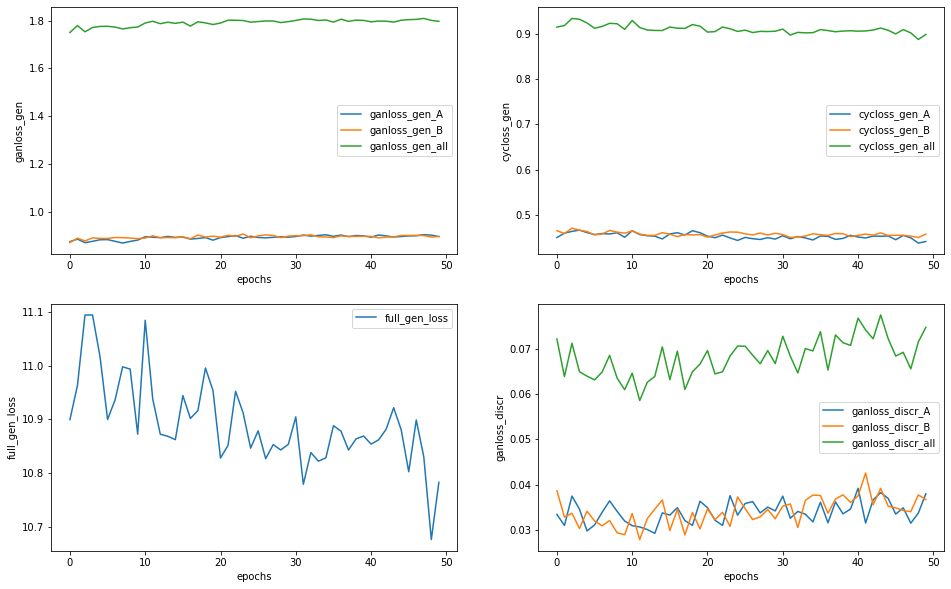

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


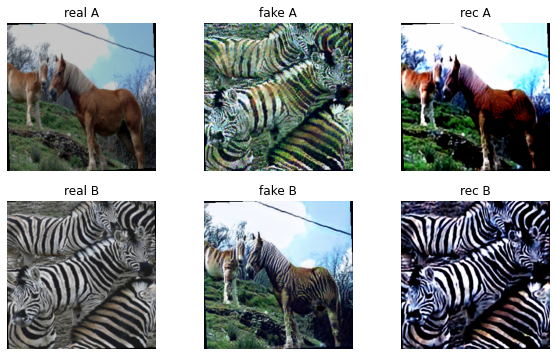



Epoch:  50%|█████     | 50/100 [15:13:46<15:13:53, 1096.67s/it]



Epoch:  51%|█████     | 51/100 [15:32:02<14:55:25, 1096.44s/it]



Epoch:  52%|█████▏    | 52/100 [15:50:18<14:36:59, 1096.25s/it]



Epoch:  53%|█████▎    | 53/100 [16:08:34<14:18:37, 1096.11s/it]



Epoch:  54%|█████▍    | 54/100 [16:26:50<14:00:25, 1096.20s/it]



Epoch:   0%|          | 0/100 [17:04:30<?, ?it/s]

Epoch:  54%|█████▍    | 54/100 [16:45:02<14:00:25, 1096.20s/it]



Generator metrics:
ganloss_gen_A: 0.9026122537
ganloss_gen_B: 0.9005593255
ganloss_gen_all: 1.8031715774
cycloss_gen_A: 0.4527193760
cycloss_gen_B: 0.4611029121
cycloss_gen_all: 0.9138222892
full_gen_loss: 10.9413944695

Discriminator metrics: 
ganloss_discr_A: 0.0340953703
ganloss_discr_B: 0.0402453209
ganloss_discr_all: 0.0743406912

lr: 1.5625e-06


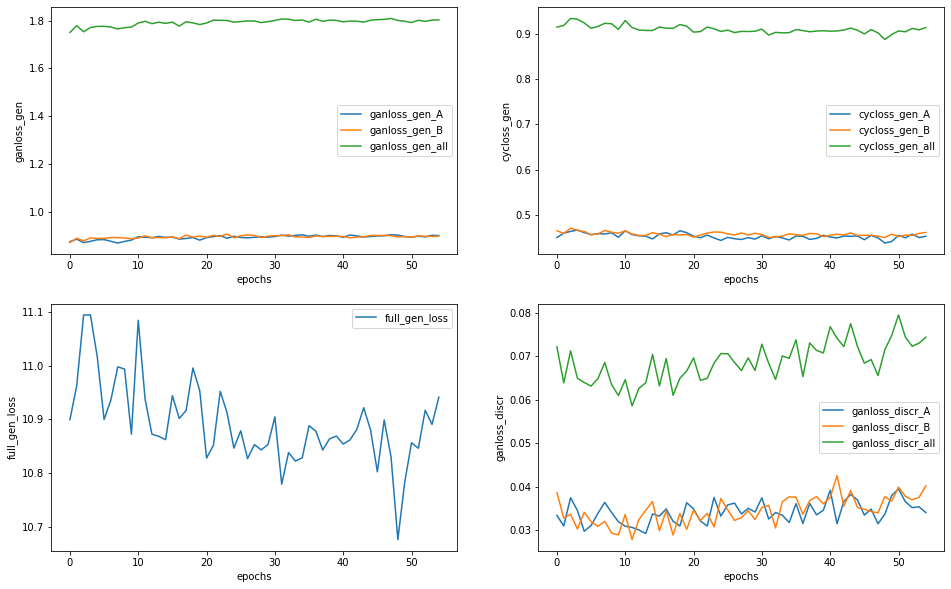

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


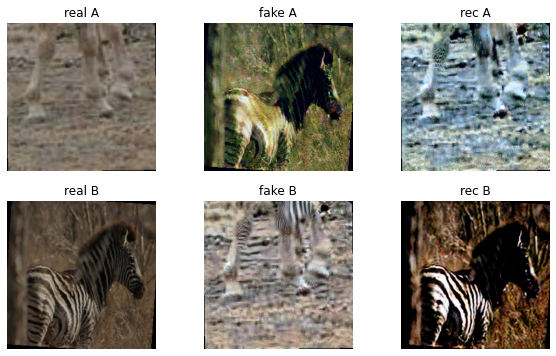



Epoch:  55%|█████▌    | 55/100 [16:45:08<13:42:35, 1096.79s/it]



Epoch:  56%|█████▌    | 56/100 [17:03:24<13:24:09, 1096.59s/it]



Epoch:  57%|█████▋    | 57/100 [17:21:41<13:05:52, 1096.56s/it]



Epoch:  58%|█████▊    | 58/100 [17:39:57<12:47:31, 1096.46s/it]



Epoch:  59%|█████▉    | 59/100 [17:58:14<12:29:18, 1096.55s/it]



Epoch:   0%|          | 0/100 [18:35:55<?, ?it/s]

Epoch:  59%|█████▉    | 59/100 [18:16:26<12:29:18, 1096.55s/it]



Generator metrics:
ganloss_gen_A: 0.8990758170
ganloss_gen_B: 0.9010543165
ganloss_gen_all: 1.8001301333
cycloss_gen_A: 0.4427326189
cycloss_gen_B: 0.4558284510
cycloss_gen_all: 0.8985610712
full_gen_loss: 10.7857408423

Discriminator metrics: 
ganloss_discr_A: 0.0357405987
ganloss_discr_B: 0.0371856484
ganloss_discr_all: 0.0729262470

lr: 7.8125e-07


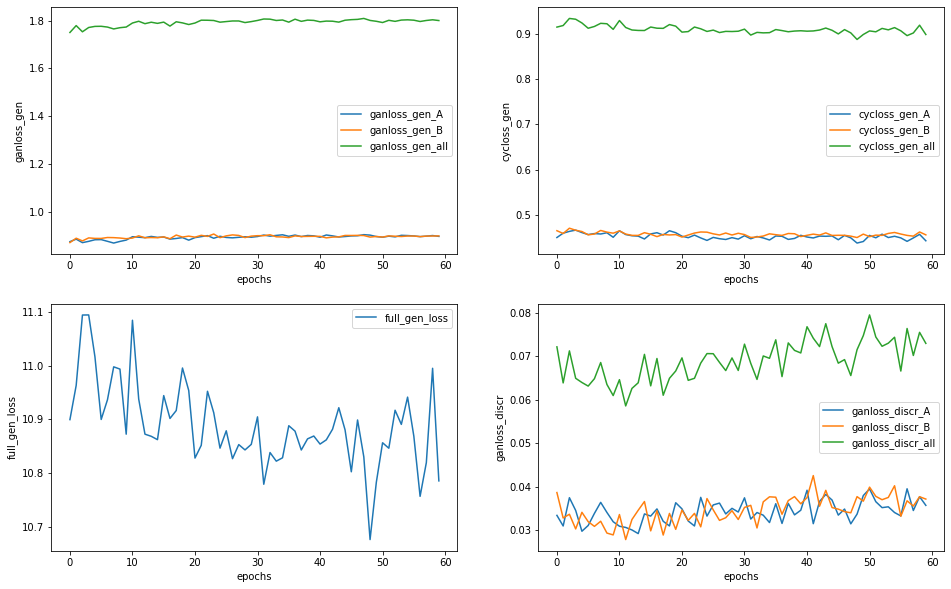

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


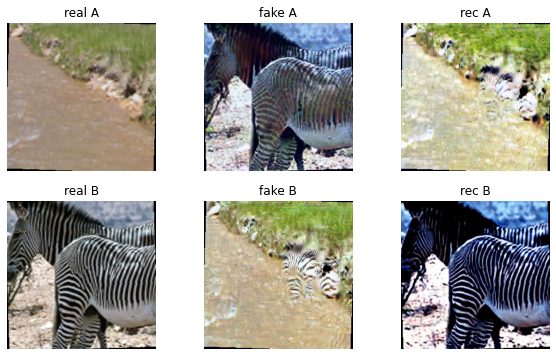



Epoch:  60%|██████    | 60/100 [18:16:33<12:11:27, 1097.18s/it]



Epoch:  61%|██████    | 61/100 [18:34:49<11:53:00, 1096.93s/it]



Epoch:  62%|██████▏   | 62/100 [18:53:05<11:34:36, 1096.74s/it]



Epoch:  63%|██████▎   | 63/100 [19:11:21<11:16:14, 1096.61s/it]



Epoch:  64%|██████▍   | 64/100 [19:29:39<10:58:02, 1096.75s/it]



Epoch:   0%|          | 0/100 [20:07:19<?, ?it/s]

Epoch:  64%|██████▍   | 64/100 [19:47:51<10:58:02, 1096.75s/it]



Generator metrics:
ganloss_gen_A: 0.8997119734
ganloss_gen_B: 0.9051440825
ganloss_gen_all: 1.8048560572
cycloss_gen_A: 0.4573592417
cycloss_gen_B: 0.4611129851
cycloss_gen_all: 0.9184722274
full_gen_loss: 10.9895783261

Discriminator metrics: 
ganloss_discr_A: 0.0363027914
ganloss_discr_B: 0.0386248037
ganloss_discr_all: 0.0749275951

lr: 7.8125e-07


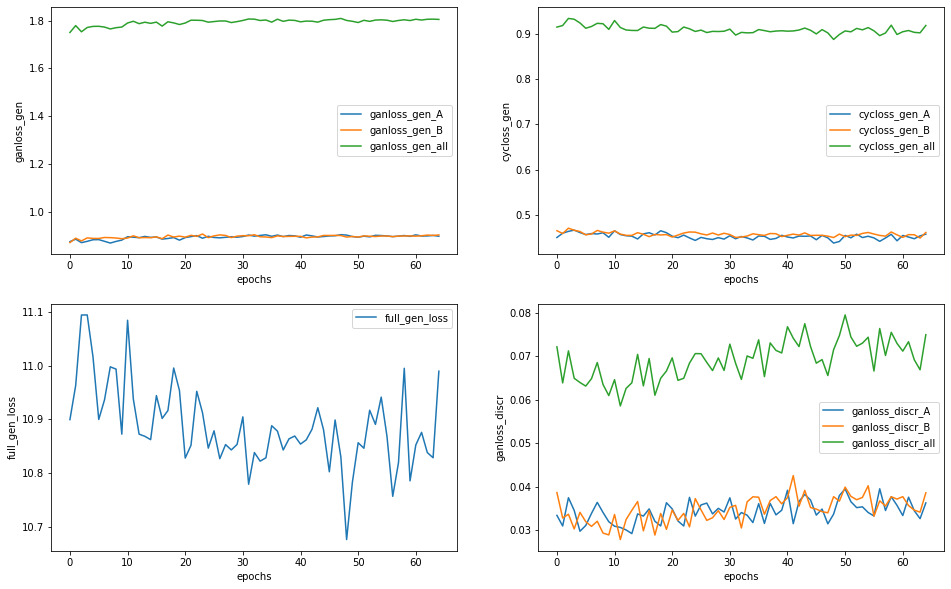

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


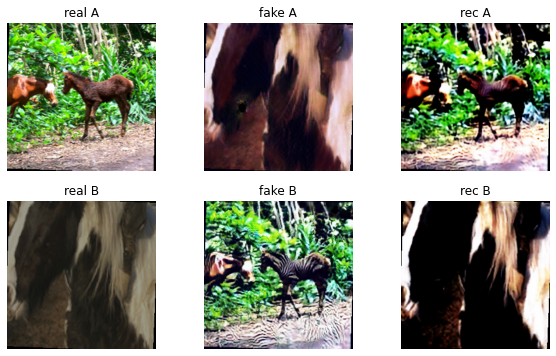



Epoch:  65%|██████▌   | 65/100 [19:47:58<10:40:09, 1097.41s/it]



Epoch:  66%|██████▌   | 66/100 [20:06:13<10:21:35, 1096.93s/it]



Epoch:  67%|██████▋   | 67/100 [20:24:30<10:03:18, 1096.94s/it]



Epoch:  68%|██████▊   | 68/100 [20:42:48<9:45:09, 1097.16s/it] 



Epoch:  69%|██████▉   | 69/100 [21:01:05<9:26:47, 1097.01s/it]



Epoch:   0%|          | 0/100 [21:38:45<?, ?it/s]

Epoch:  69%|██████▉   | 69/100 [21:19:16<9:26:47, 1097.01s/it]



Generator metrics:
ganloss_gen_A: 0.9032098487
ganloss_gen_B: 0.9001421912
ganloss_gen_all: 1.8033520400
cycloss_gen_A: 0.4461524797
cycloss_gen_B: 0.4540158879
cycloss_gen_all: 0.9001683689
full_gen_loss: 10.8050357395

Discriminator metrics: 
ganloss_discr_A: 0.0357815204
ganloss_discr_B: 0.0383187984
ganloss_discr_all: 0.0741003189

lr: 3.90625e-07


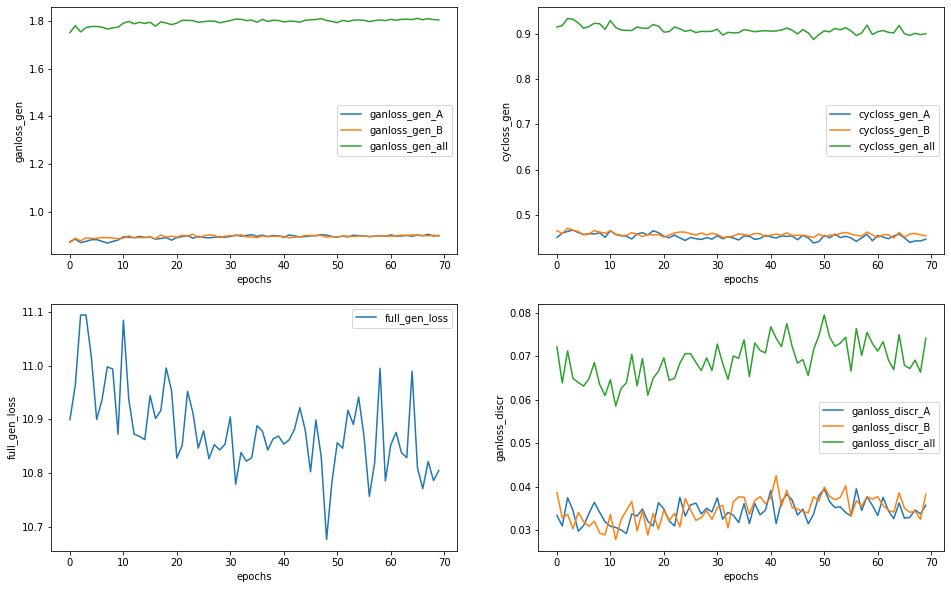

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


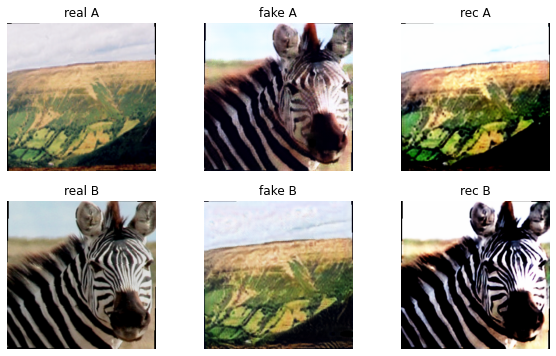



Epoch:  70%|███████   | 70/100 [21:19:22<9:08:33, 1097.11s/it]



Epoch:  71%|███████   | 71/100 [21:37:38<8:50:10, 1096.91s/it]



Epoch:  72%|███████▏  | 72/100 [21:55:55<8:31:49, 1096.77s/it]



Epoch:  73%|███████▎  | 73/100 [22:14:11<8:13:31, 1096.72s/it]



Epoch:  74%|███████▍  | 74/100 [22:32:28<7:55:14, 1096.72s/it]



Epoch:   0%|          | 0/100 [23:10:09<?, ?it/s]

Epoch:  74%|███████▍  | 74/100 [22:50:40<7:55:14, 1096.72s/it]



Generator metrics:
ganloss_gen_A: 0.9030772926
ganloss_gen_B: 0.9010316858
ganloss_gen_all: 1.8041089792
cycloss_gen_A: 0.4524487994
cycloss_gen_B: 0.4554568055
cycloss_gen_all: 0.9079056048
full_gen_loss: 10.8831650228

Discriminator metrics: 
ganloss_discr_A: 0.0335558193
ganloss_discr_B: 0.0366071856
ganloss_discr_all: 0.0701630050

lr: 3.90625e-07


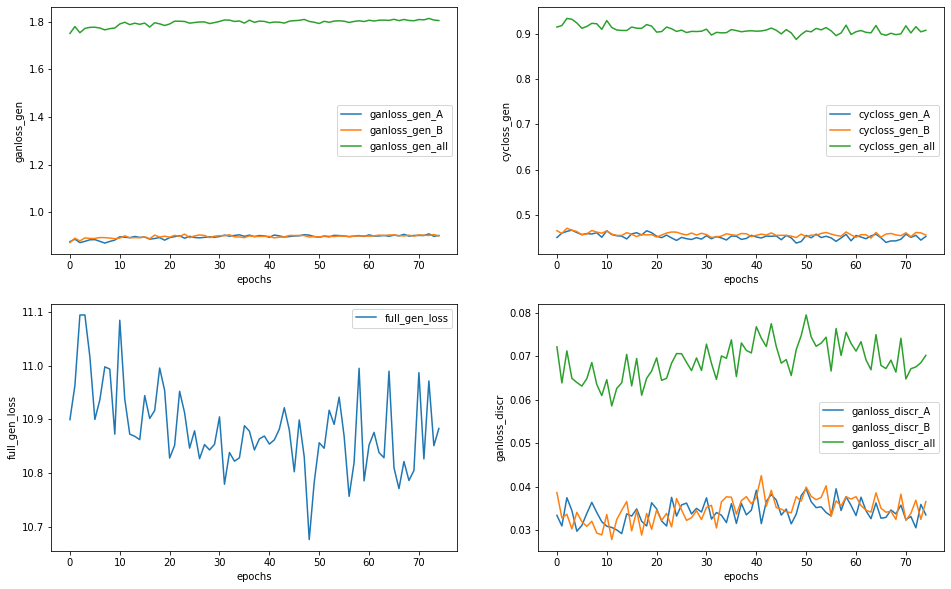

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


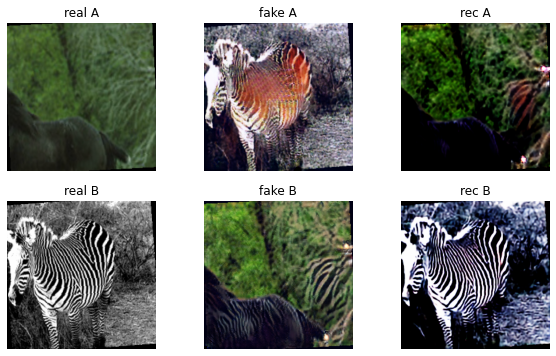



Epoch:  75%|███████▌  | 75/100 [22:50:47<7:37:10, 1097.22s/it]



Epoch:  76%|███████▌  | 76/100 [23:09:03<7:18:48, 1097.03s/it]

In [ ]:
gan.load_weights()
gan.fit(h_trdl, z_trdl, epochs=200-100, lr=1e-4,steps_todecay=[step for step in range(100-100, 200-100, 10)], step_plot=5)

Epoch:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch:   4%|▍         | 1/25 [18:09<7:15:39, 1089.16s/it]

Epoch:   8%|▊         | 2/25 [36:26<6:58:27, 1091.63s/it]

Epoch:  12%|█▏        | 3/25 [54:42<6:40:45, 1092.98s/it]

Epoch:  16%|█▌        | 4/25 [1:12:59<6:22:53, 1094.00s/it]

Epoch:  16%|█▌        | 4/25 [1:31:09<6:22:53, 1094.00s/it]



Generator metrics:
ganloss_gen_A: 0.9046812318
ganloss_gen_B: 0.9095770965
ganloss_gen_all: 1.8142583277
cycloss_gen_A: 0.4511953142
cycloss_gen_B: 0.4569219953
cycloss_gen_all: 0.9081173120
full_gen_loss: 10.8954314546

Discriminator metrics: 
ganloss_discr_A: 0.0310473812
ganloss_discr_B: 0.0275635703
ganloss_discr_all: 0.0586109516

lr: 1.953125e-07


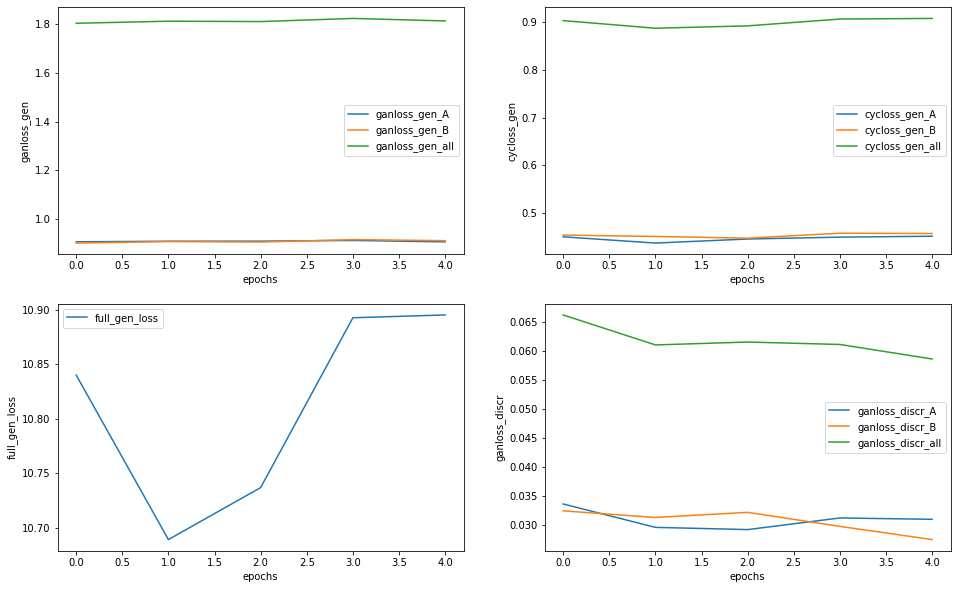

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


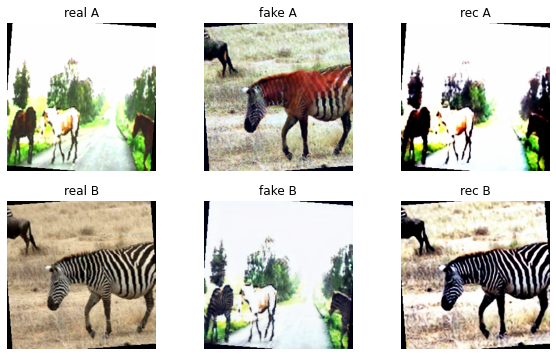

Epoch:  20%|██        | 5/25 [1:31:18<6:05:13, 1095.68s/it]

Epoch:  24%|██▍       | 6/25 [1:49:35<5:47:05, 1096.05s/it]

Epoch:  28%|██▊       | 7/25 [2:07:52<5:28:55, 1096.39s/it]

Epoch:  32%|███▏      | 8/25 [2:26:10<5:10:44, 1096.76s/it]

Epoch:  36%|███▌      | 9/25 [2:44:28<4:52:36, 1097.27s/it]

Epoch:  36%|███▌      | 9/25 [3:02:39<4:52:36, 1097.27s/it]



Generator metrics:
ganloss_gen_A: 0.9051987985
ganloss_gen_B: 0.9099268633
ganloss_gen_all: 1.8151256624
cycloss_gen_A: 0.4480822805
cycloss_gen_B: 0.4487955582
cycloss_gen_all: 0.8968778411
full_gen_loss: 10.7839040720

Discriminator metrics: 
ganloss_discr_A: 0.0340086416
ganloss_discr_B: 0.0275848713
ganloss_discr_all: 0.0615935130

lr: 9.765625e-08


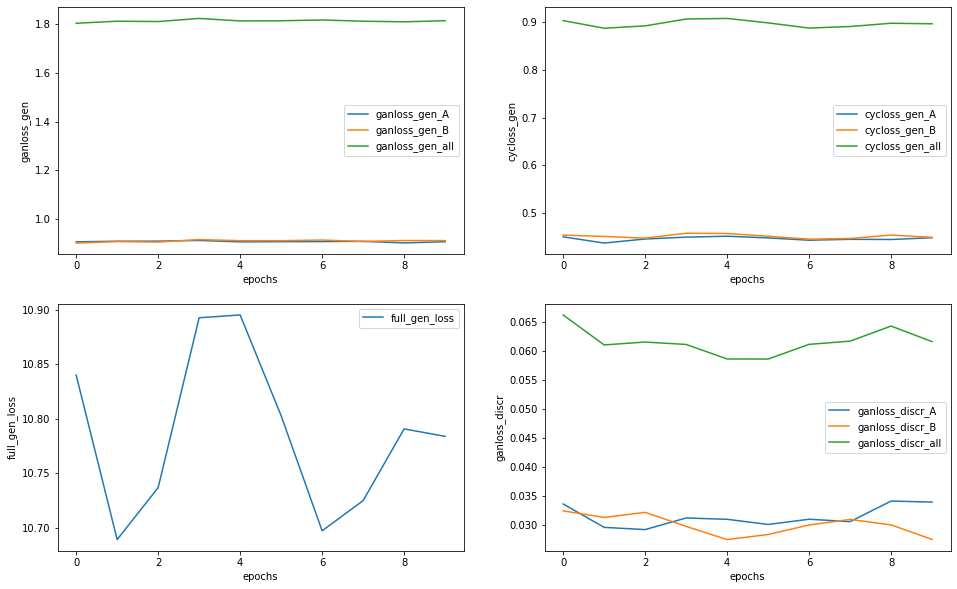

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


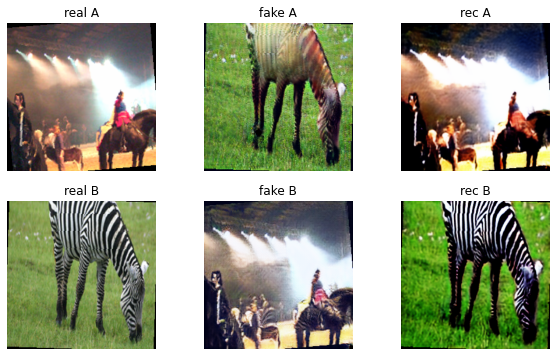

Epoch:  40%|████      | 10/25 [3:02:48<4:34:28, 1097.91s/it]

Epoch:  44%|████▍     | 11/25 [3:21:04<4:16:03, 1097.40s/it]

Epoch:  48%|████▊     | 12/25 [3:39:22<3:57:50, 1097.70s/it]

Epoch:  52%|█████▏    | 13/25 [3:57:40<3:39:30, 1097.54s/it]

Epoch:  56%|█████▌    | 14/25 [4:15:56<3:21:09, 1097.22s/it]

Epoch:  56%|█████▌    | 14/25 [4:34:06<3:21:09, 1097.22s/it]



Generator metrics:
ganloss_gen_A: 0.9058834259
ganloss_gen_B: 0.9081584947
ganloss_gen_all: 1.8140419211
cycloss_gen_A: 0.4462235324
cycloss_gen_B: 0.4484200535
cycloss_gen_all: 0.8946435887
full_gen_loss: 10.7604778027

Discriminator metrics: 
ganloss_discr_A: 0.0307810775
ganloss_discr_B: 0.0320155784
ganloss_discr_all: 0.0627966560

lr: 9.765625e-08


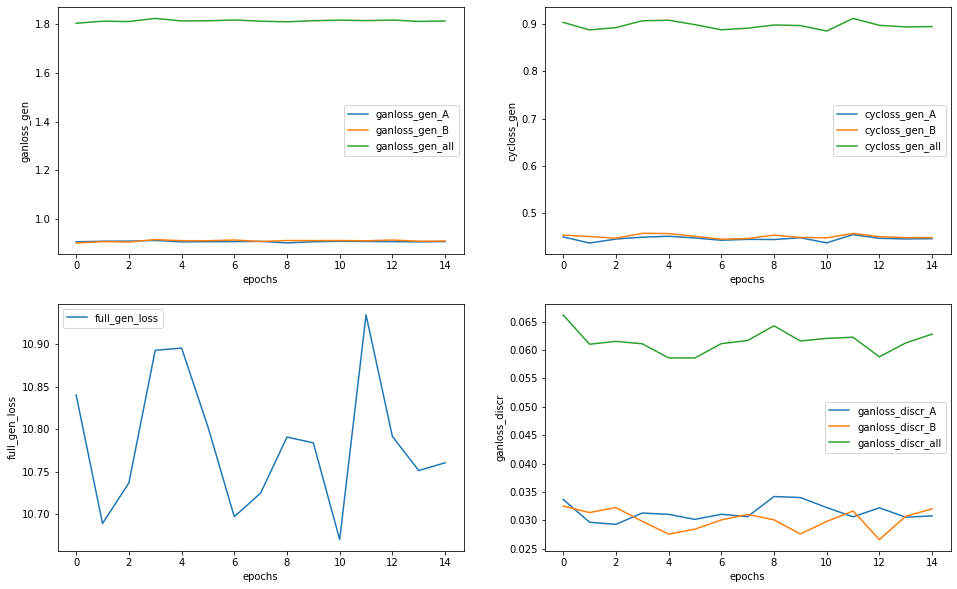

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


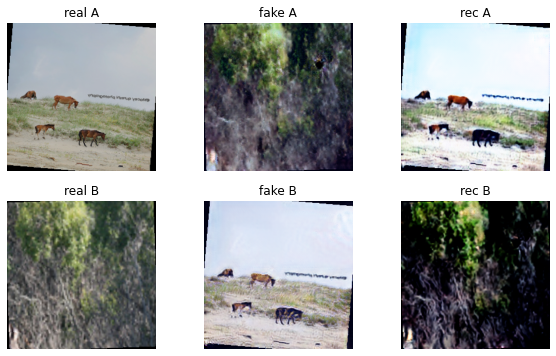

Epoch:  60%|██████    | 15/25 [4:34:16<3:02:59, 1097.92s/it]

Epoch:  64%|██████▍   | 16/25 [4:52:32<2:44:37, 1097.51s/it]

Epoch:  68%|██████▊   | 17/25 [5:10:49<2:26:18, 1097.28s/it]

Epoch:  72%|███████▏  | 18/25 [5:29:06<2:08:01, 1097.39s/it]

Epoch:  76%|███████▌  | 19/25 [5:47:23<1:49:43, 1097.20s/it]

Epoch:  76%|███████▌  | 19/25 [6:05:33<1:49:43, 1097.20s/it]



Generator metrics:
ganloss_gen_A: 0.9074716190
ganloss_gen_B: 0.9091129309
ganloss_gen_all: 1.8165845505
cycloss_gen_A: 0.4553570656
cycloss_gen_B: 0.4491361136
cycloss_gen_all: 0.9044931807
full_gen_loss: 10.8615163602

Discriminator metrics: 
ganloss_discr_A: 0.0297715832
ganloss_discr_B: 0.0329859445
ganloss_discr_all: 0.0627575277

lr: 4.8828125e-08


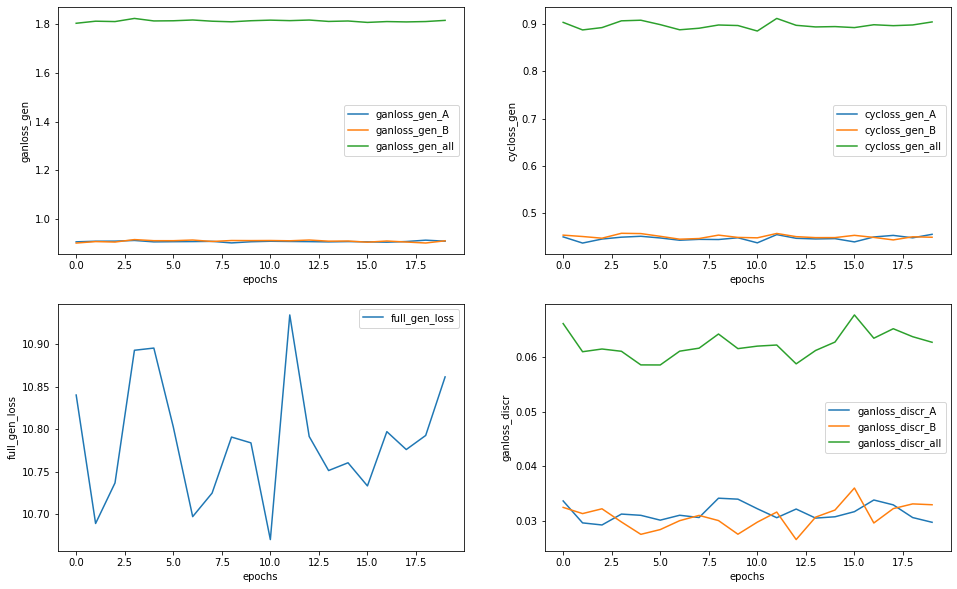

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


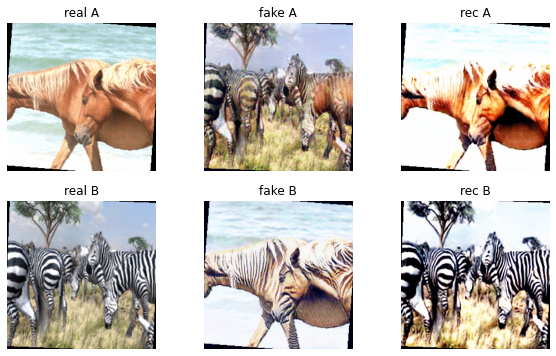

Epoch:  80%|████████  | 20/25 [6:05:43<1:31:29, 1097.82s/it]

Epoch:  84%|████████▍ | 21/25 [6:23:59<1:13:09, 1097.28s/it]

Epoch:  88%|████████▊ | 22/25 [6:42:15<54:50, 1096.96s/it]  

Epoch:  92%|█████████▏| 23/25 [7:00:31<36:33, 1096.68s/it]

Epoch:  96%|█████████▌| 24/25 [7:18:47<18:16, 1096.61s/it]

Epoch:  96%|█████████▌| 24/25 [7:36:57<18:16, 1096.61s/it]



Generator metrics:
ganloss_gen_A: 0.8998525706
ganloss_gen_B: 0.9060119775
ganloss_gen_all: 1.8058645485
cycloss_gen_A: 0.4447734656
cycloss_gen_B: 0.4578059190
cycloss_gen_all: 0.9025793864
full_gen_loss: 10.8316583887

Discriminator metrics: 
ganloss_discr_A: 0.0359414337
ganloss_discr_B: 0.0328900116
ganloss_discr_all: 0.0688314454

lr: 4.8828125e-08


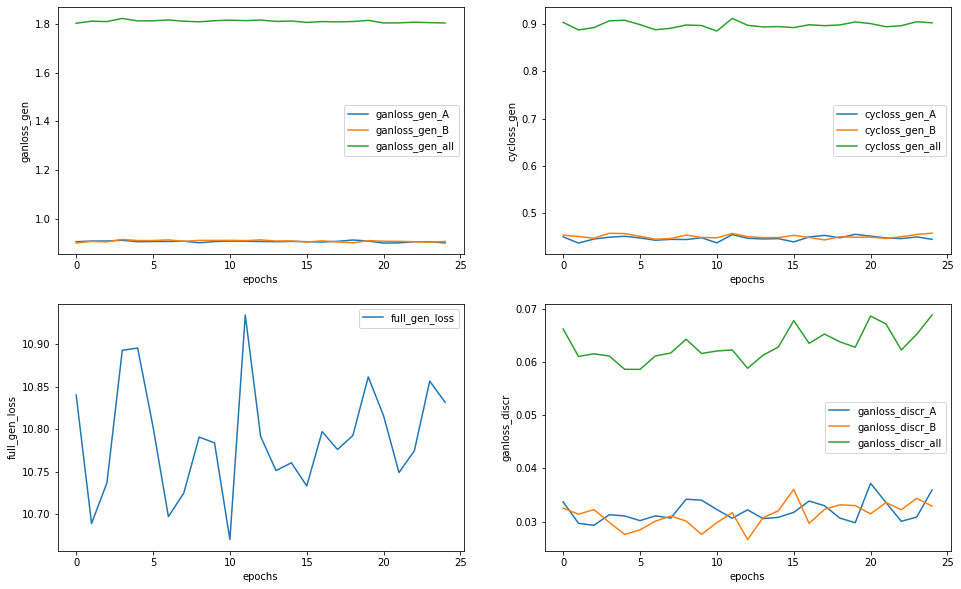

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


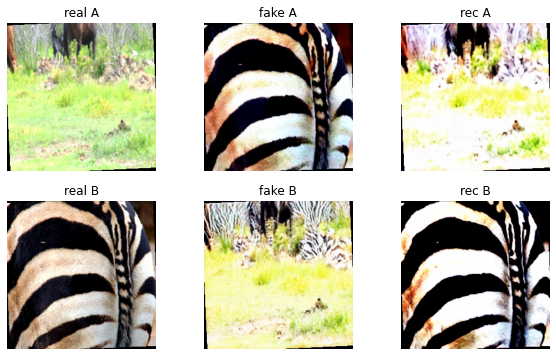

Epoch: 100%|██████████| 25/25 [7:37:07<00:00, 1097.09s/it]

In [ ]:
gan.load_weights()
gan.fit(h_trdl, z_trdl, epochs=25, lr=3.90625e-07, steps_todecay=[step for step in range(0, 25, 10)], step_plot=5)

Stage 4

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).




Eval 
Generator metrics:
ganloss_gen_A: 0.7720586437
ganloss_gen_B: 0.8682717255
ganloss_gen_all: 1.6403303649
cycloss_gen_A: 0.4761173416
cycloss_gen_B: 0.4794153689
cycloss_gen_all: 0.9555327130
full_gen_loss: 11.1956574678

Discriminator metrics: 
ganloss_discr_A: 0.2148143264
ganloss_discr_B: 0.1273994231
ganloss_discr_all: 0.3422137501


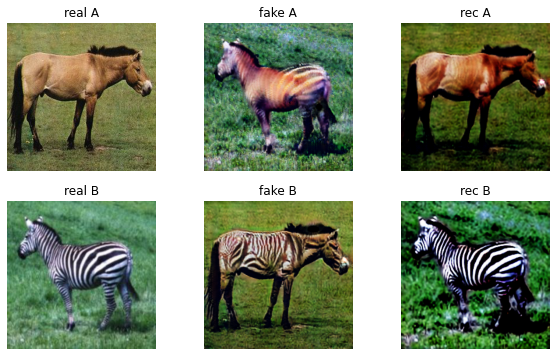

In [ ]:
gan.load_weights()
gan.eval_on_loader(h_tsdl, z_tsdl)